<a href="https://colab.research.google.com/github/riken-emar/MI-TDNMR/blob/main/RandomForest20230211.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#ランダムフォレストを可視化
#https://happy-analysis.com/python/python-topic-tree-importance.html

In [ ]:
import sys
import os
%config InlineBackend.figure_format = 'retina' # Make visualizations look good
#%config InlineBackend.figure_format = 'svg' 
%matplotlib inline

if 'google.colab' in sys.modules:
  !pip install -q dtreeviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.1/83.1 KB 3.4 MB/s eta 0:00:00


In [ ]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 575.9/575.9 KB 10.5 MB/s eta 0:00:00


In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# yyplot 作成関数
def yyplot(y_obs, y_pred):
    yvalues = np.concatenate([y_obs.flatten(), y_pred.flatten()])
    ymin, ymax, yrange = np.amin(yvalues), np.amax(yvalues), np.ptp(yvalues)
    fig = plt.figure(figsize=(8, 8))
    plt.scatter(y_obs, y_pred,
            label='RMSE : %.3f, MAE : %.3f \n RMSE/MAE = %.3f'%(mean_squared_error(y_obs, y_pred)**0.5, mean_absolute_error(y_obs, y_pred),
                mean_squared_error(y_obs, y_pred)**0.5 / mean_absolute_error(y_obs, y_pred)))
    plt.plot([ymin - yrange * 0.01, ymax + yrange * 0.01], [ymin - yrange * 0.01, ymax + yrange * 0.01])
    plt.xlim(ymin - yrange * 0.01, ymax + yrange * 0.01)
    plt.ylim(ymin - yrange * 0.01, ymax + yrange * 0.01)
    plt.xlabel('y_observed', fontsize=24)
    plt.ylabel('y_predicted', fontsize=24)
    plt.title('Observed-Predicted Plot', fontsize=24)
    plt.tick_params(labelsize=16)
    plt.legend(fontsize=12, loc='upper left')
    plt.savefig("yyplot_"+os.path.basename(file).split(".", 1)[0]+".png", bbox_inches='tight')
    plt.show()

    return fig

import numpy as np
import matplotlib.pyplot as plt

def plot_sorted_bar(figsize: tuple, x: np.array, y: np.array, title: str = None) -> None:
    """
    入力値を降順ソートして棒グラフを作成するメソッド。

    Parameters
    ----------
    figsize : tuple
        figsizeのtuple。
    x : np.numpy
        横軸(ラベル)。
    y : np.numpy
        縦軸(数値)。
    title : str
        グラフタイトル文字列。

    """
    # yを昇順ソート後、逆順にindexを取得
    sorted_index = np.argsort(y)[:]
    # 棒グラフの可視化
    plt.figure(figsize=figsize)
    plt.barh(
        #ラベルが数値だと自動ソートされるため、x軸は文字列型にしておく
        x[sorted_index].astype('str'),
        np.sort(y)[:]
    )
    plt.ylabel('Features',fontsize=18)
    plt.xlabel('Importance',fontsize=18)
    if title is not None:
        plt.title(title)
    plt.savefig("Importance_"+os.path.basename(file).split('.', 1)[0]+".png", bbox_inches='tight')

def remove_any_zero_row(df):
    """一つでも0の行を削除"""
    df = df.copy()
    for row in df.index:
        if (df.loc[row] == 0).any():
            df.drop(row, axis=0, inplace=True)
    return df

./data/oligomer_RF_20230213pyTereph.csv
oligomer_RF_20230213pyTereph
Best params: {'max_depth': 25, 'max_features': None, 'n_estimators': 5}
Best Score: 0.7144349205000966
0.6291479697866564
0.03141012838666413
RMSE 学習: 0.03, テスト: 0.03
R^2 学習: 0.63, テスト: 0.03


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


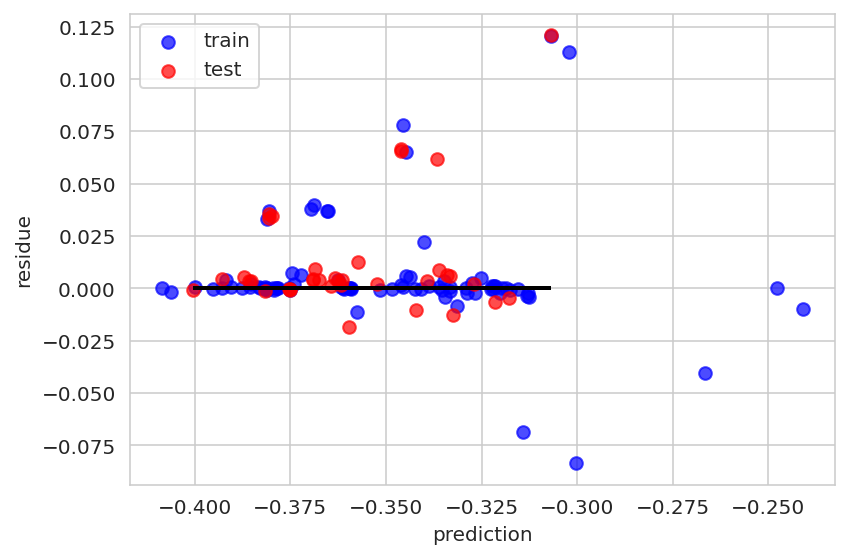

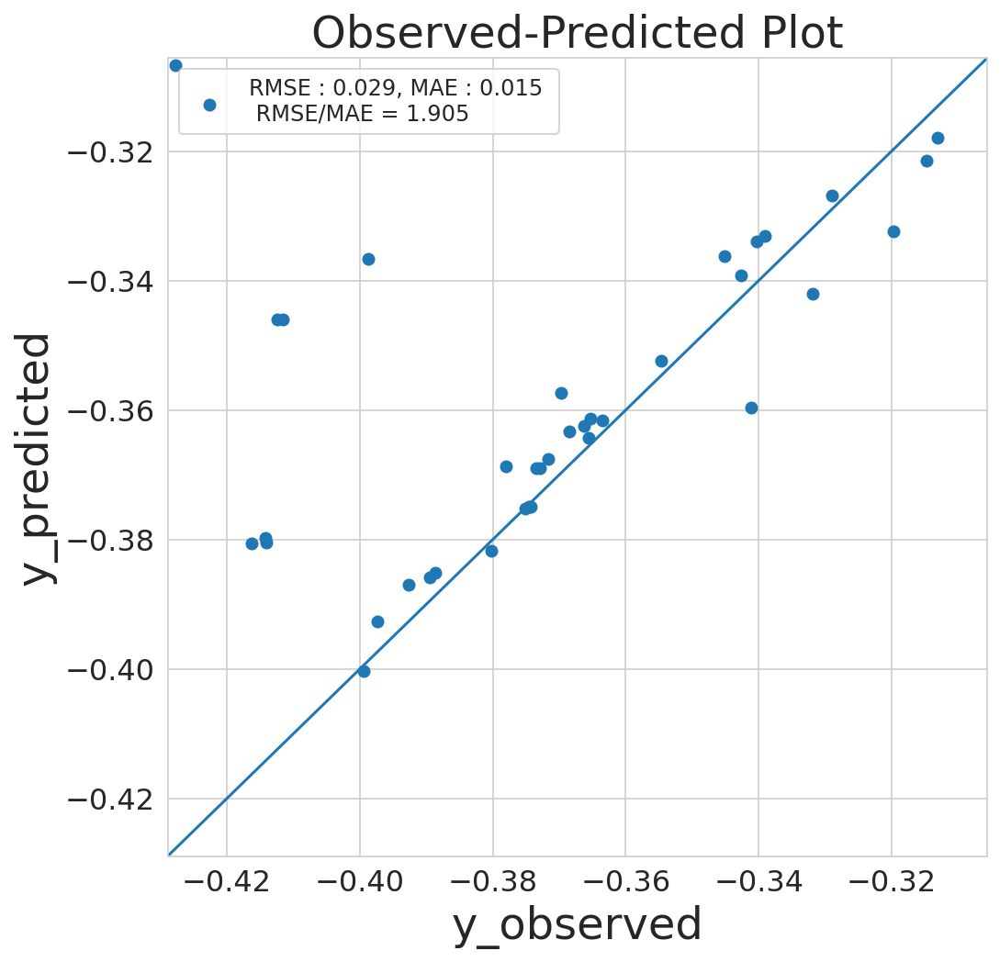

before
                                x         y
0                    CPMGOriginal  0.003574
1              CPMGOriginalT2[ms]  0.150905
2            CPMGFreeWater[SSNMF]  0.107449
3           CPMGBoundWater[SSNMF]  0.001432
4   CPMGStronglyBoundWater[SSNMF]  0.119494
5                    FreeWater[%]  0.003959
6                   BoundWater[%]  0.001342
7           StronglyBoundWater[%]  0.000082
8                     Strongly[%]  0.072166
9                             MSE  0.000892
10                             DQ  0.132627
11                           MAPE  0.000599
12                        DQ/MAPE  0.107484
13              MSEComp1[MCR-ALS]  0.006327
14              MSEComp2[MCR-ALS]  0.001557
15              MSEComp3[MCR-ALS]  0.001228
16              MSEComp4[MCR-ALS]  0.004981
17               DQComp1[MCR-ALS]  0.085469
18               DQComp2[MCR-ALS]  0.015979
19               DQComp3[MCR-ALS]  0.008122
20               DQComp4[MCR-ALS]  0.089950
21             MAPEComp1[

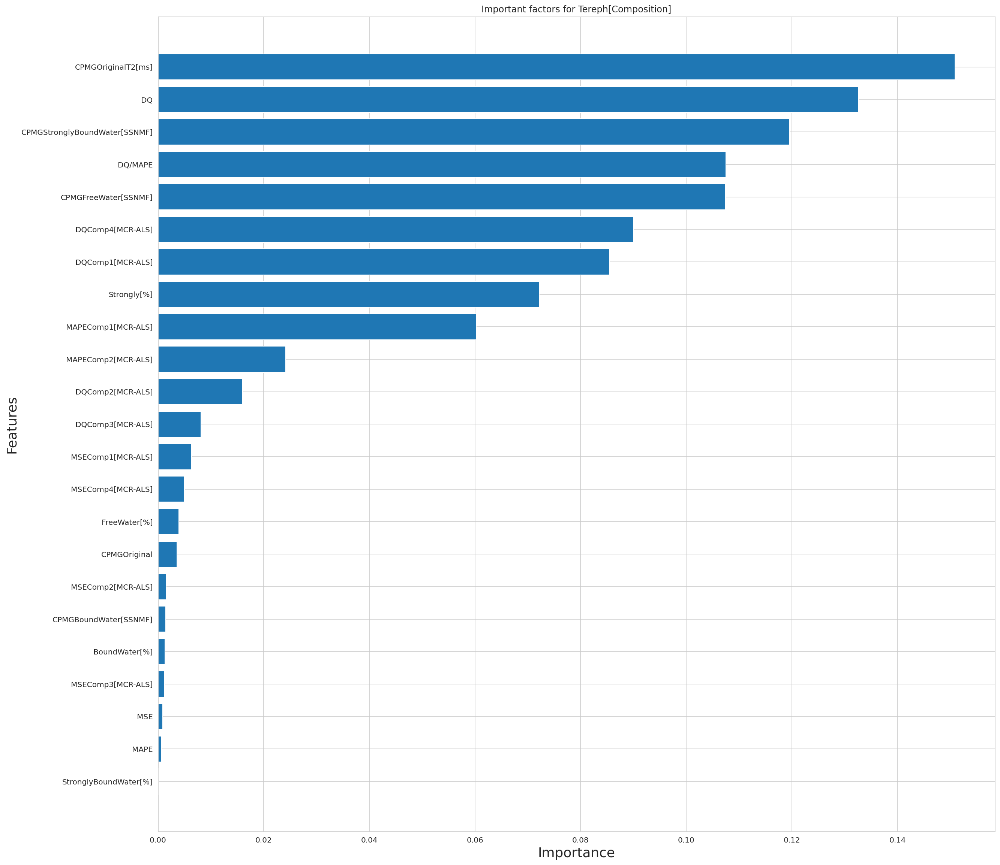

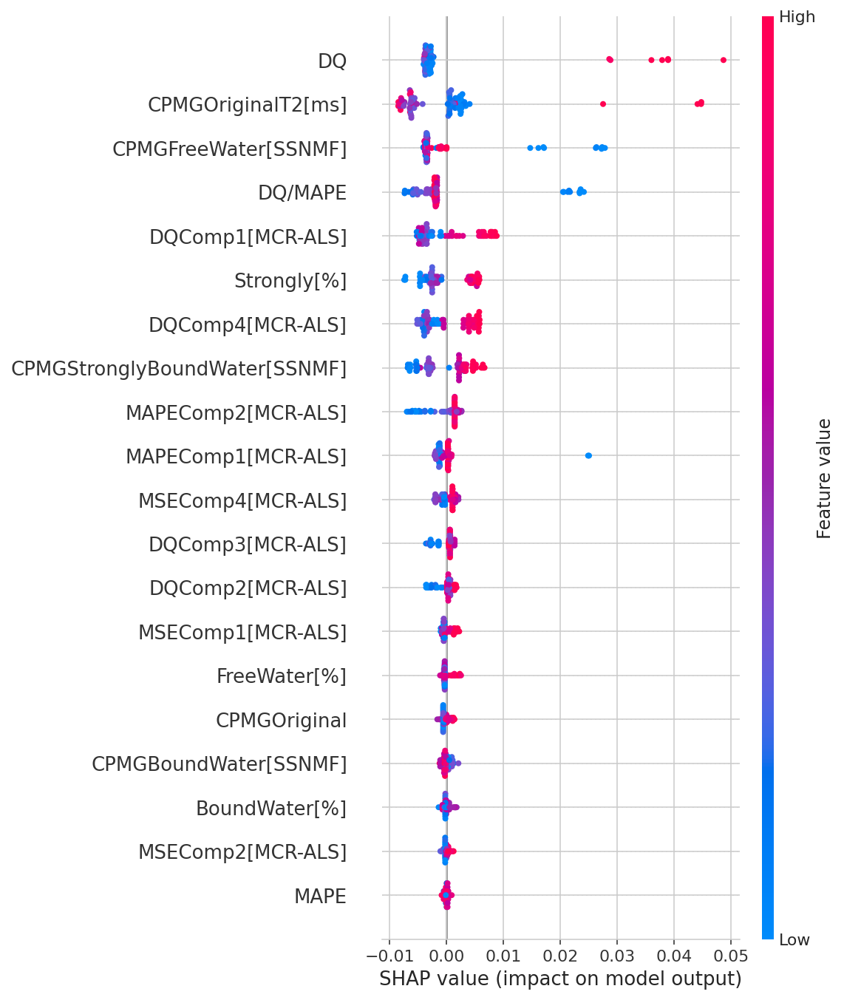

./data/oligomer_RF_20230213pyAdA.csv
oligomer_RF_20230213pyAdA
Best params: {'max_depth': 5, 'max_features': None, 'n_estimators': 30}
Best Score: 0.9131389193632661
0.9858122717274798
0.8524006553897041
RMSE 学習: 0.00, テスト: 0.01
R^2 学習: 0.99, テスト: 0.85


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


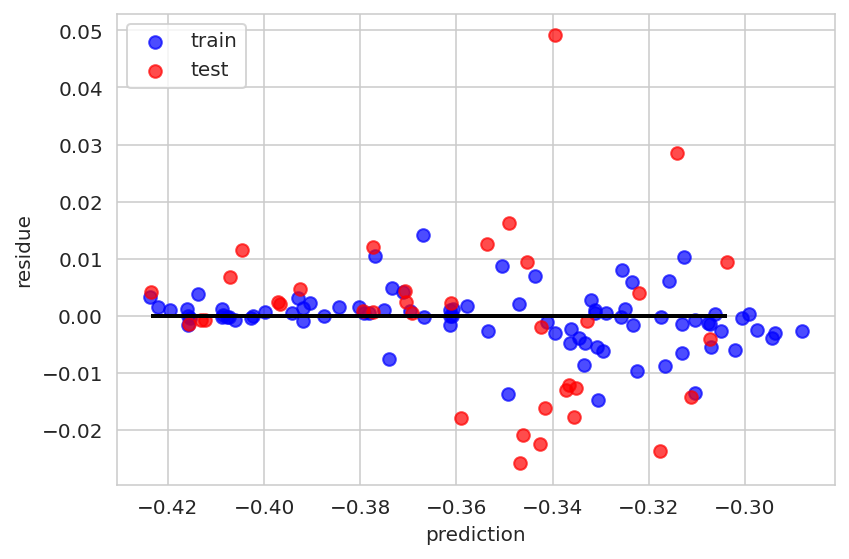

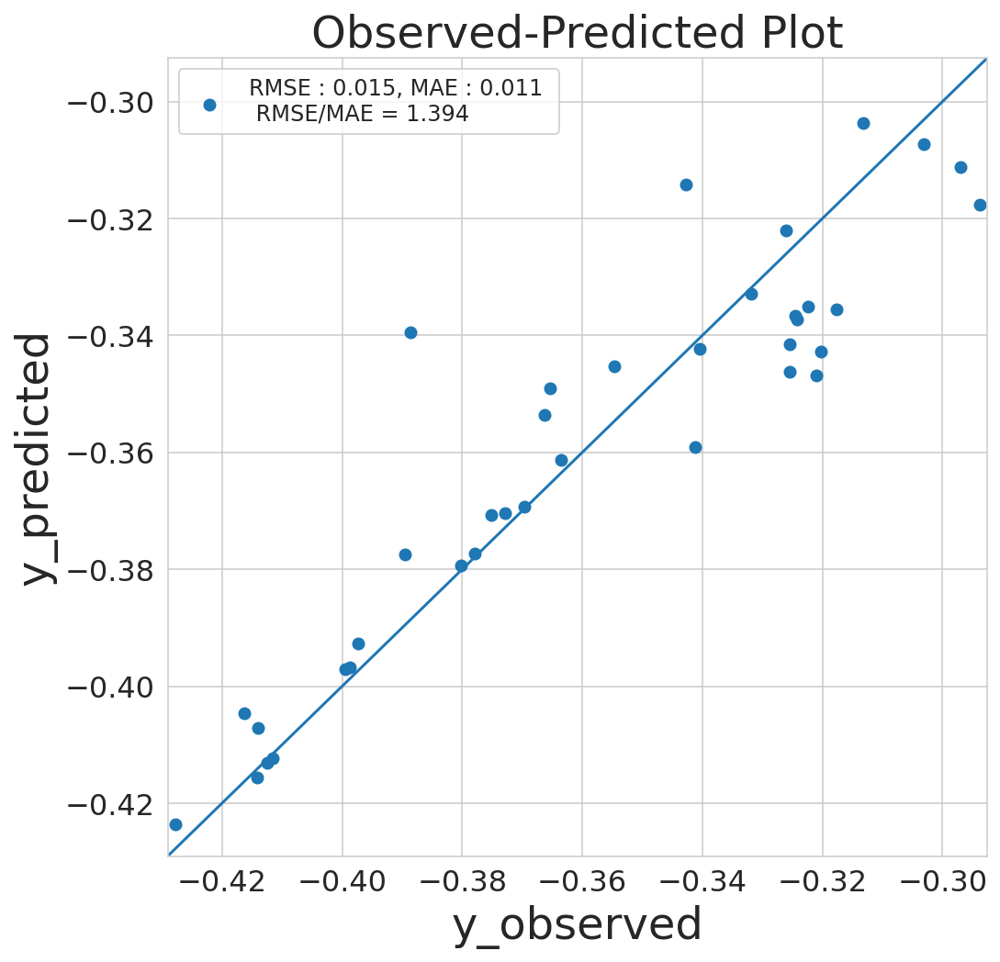

before
                                x         y
0                    CPMGOriginal  0.010234
1              CPMGOriginalT2[ms]  0.055215
2            CPMGFreeWater[SSNMF]  0.004329
3           CPMGBoundWater[SSNMF]  0.007167
4   CPMGStronglyBoundWater[SSNMF]  0.015662
5                    FreeWater[%]  0.029623
6                   BoundWater[%]  0.008641
7           StronglyBoundWater[%]  0.004361
8                     Strongly[%]  0.010535
9                             MSE  0.001933
10                             DQ  0.149799
11                           MAPE  0.486986
12                        DQ/MAPE  0.015951
13              MSEComp1[MCR-ALS]  0.012069
14              MSEComp2[MCR-ALS]  0.012265
15              MSEComp3[MCR-ALS]  0.012966
16              MSEComp4[MCR-ALS]  0.034500
17               DQComp1[MCR-ALS]  0.006939
18               DQComp2[MCR-ALS]  0.006566
19               DQComp3[MCR-ALS]  0.015438
20               DQComp4[MCR-ALS]  0.027116
21             MAPEComp1[

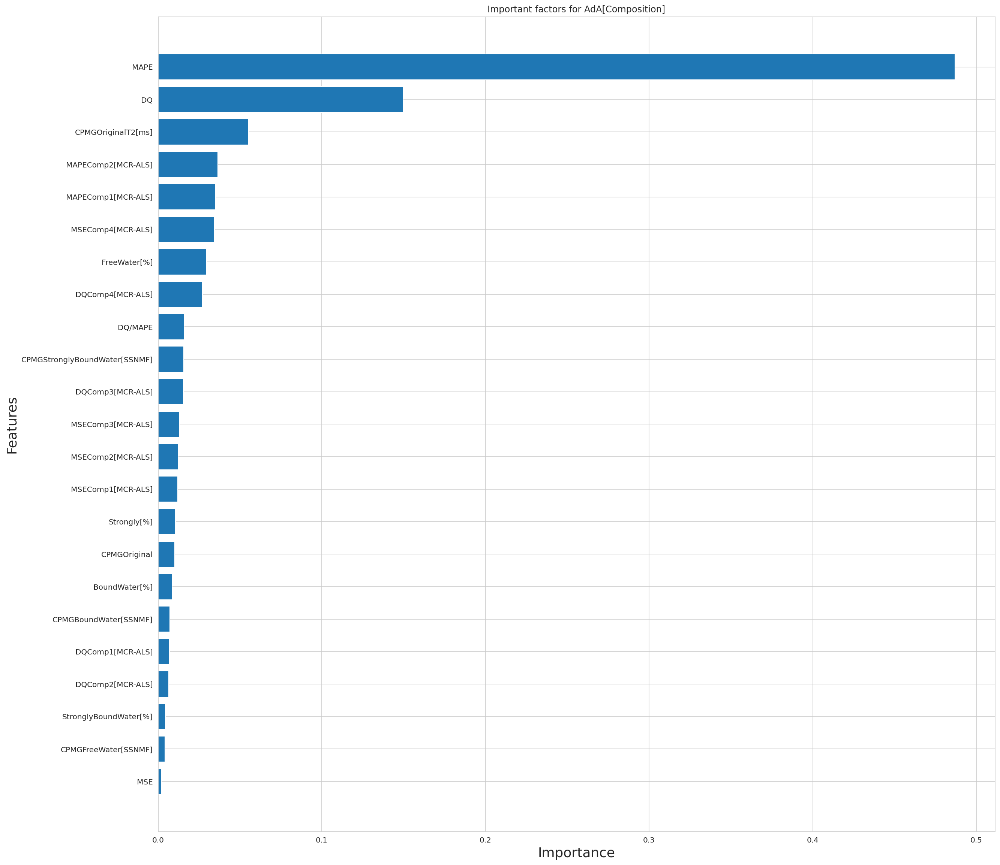

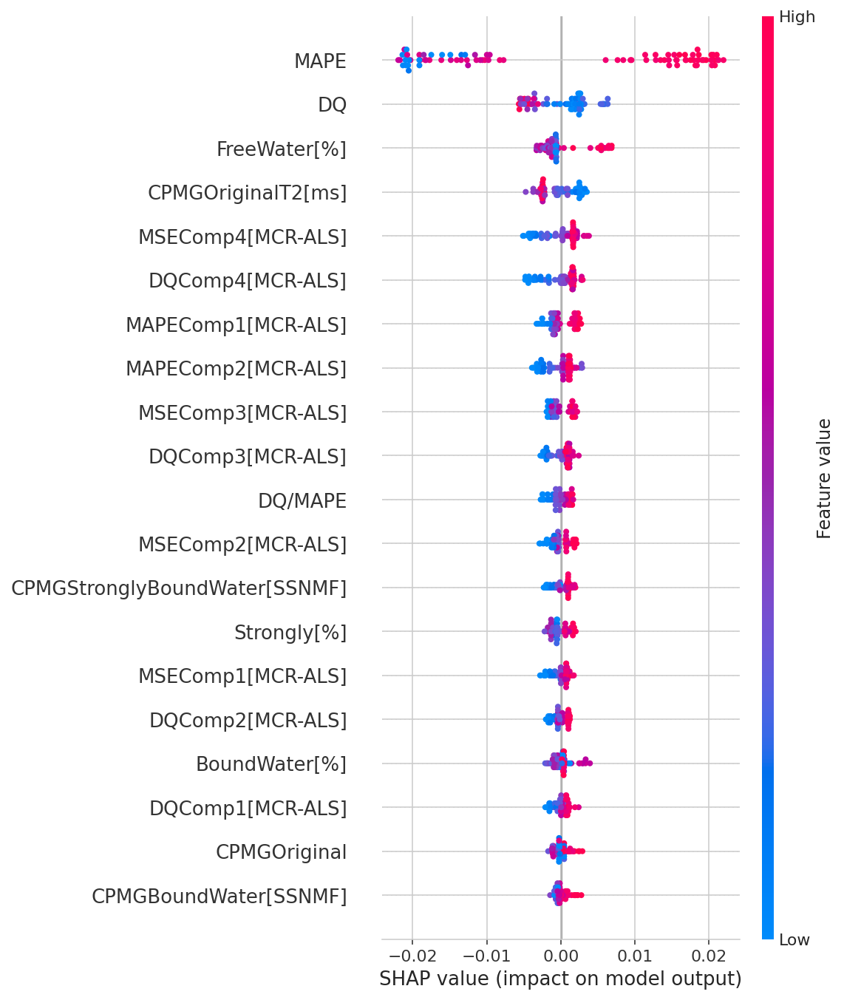

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import os
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn import metrics
import scipy.stats

sns.set_style('whitegrid',{'linestyle.grid':'--'})
%matplotlib inline

import glob
files = glob.glob("./data/*")
for file in files:
    print(file)
    print(os.path.basename(file).split('.', 1)[0])
    from scipy import stats
    df = pd.read_csv(file, index_col=0)
    df = df.apply(stats.zscore, axis=1)

    # 説明変数と目的変数
    X=df.iloc[:,1:]#data.data
    y=df.iloc[:,0]#data.target

    # 訓練データ(train)と検証データ(test)にわける 
    X_train,X_test,y_train,y_test=train_test_split(X.values,y.values,test_size=0.3,random_state=1)

    from sklearn.ensemble        import RandomForestClassifier
    from sklearn.model_selection import GridSearchCV
    from sklearn.model_selection import train_test_split

    # 学習データ＆テストデータ分割
    #X_train, X_test,  Y_train, Y_test = train_test_split(dataset[features_reg],dataset[target_reg],test_size=0.3, random_state=3)

    # グリッドサーチによるハイパーパラメータ探索候補設定
    # 今回はRandomForestClassifierのパラメータが対象(値は任意に設定)
    parameters = {  
        'n_estimators': [3,5,10, 20, 30, 50, 100],     # 用意する決定木モデルの数
        'max_features': ('sqrt', 'log2','auto', None),  # ランダムに指定する特徴量の数
        'max_depth':    (3,5,10,15,25,30,40,50,100, None),     # 決定木のノード深さの制限値
    }

    # モデルインスタンス
    model = RandomForestRegressor()#RandomForestClassifier()

    # ハイパーパラメータチューニング(グリッドサーチのコンストラクタにモデルと辞書パラメータを指定)
    gridsearch = GridSearchCV(estimator = model,        # モデル
                              param_grid = parameters,  # チューニングするハイパーパラメータ
                              scoring = "r2"      # スコアリング
                            )


    # 演算実行
    gridsearch.fit(X_train, y_train)

    # グリッドサーチの結果から得られた最適なパラメータ候補を確認
    print('Best params: {}'.format(gridsearch.best_params_)) 
    print('Best Score: {}'.format(gridsearch.best_score_))

    clf = RandomForestRegressor(n_estimators = gridsearch.best_params_['n_estimators'], # 用意する決定木モデルの数
                                  max_features = gridsearch.best_params_['max_features'], # ランダムに指定する特徴量の数
                                  max_depth    = gridsearch.best_params_['max_depth'],    # 決定木のノード深さの制限値
                                  criterion='mse',                                       # 不純度評価指標の種類(ジニ係数）
                                  min_samples_leaf = 1,                                   # 1ノードの深さの最小値
                                  random_state = 0,                                       # 乱数シード
                                  )


    # モデルの作成
    #clf = DecisionTreeClassifier(max_depth=3) 
    #from sklearn.tree import DecisionTreeRegressor
    #clf = DecisionTreeRegressor(random_state=0) 
    # モデルの学習
    clf.fit(X_train, y_train)
    

    # 評価
    print(clf.score(X_train,y_train))
    print(clf.score(X_test,y_test))
    
    from sklearn.metrics import r2_score            # 決定係数
    from sklearn.metrics import mean_squared_error  # RMSE

    # 予測値(Train）
    y_train_pred = clf.predict(X_train)

    # 予測値（Test)
    y_test_pred = clf.predict(X_test)

    # 平均平方二乗誤差(RMSE)
    print('RMSE 学習: %.2f, テスト: %.2f' % (
            mean_squared_error(y_train, y_train_pred, squared=False), # 学習
            mean_squared_error(y_test, y_test_pred, squared=False)    # テスト
          ))

    # 決定係数(R^2)
    print('R^2 学習: %.2f, テスト: %.2f' % (
            r2_score(y_train, y_train_pred), # 学習
            r2_score(y_test, y_test_pred)    # テスト
          ))
    
    # 予測値と残差をプロット（学習データ）
    plt.scatter(y_train_pred,             # グラフのx値(予測値)  
                y_train_pred - y_train,   # グラフのy値(予測値と学習値の差)
                c='blue',                 # プロットの色
                marker='o',               # マーカーの種類
                s=40,                     # マーカーサイズ
                alpha=0.7,                # 透明度
                label='train')         # ラベルの文字


    # 予測値と残差をプロット（テストデータ）
    plt.scatter(y_test_pred,            
                y_test_pred - y_test, 
                c='red',
                marker='o', 
                s=40,
                alpha=0.7,
                label='test')

    # グラフの書式設定
    plt.xlabel('prediction')
    plt.ylabel('residue')
    plt.legend(loc='upper left')
    plt.hlines(y=0, xmin=np.amin(y_test_pred), xmax=np.amax(y_test_pred), lw=2, color='black')
    #plt.hlines(y=0, xmin=-20, xmax=60, lw=2, color='black')
    #plt.xlim([-20, 60])
    #plt.ylim([-50, 40])
    plt.tight_layout()
    plt.savefig("residue_"+os.path.basename(file).split('.', 1)[0]+".png", bbox_inches='tight')
    plt.show()

    # yyplot の実行例
    np.random.seed(0)
    y_obs = y_test#np.random.normal(size=(1000, 1))
    y_pred = y_test_pred#y_obs + np.random.normal(scale=0.3, size=(1000, 1))
    fig = yyplot(y_obs, y_pred)

    x = df.columns[1:] #特徴量名 ->['sepal length (cm)','sepal width (cm)','petal length (cm)','petal width (cm)']
    y = clf.feature_importances_ #特徴量の重要度
    df0 = pd.DataFrame({'x':x,'y':y})
    print('before')
    print(df0)

    df0 = remove_any_zero_row(df0)

    print('after')
    print(df0)
    df0.to_csv("Importance_"+os.path.basename(file).split('.', 1)[0]+".csv")
    # 可視化
    plot_sorted_bar(
        figsize=(20, 20),
        x=df0["x"].values, 
        y=df0["y"].values,
        title='Important factors for '+df.columns[0]
    )

    plt.show()
    import shap
    explainer = shap.TreeExplainer(clf, data=X_train)
    X_train_shap_values = explainer.shap_values(X_train)
    shap.summary_plot(shap_values=X_train_shap_values,
                  features=X_train,
                  show=False,
                  feature_names=df.columns[1:])
    plt.savefig("shap_"+os.path.basename(file).split('.', 1)[0]+".png", bbox_inches='tight') # 画像を保存
    plt.show()
    """
    import graphviz
    from sklearn.tree import export_graphviz
    from sklearn import tree
    dot = tree.export_graphviz(clf.estimators_[0], filled=True, rounded=True, 
                          #class_names=['setosa', 'versicolor', 'virginica'],
                          feature_names=df.columns[1:],
                          out_file=None) 

    graph = graphviz.Source(dot) #DOT記法をレンダリング
    #graph #グラフを出力
    # 画像を保存
    # 拡張子はいらない
    graph.render("Tree_"+os.path.basename(file).split('.', 1)[0])

    # 画像を表示
    graph.view()
    #features_reg = ["Pclass", "Fare", "Sex_label", "Cabin_label", "Embarked_label", "Survived"]
    #target_reg = "Age"

    #tree_regressor = DecisionTreeRegressor(max_depth=3, random_state=random_state, criterion="absolute_error")
    #tree_regressor.fit(dataset[features_reg].values, dataset[target_reg].values)
    import dtreeviz
    viz_rmodel = dtreeviz.model(model=clf.estimators_[0], 
                                X_train=df.iloc[:,1:], 
                                y_train=df.iloc[:,0], 
                                feature_names=df.columns[1:], 
                                target_name=df.columns[0])
    viz_rmodel.view(orientation="LR")
    """

In [ ]:
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 KB 6.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=26ee4c53e019d2c9a813a0abaeeb7abc7115d5b0de9a041e190deca3bcdd9fe6
  Stored in directory: /root/.cache/pip/wheels/e6/a6/20/cc1e293fcdb67ede666fed293cb895395e7ecceb4467779546
Successfully built lime


./data/oligomer_RF_20230213pyStronglyBoundWater.csv
oligomer_RF_20230213pyStronglyBoundWater
Best params: {'max_depth': 30, 'max_features': None, 'n_estimators': 100}
Best Score: 0.9917670908140741


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


0.9988409388655161
0.9941173120161946
RMSE 学習: 0.00, テスト: 0.00
R^2 学習: 1.00, テスト: 0.99


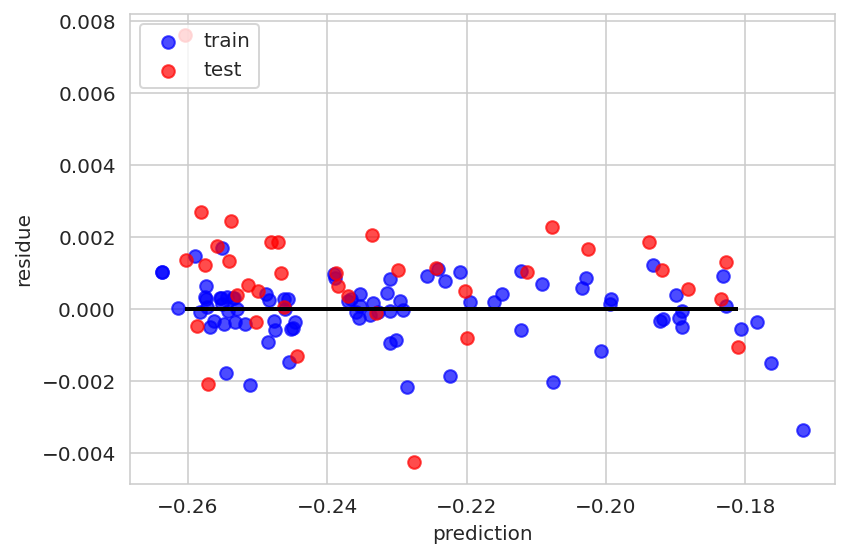

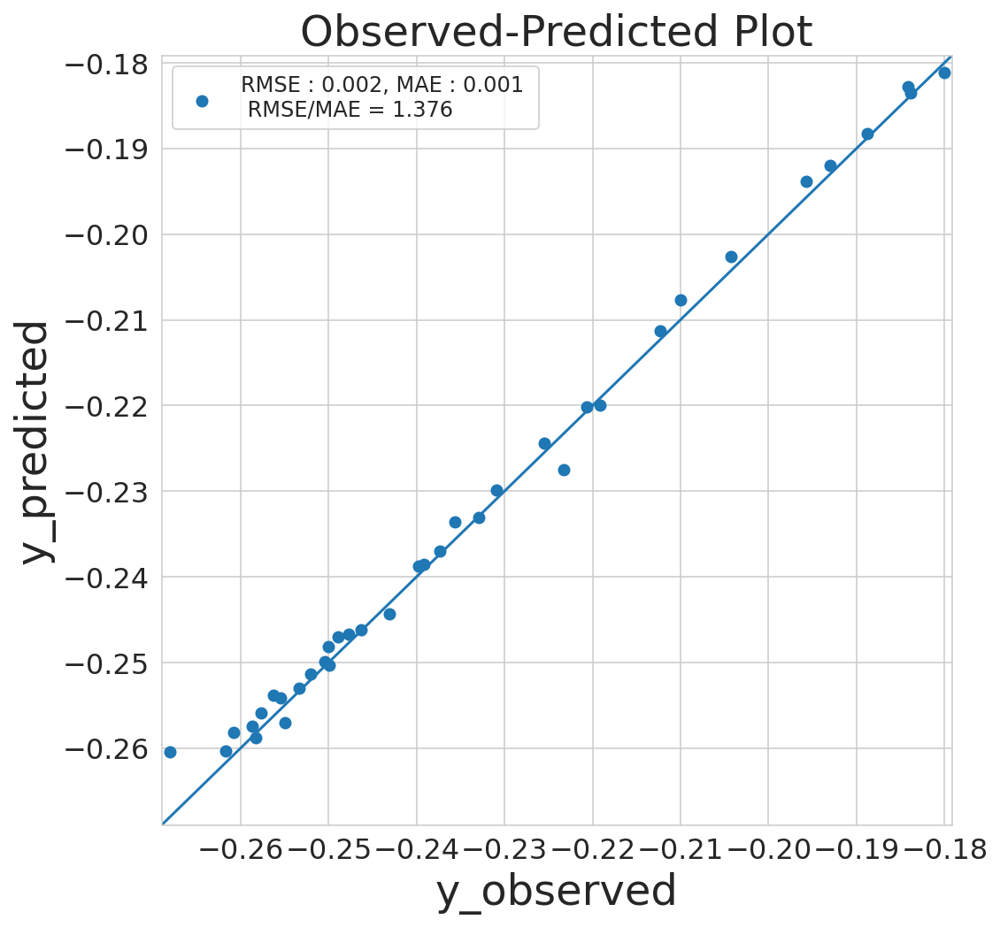

before
                          x         y
0                       MSE  0.029107
1                        DQ  0.000251
2                      MAPE  0.000501
3                   DQ/MAPE  0.009732
4         MSEComp1[MCR-ALS]  0.011537
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.019530
60        fr_benzene[RDKit]  0.010675
61       fr_bicyclic[RDKit]  0.010280
62          fr_ether[RDKit]  0.011569
63  fr_unbrch_alkane[RDKit]  0.025055

[64 rows x 2 columns]
after
                          x         y
0                       MSE  0.029107
1                        DQ  0.000251
2                      MAPE  0.000501
3                   DQ/MAPE  0.009732
4         MSEComp1[MCR-ALS]  0.011537
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.019530
60        fr_benzene[RDKit]  0.010675
61       fr_bicyclic[RDKit]  0.010280
62          fr_ether[RDKit]  0.011569
63  fr_unbrch_alkane[RDKit]  0.025055

[64 rows x 2 columns]


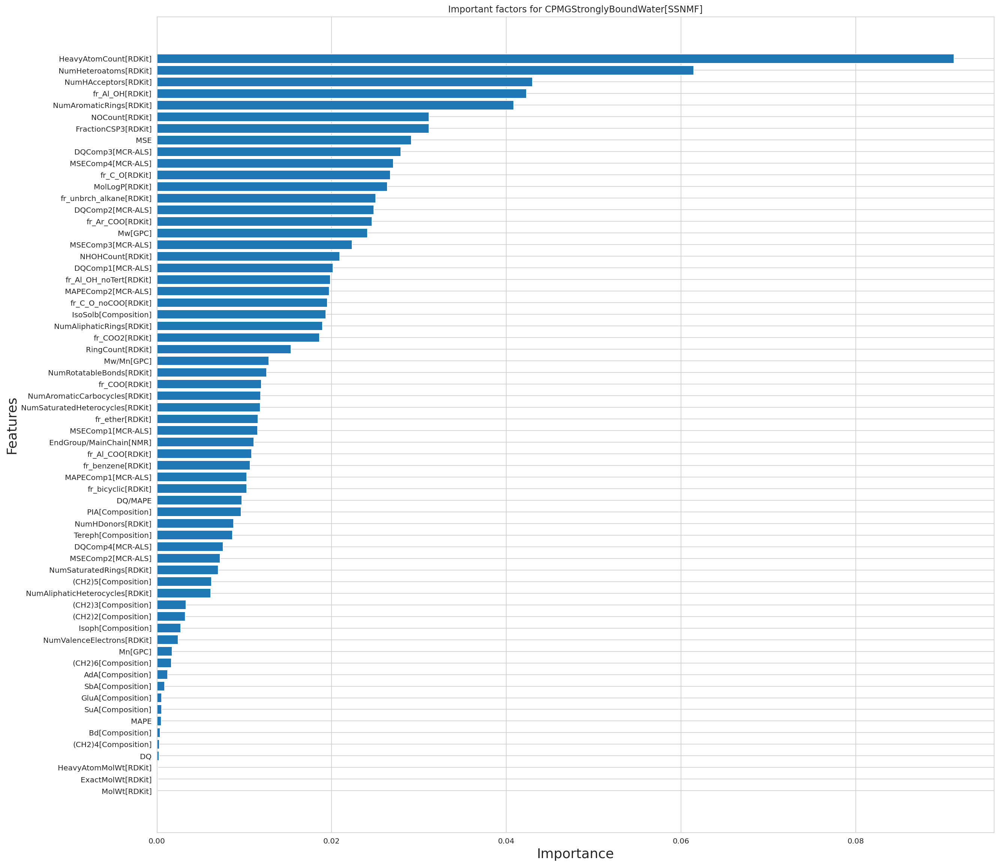

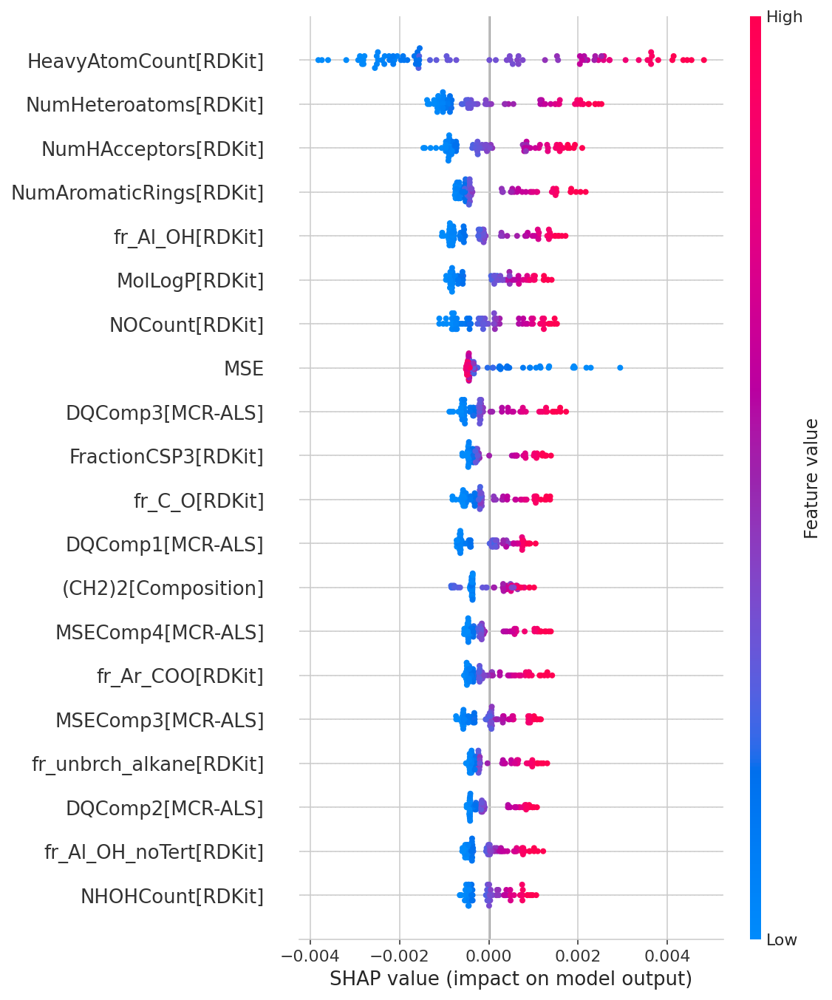

./data/oligomer_RF_20230213pyTereph.csv
oligomer_RF_20230213pyTereph
Best params: {'max_depth': 5, 'max_features': 'auto', 'n_estimators': 5}
Best Score: 0.713005667503052
0.6275440326547911
0.03937187838269407
RMSE 学習: 0.03, テスト: 0.03
R^2 学習: 0.63, テスト: 0.04


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


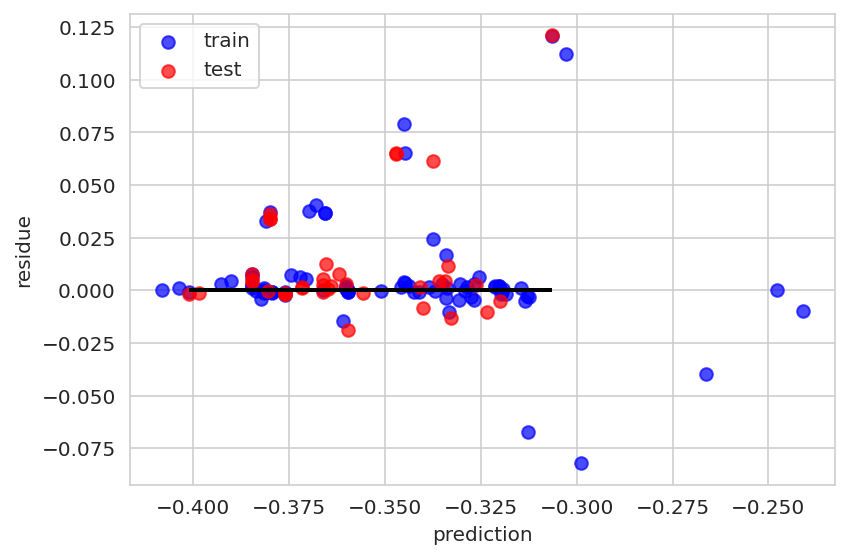

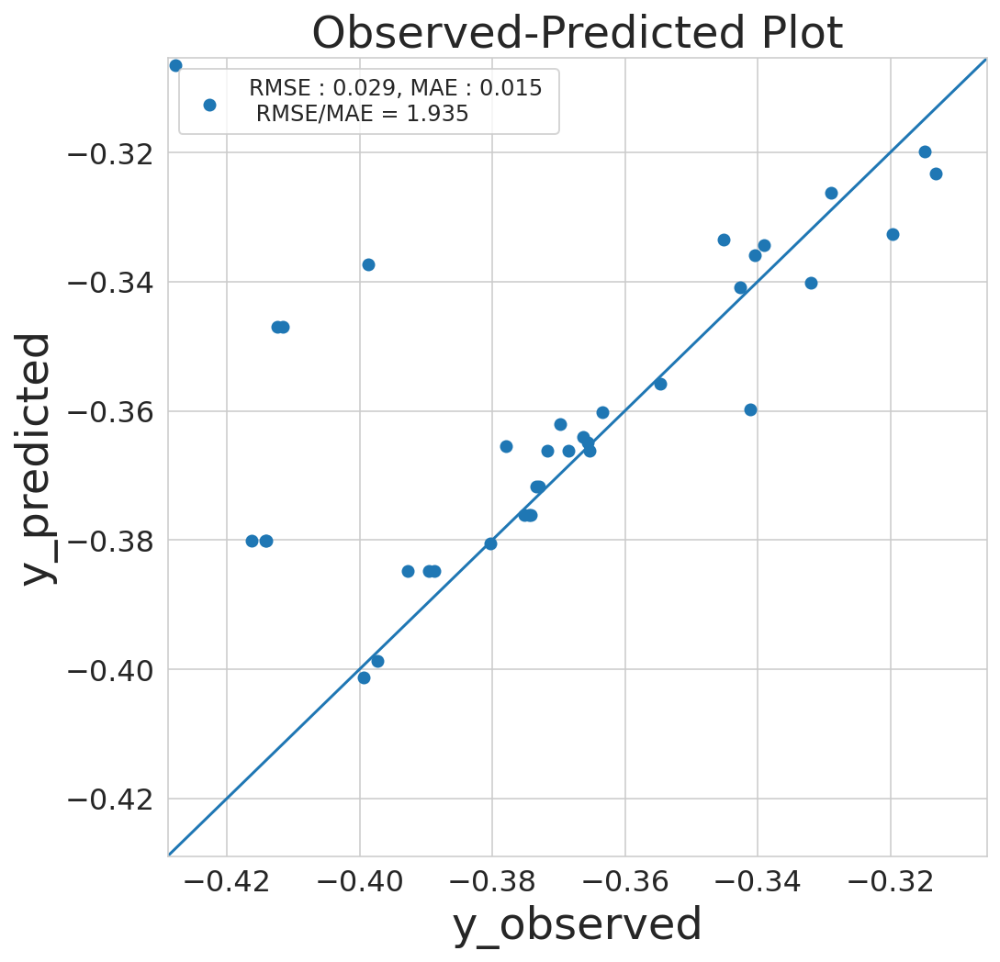

before
                                x         y
0                    CPMGOriginal  0.000018
1              CPMGOriginalT2[ms]  0.153727
2            CPMGFreeWater[SSNMF]  0.105795
3           CPMGBoundWater[SSNMF]  0.003760
4   CPMGStronglyBoundWater[SSNMF]  0.119677
5                    FreeWater[%]  0.004118
6                   BoundWater[%]  0.001254
7           StronglyBoundWater[%]  0.000439
8                     Strongly[%]  0.072034
9                             MSE  0.001751
10                             DQ  0.133030
11                           MAPE  0.000455
12                        DQ/MAPE  0.122366
13              MSEComp1[MCR-ALS]  0.003276
14              MSEComp2[MCR-ALS]  0.000931
15              MSEComp3[MCR-ALS]  0.058786
16              MSEComp4[MCR-ALS]  0.001117
17               DQComp1[MCR-ALS]  0.085711
18               DQComp2[MCR-ALS]  0.006386
19               DQComp3[MCR-ALS]  0.008934
20               DQComp4[MCR-ALS]  0.092013
21             MAPEComp1[

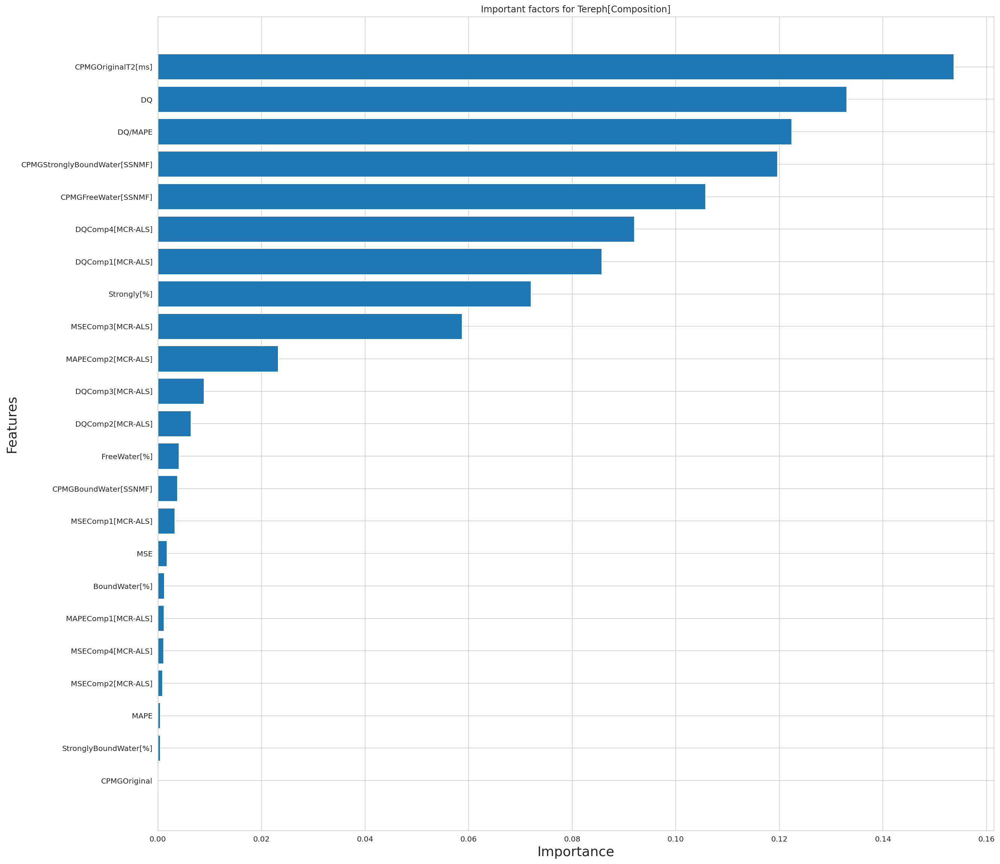

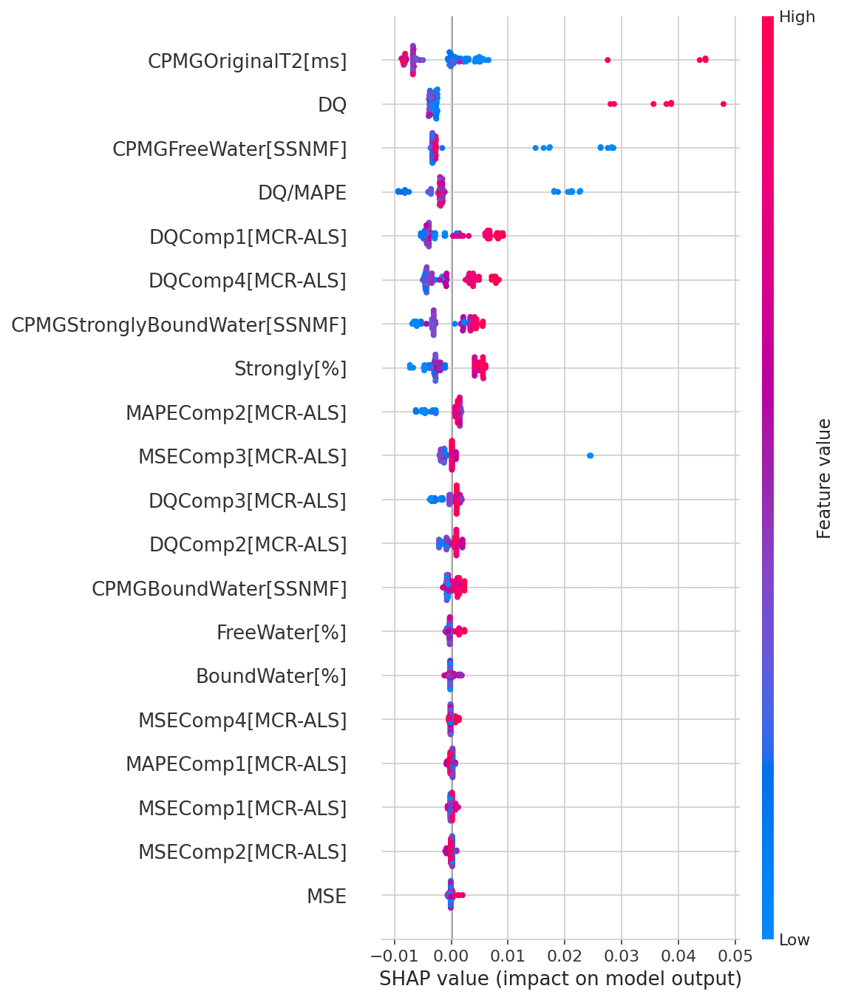

./data/oligomer_RF_20230213pyOriginalT2.csv
oligomer_RF_20230213pyOriginalT2
Best params: {'max_depth': 10, 'max_features': 'log2', 'n_estimators': 10}
Best Score: 0.6362991217247609
0.9233963325322311
0.6330799933958391
RMSE 学習: 0.17, テスト: 0.33
R^2 学習: 0.92, テスト: 0.63


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


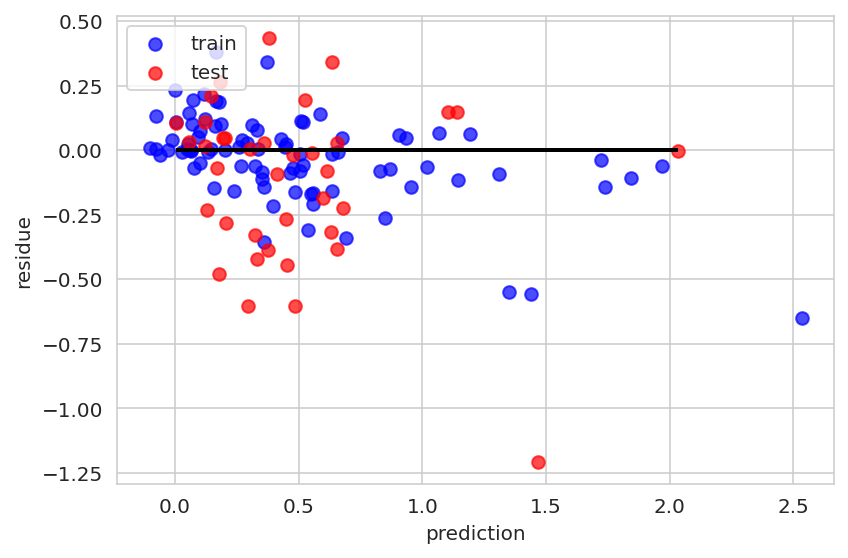

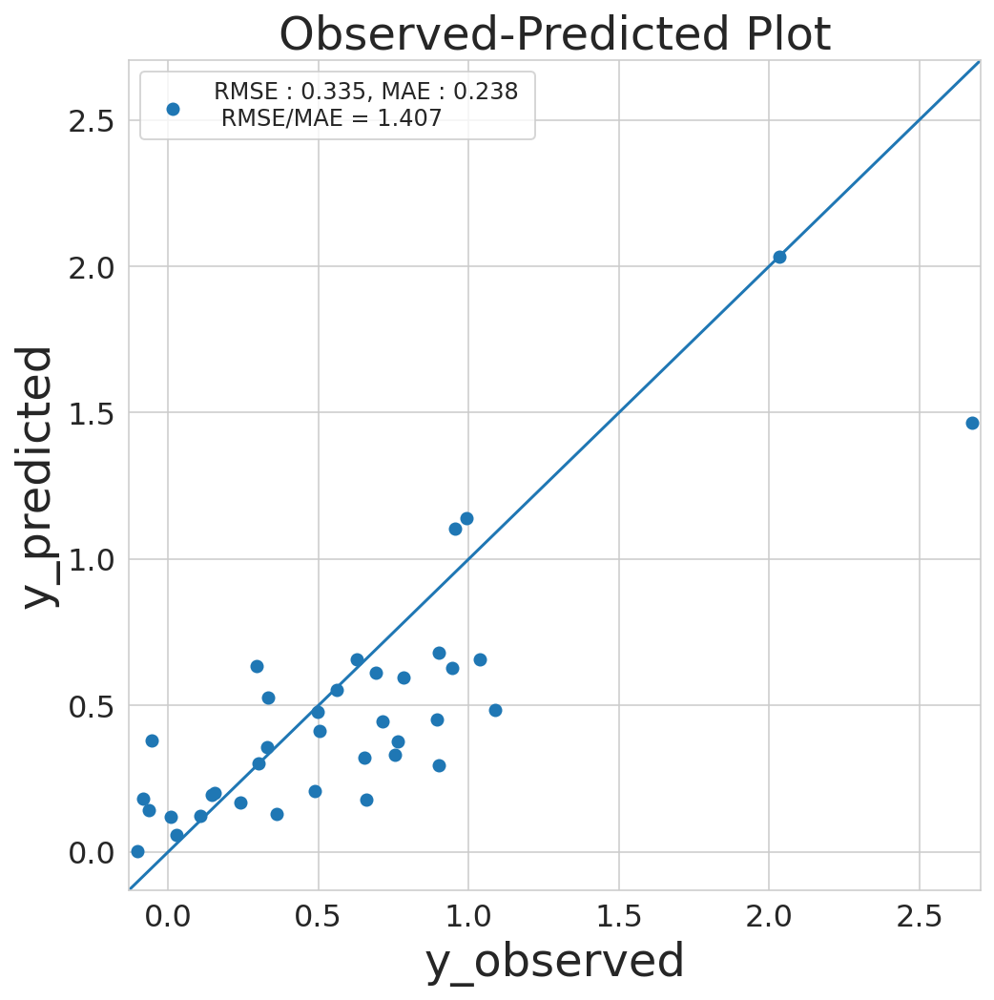

before
                          x         y
0                       MSE  0.009456
1                        DQ  0.086104
2                      MAPE  0.004308
3                   DQ/MAPE  0.001019
4         MSEComp1[MCR-ALS]  0.002830
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.003746
60        fr_benzene[RDKit]  0.016453
61       fr_bicyclic[RDKit]  0.005485
62          fr_ether[RDKit]  0.000995
63  fr_unbrch_alkane[RDKit]  0.005951

[64 rows x 2 columns]
after
                          x         y
0                       MSE  0.009456
1                        DQ  0.086104
2                      MAPE  0.004308
3                   DQ/MAPE  0.001019
4         MSEComp1[MCR-ALS]  0.002830
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.003746
60        fr_benzene[RDKit]  0.016453
61       fr_bicyclic[RDKit]  0.005485
62          fr_ether[RDKit]  0.000995
63  fr_unbrch_alkane[RDKit]  0.005951

[64 rows x 2 columns]


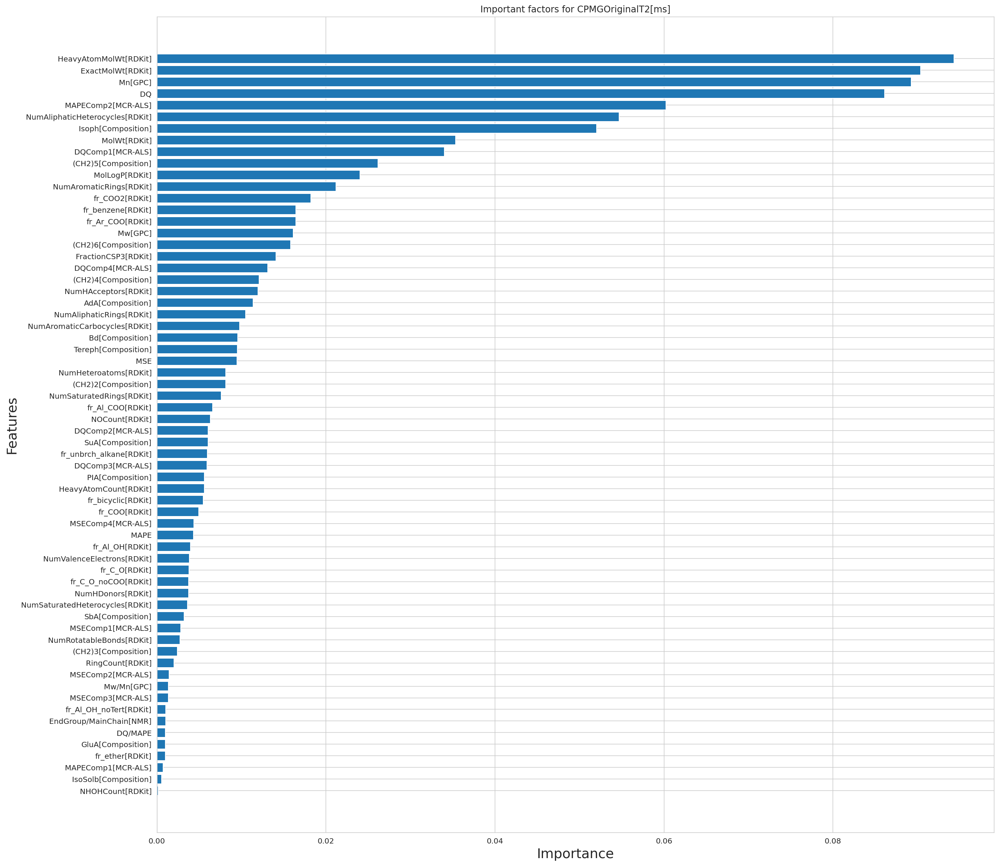

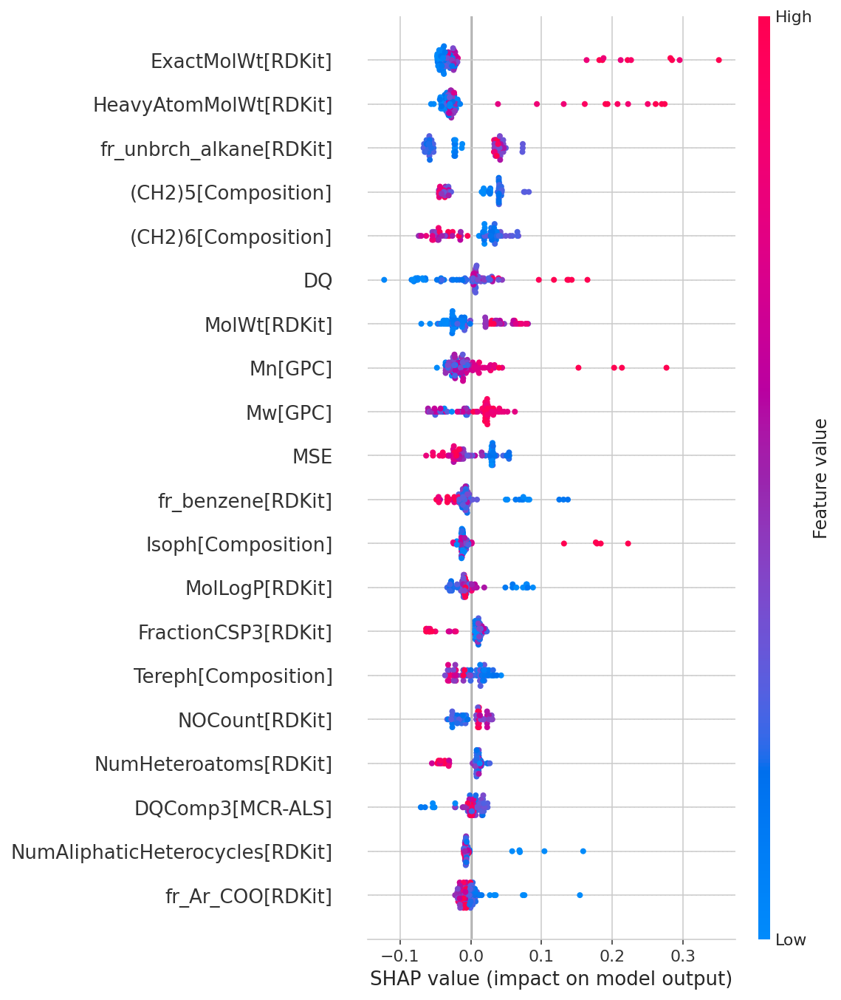

./data/oligomer_RF_20230213pyBoundWater.csv
oligomer_RF_20230213pyBoundWater
Best params: {'max_depth': 15, 'max_features': 'auto', 'n_estimators': 10}
Best Score: 0.969371677971942
0.9906593716885519
0.9764262861311712
RMSE 学習: 0.00, テスト: 0.00
R^2 学習: 0.99, テスト: 0.98


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


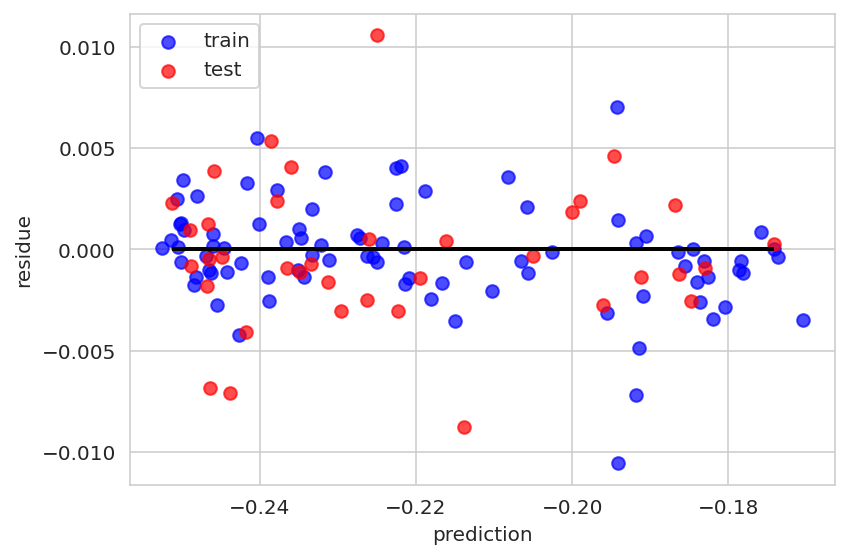

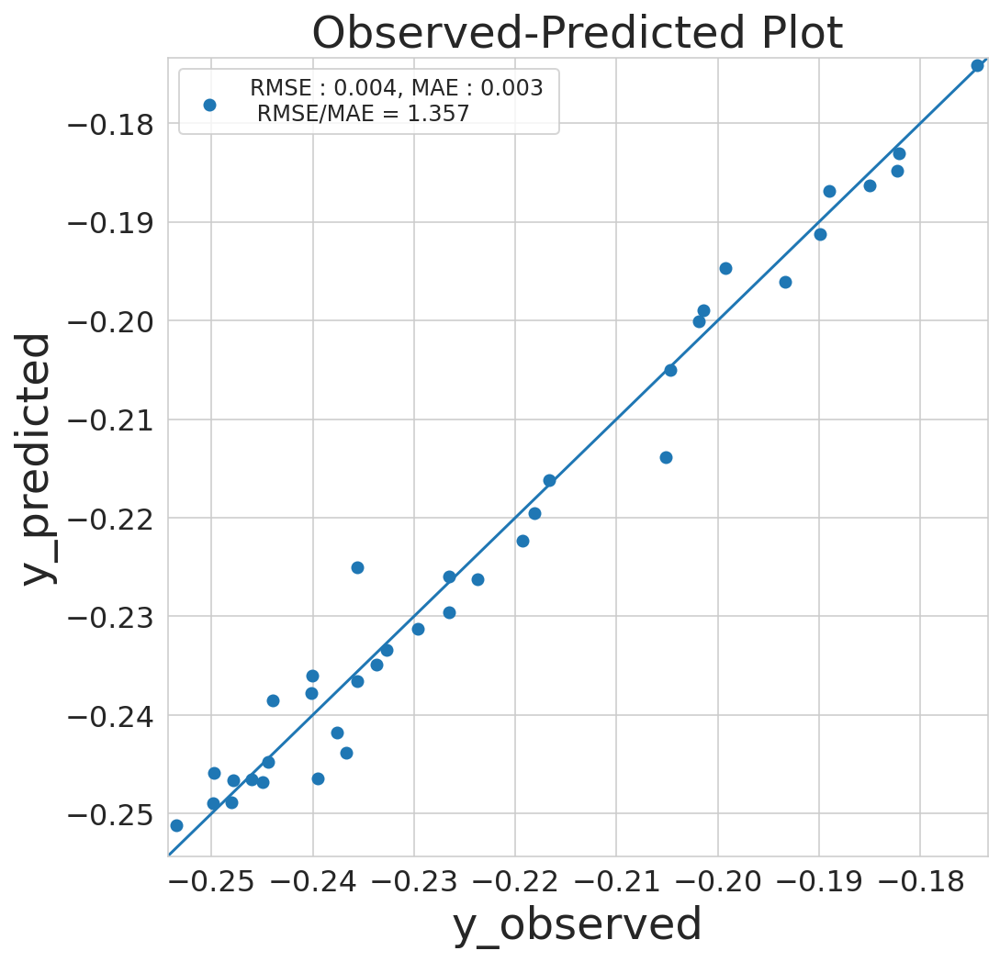

before
                          x         y
0                       MSE  0.001332
1                        DQ  0.000388
2                      MAPE  0.505333
3                   DQ/MAPE  0.000098
4         MSEComp1[MCR-ALS]  0.000355
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.000004
60        fr_benzene[RDKit]  0.000033
61       fr_bicyclic[RDKit]  0.000288
62          fr_ether[RDKit]  0.000017
63  fr_unbrch_alkane[RDKit]  0.000087

[64 rows x 2 columns]
after
                          x         y
0                       MSE  0.001332
1                        DQ  0.000388
2                      MAPE  0.505333
3                   DQ/MAPE  0.000098
4         MSEComp1[MCR-ALS]  0.000355
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.000004
60        fr_benzene[RDKit]  0.000033
61       fr_bicyclic[RDKit]  0.000288
62          fr_ether[RDKit]  0.000017
63  fr_unbrch_alkane[RDKit]  0.000087

[64 rows x 2 columns]


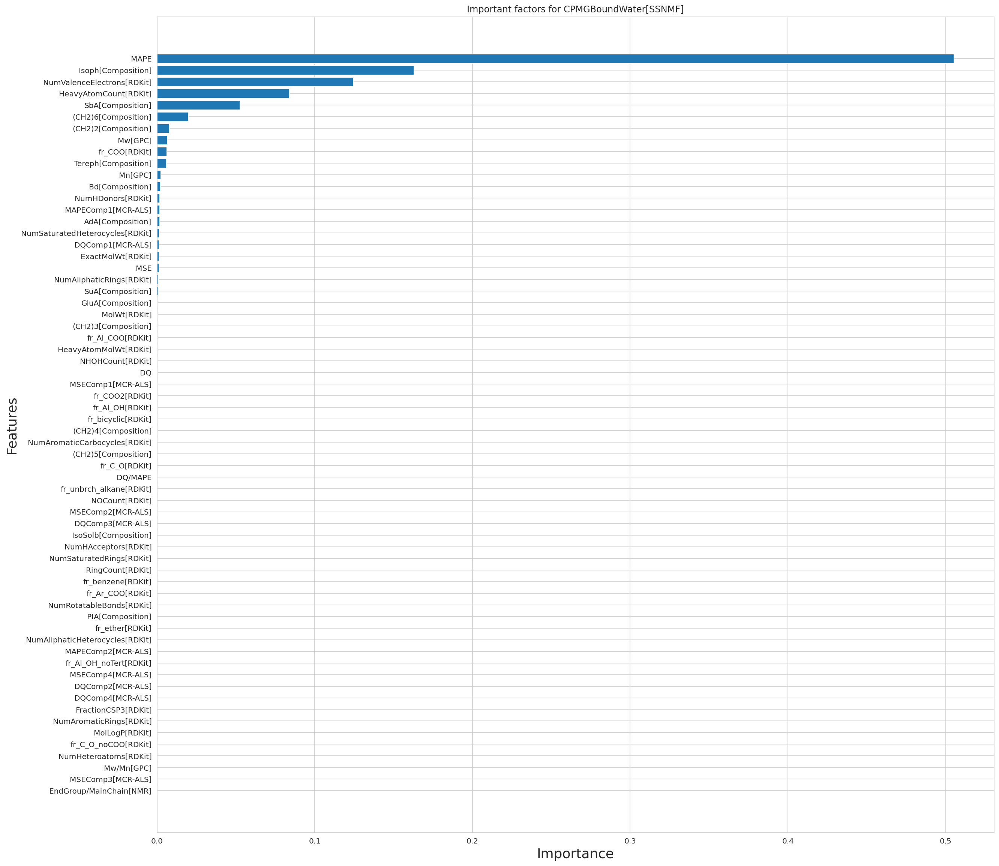

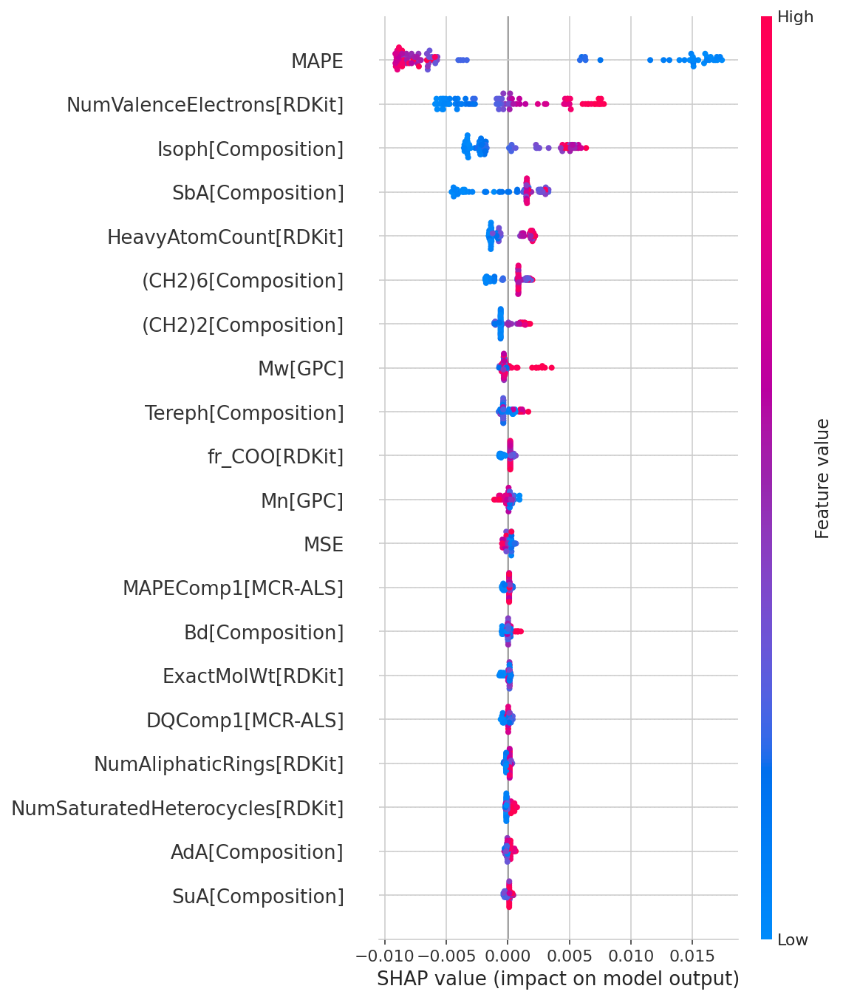

./data/oligomer_RF_20230213pyOriginal.csv
oligomer_RF_20230213pyOriginal
Best params: {'max_depth': 25, 'max_features': None, 'n_estimators': 20}
Best Score: 0.9378571389993745
0.9891807318440654
0.9348407822653924
RMSE 学習: 0.00, テスト: 0.01
R^2 学習: 0.99, テスト: 0.93


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


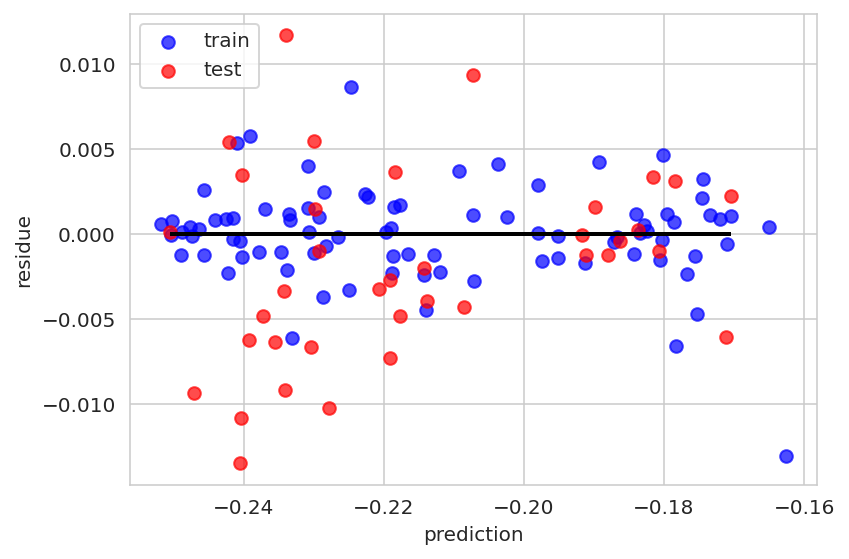

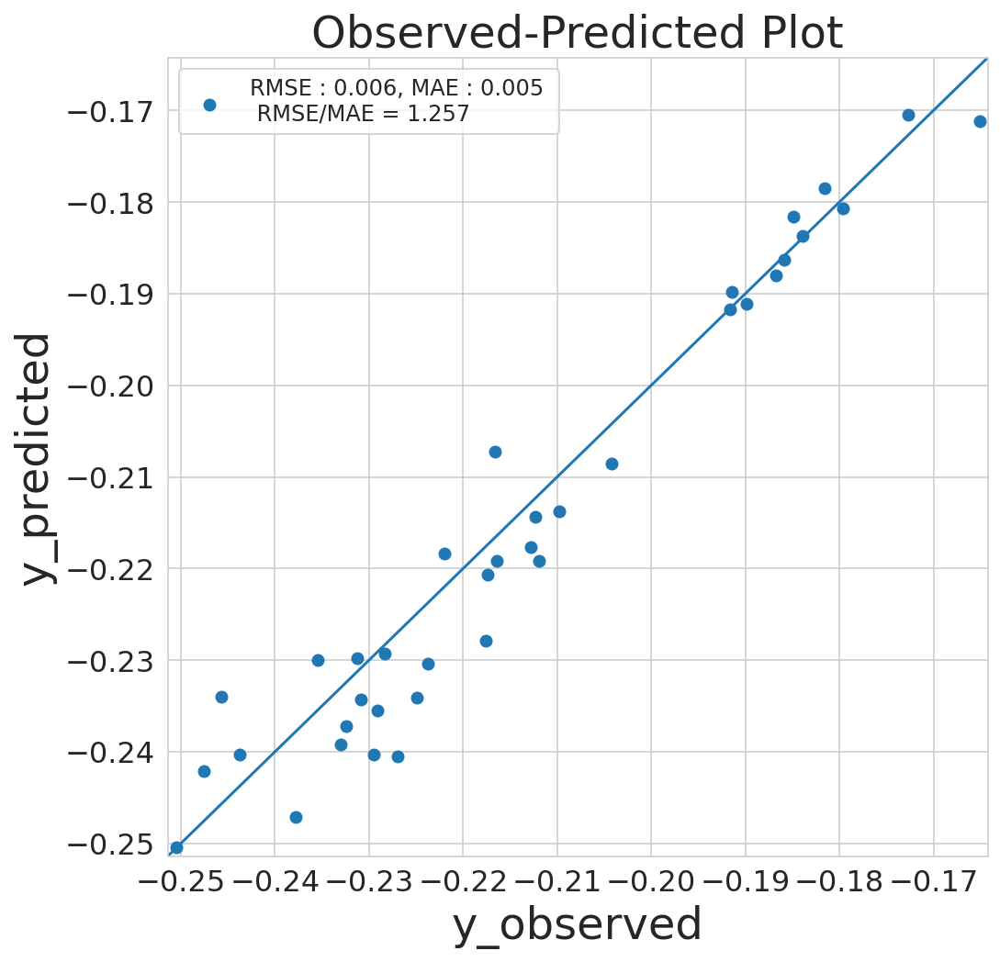

before
                          x         y
0                       MSE  0.000453
1                        DQ  0.001806
2                      MAPE  0.213383
3                   DQ/MAPE  0.000117
4         MSEComp1[MCR-ALS]  0.000081
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.000113
60        fr_benzene[RDKit]  0.000087
61       fr_bicyclic[RDKit]  0.000302
62          fr_ether[RDKit]  0.000214
63  fr_unbrch_alkane[RDKit]  0.000147

[64 rows x 2 columns]
after
                          x         y
0                       MSE  0.000453
1                        DQ  0.001806
2                      MAPE  0.213383
3                   DQ/MAPE  0.000117
4         MSEComp1[MCR-ALS]  0.000081
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.000113
60        fr_benzene[RDKit]  0.000087
61       fr_bicyclic[RDKit]  0.000302
62          fr_ether[RDKit]  0.000214
63  fr_unbrch_alkane[RDKit]  0.000147

[64 rows x 2 columns]


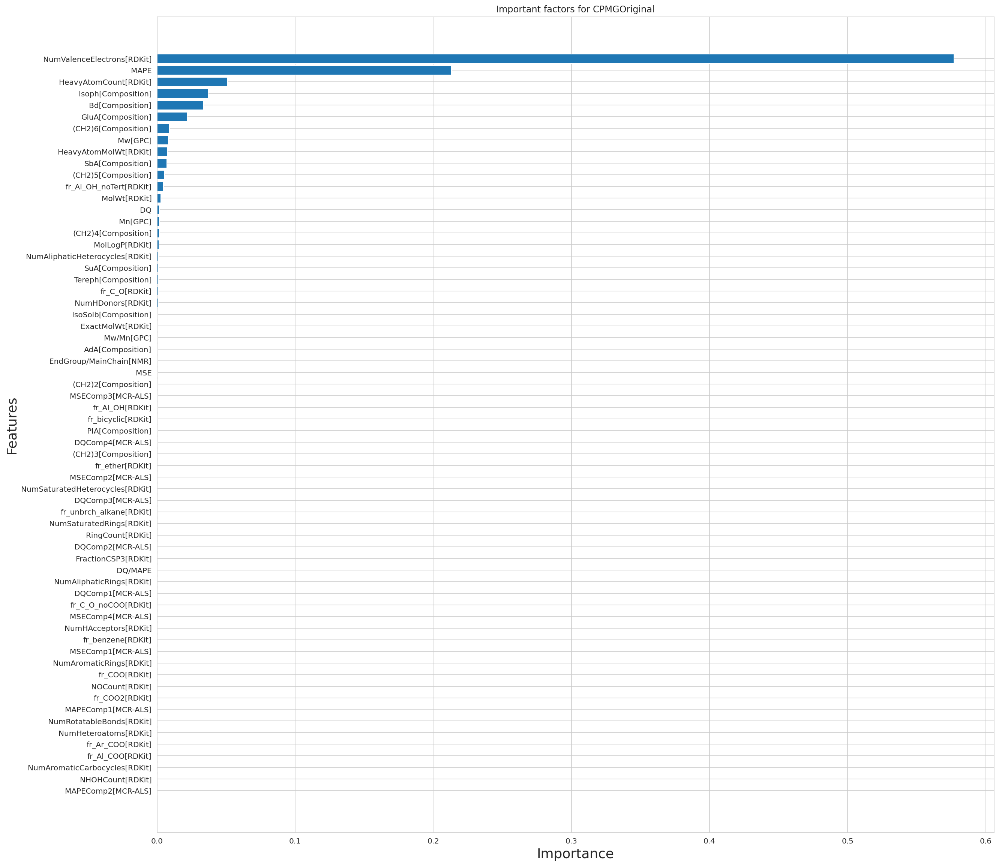

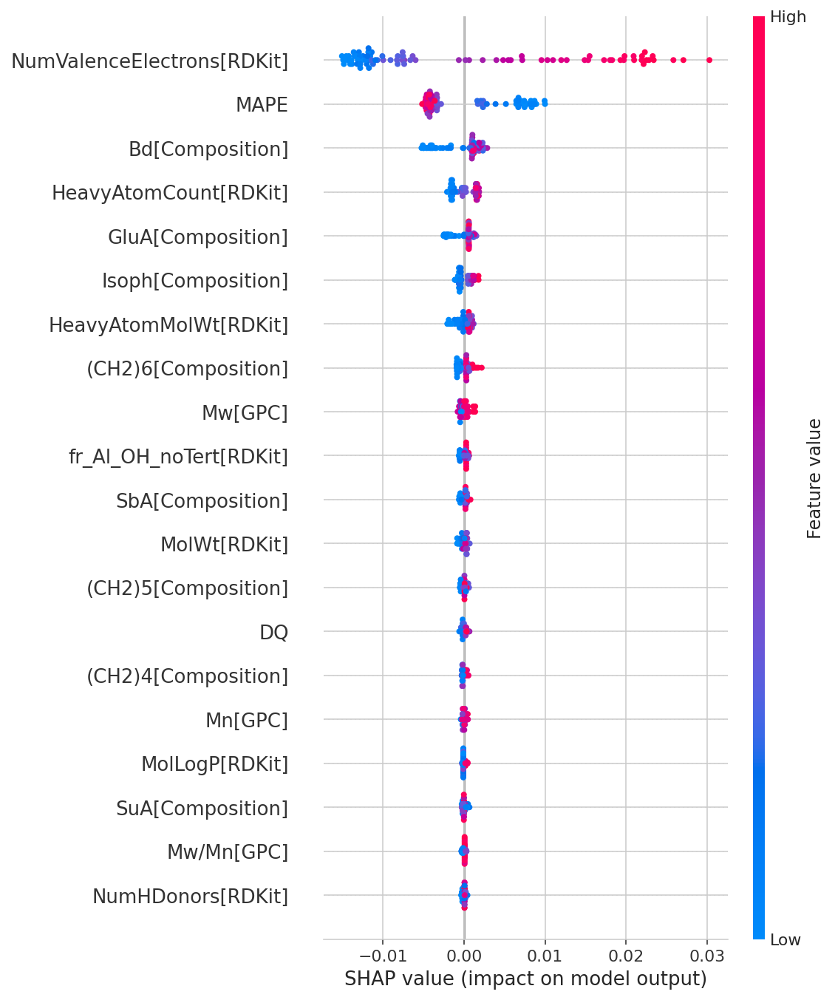

./data/oligomer_RF_20230213pyFreeWater.csv
oligomer_RF_20230213pyFreeWater
Best params: {'max_depth': 100, 'max_features': None, 'n_estimators': 10}
Best Score: 0.9424631227917443
0.9840884902368568
0.9206613631524004
RMSE 学習: 0.00, テスト: 0.01
R^2 学習: 0.98, テスト: 0.92


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


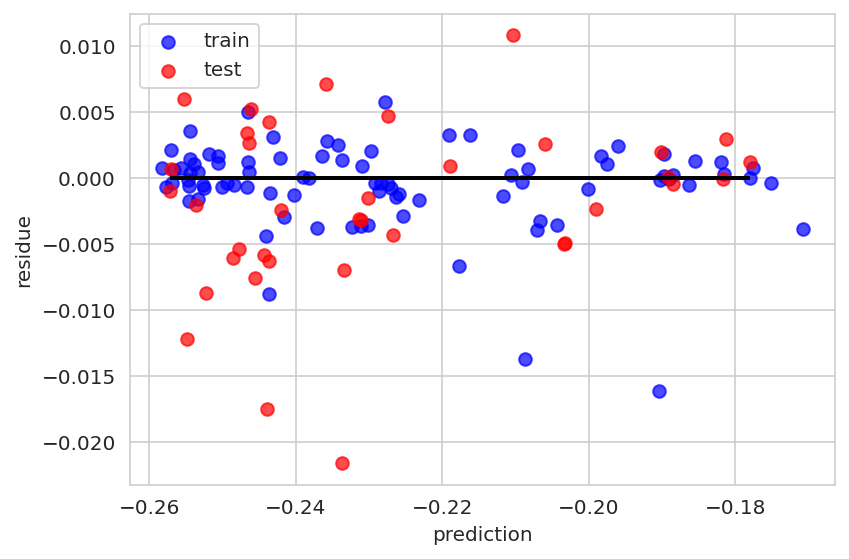

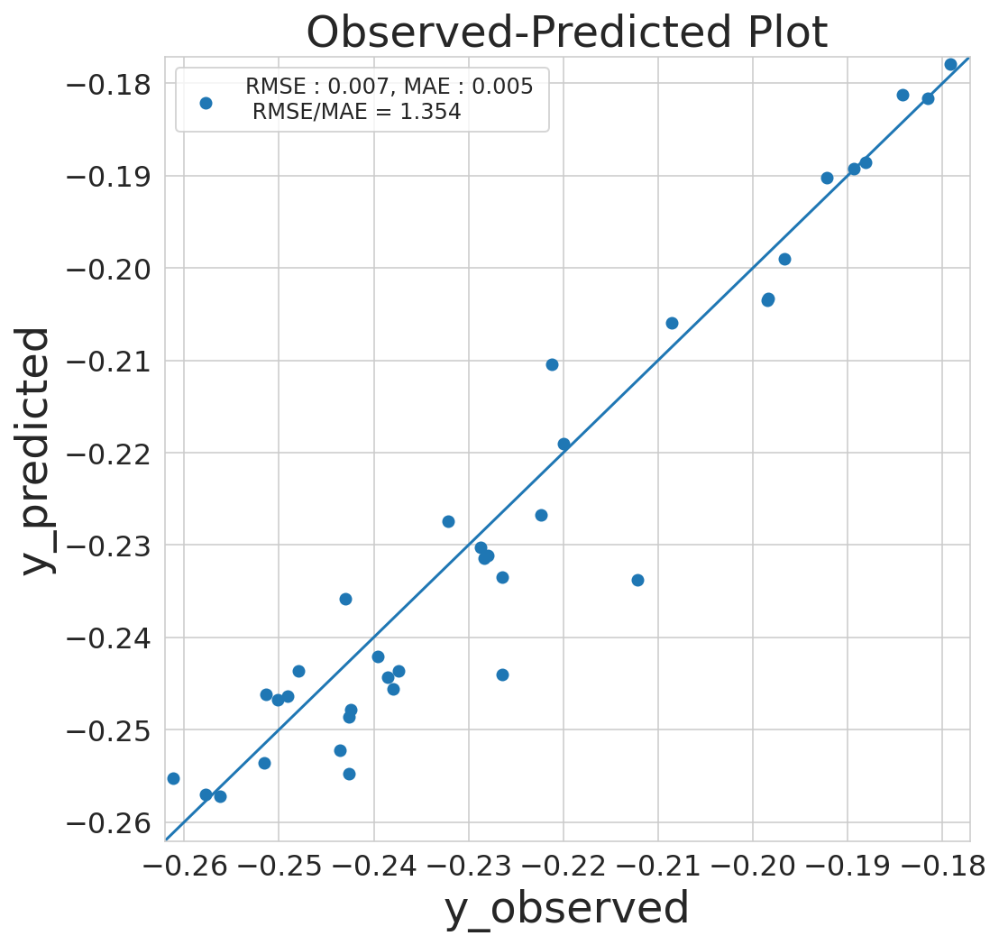

before
                          x         y
0                       MSE  0.084824
1                        DQ  0.001116
2                      MAPE  0.002389
3                   DQ/MAPE  0.000022
4         MSEComp1[MCR-ALS]  0.000035
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.076779
60        fr_benzene[RDKit]  0.000039
61       fr_bicyclic[RDKit]  0.000010
62          fr_ether[RDKit]  0.000050
63  fr_unbrch_alkane[RDKit]  0.077377

[64 rows x 2 columns]
after
                          x         y
0                       MSE  0.084824
1                        DQ  0.001116
2                      MAPE  0.002389
3                   DQ/MAPE  0.000022
4         MSEComp1[MCR-ALS]  0.000035
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.076779
60        fr_benzene[RDKit]  0.000039
61       fr_bicyclic[RDKit]  0.000010
62          fr_ether[RDKit]  0.000050
63  fr_unbrch_alkane[RDKit]  0.077377

[64 rows x 2 columns]


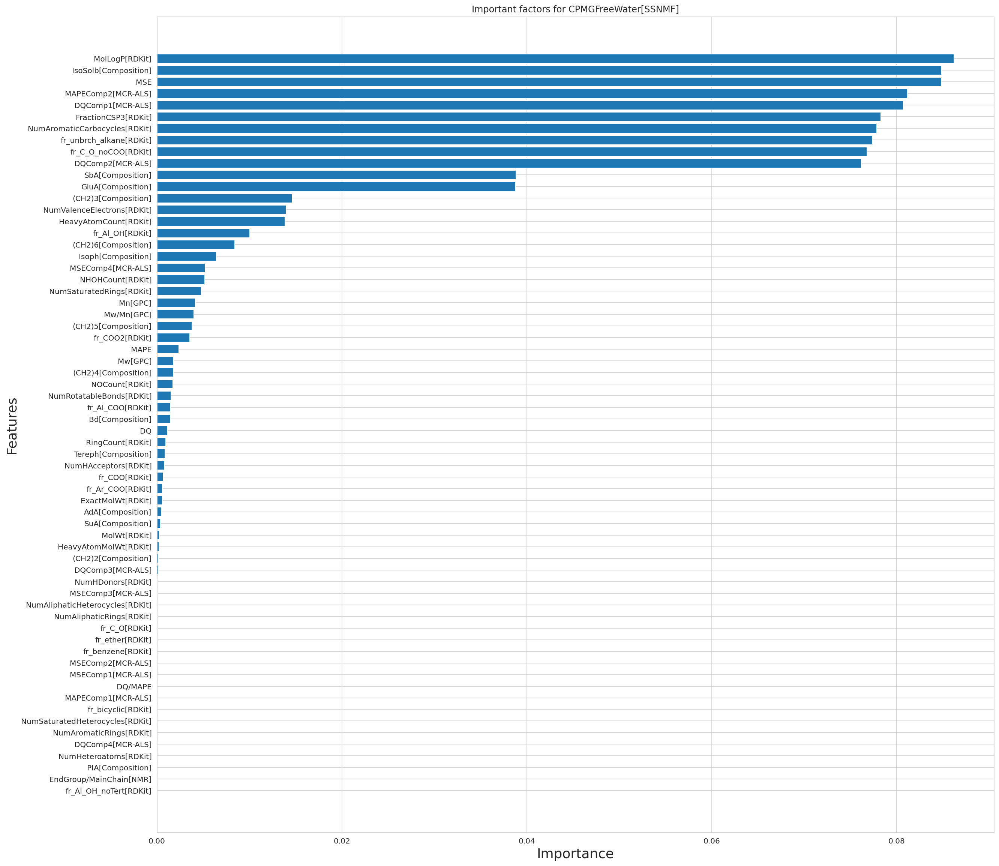

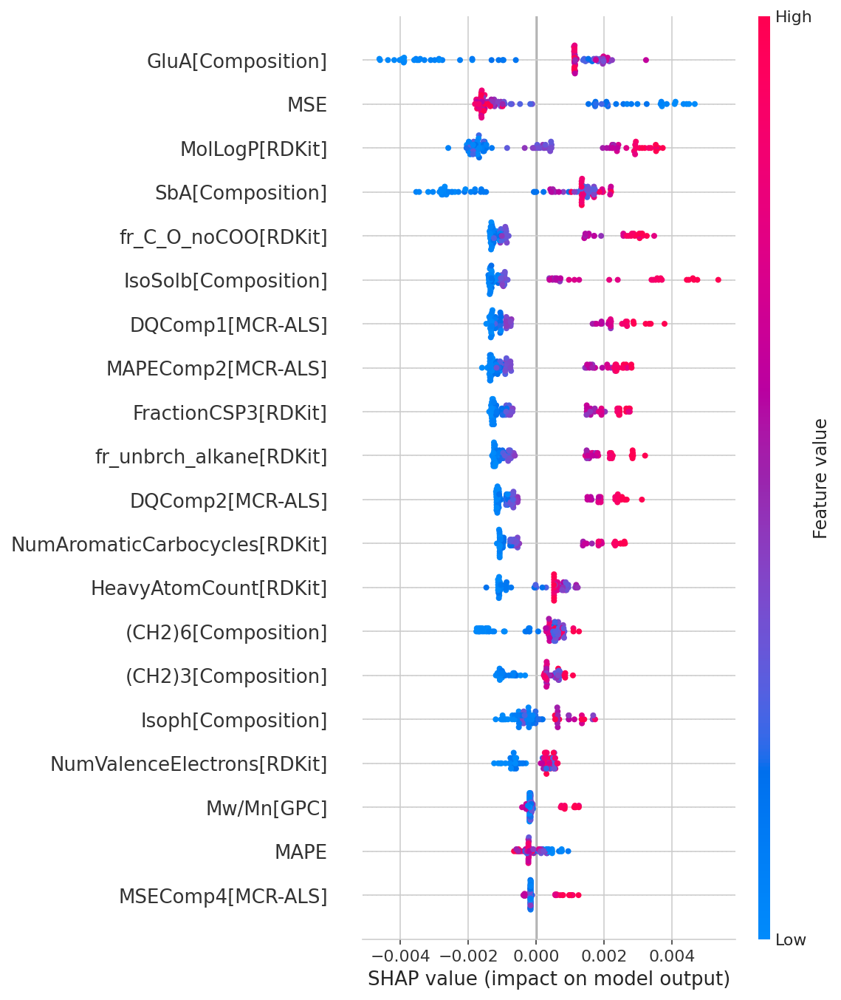

./data/oligomer_RF_20230213pyAdA.csv
oligomer_RF_20230213pyAdA
Best params: {'max_depth': 5, 'max_features': None, 'n_estimators': 30}
Best Score: 0.9131389193632661
0.9858122717274798
0.8524006553897041
RMSE 学習: 0.00, テスト: 0.01
R^2 学習: 0.99, テスト: 0.85


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


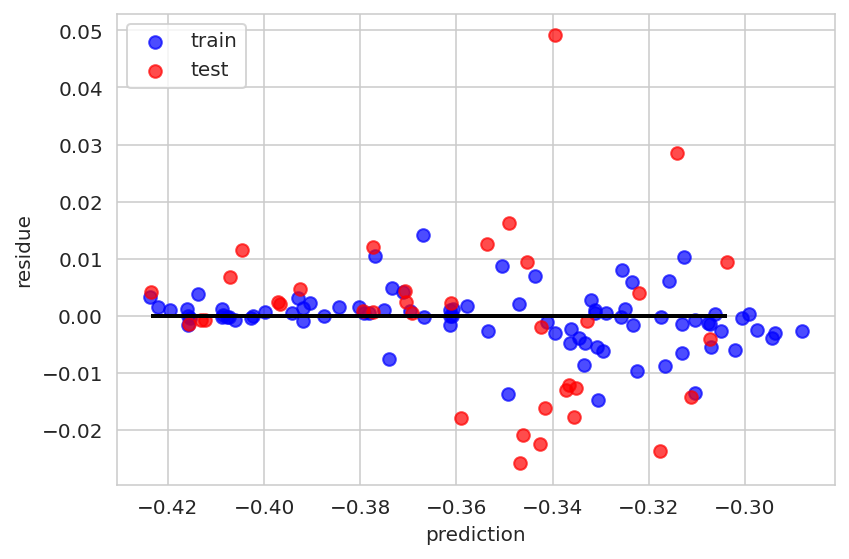

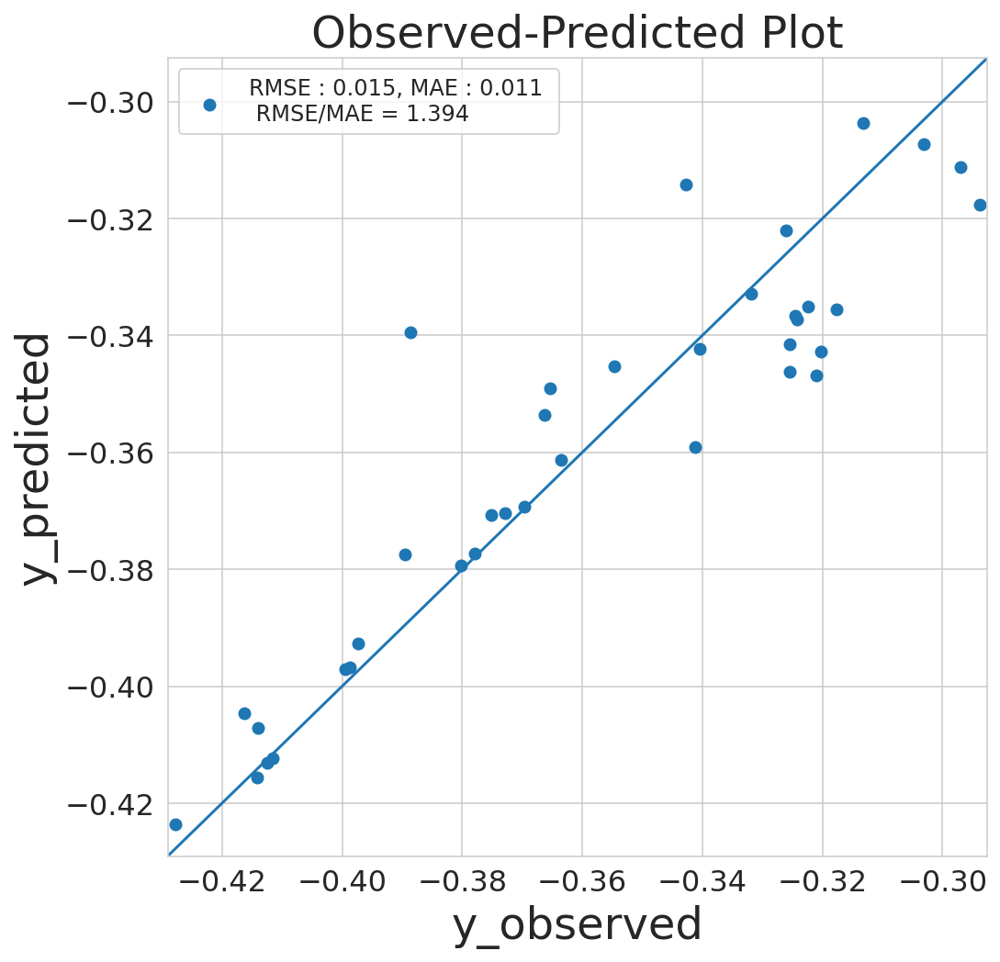

before
                                x         y
0                    CPMGOriginal  0.010234
1              CPMGOriginalT2[ms]  0.055215
2            CPMGFreeWater[SSNMF]  0.004329
3           CPMGBoundWater[SSNMF]  0.007167
4   CPMGStronglyBoundWater[SSNMF]  0.015662
5                    FreeWater[%]  0.029623
6                   BoundWater[%]  0.008641
7           StronglyBoundWater[%]  0.004361
8                     Strongly[%]  0.010535
9                             MSE  0.001933
10                             DQ  0.149799
11                           MAPE  0.486986
12                        DQ/MAPE  0.015951
13              MSEComp1[MCR-ALS]  0.012069
14              MSEComp2[MCR-ALS]  0.012265
15              MSEComp3[MCR-ALS]  0.012966
16              MSEComp4[MCR-ALS]  0.034500
17               DQComp1[MCR-ALS]  0.006939
18               DQComp2[MCR-ALS]  0.006566
19               DQComp3[MCR-ALS]  0.015438
20               DQComp4[MCR-ALS]  0.027116
21             MAPEComp1[

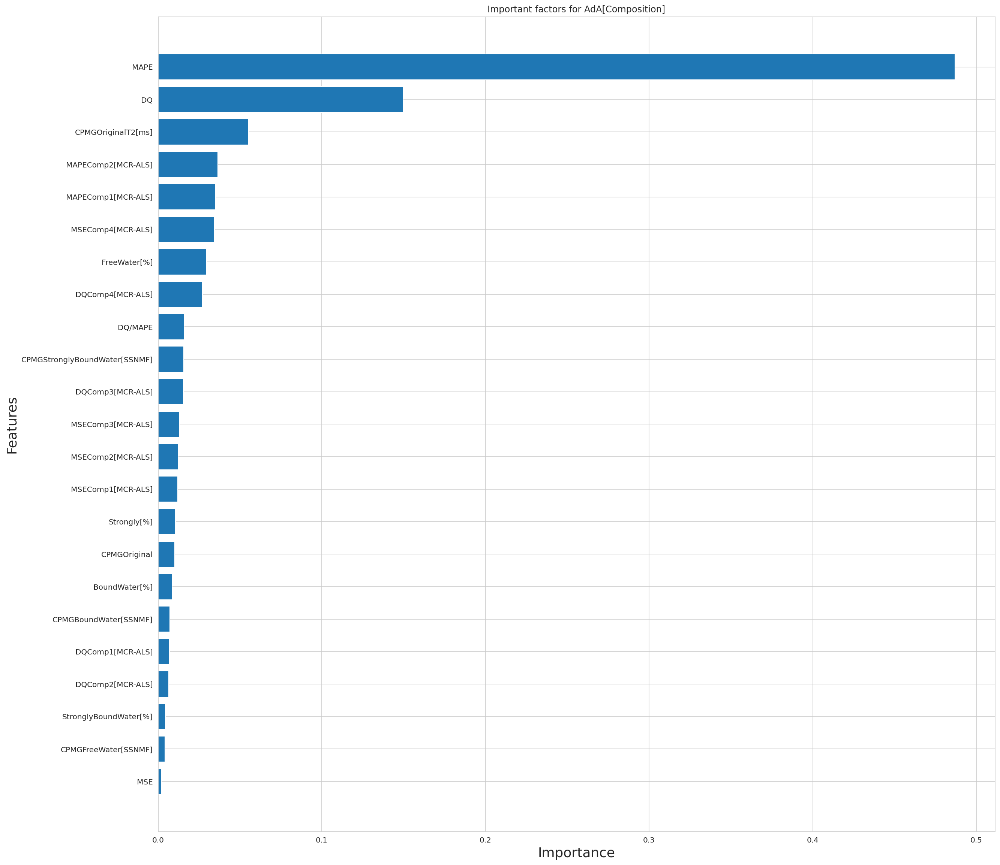

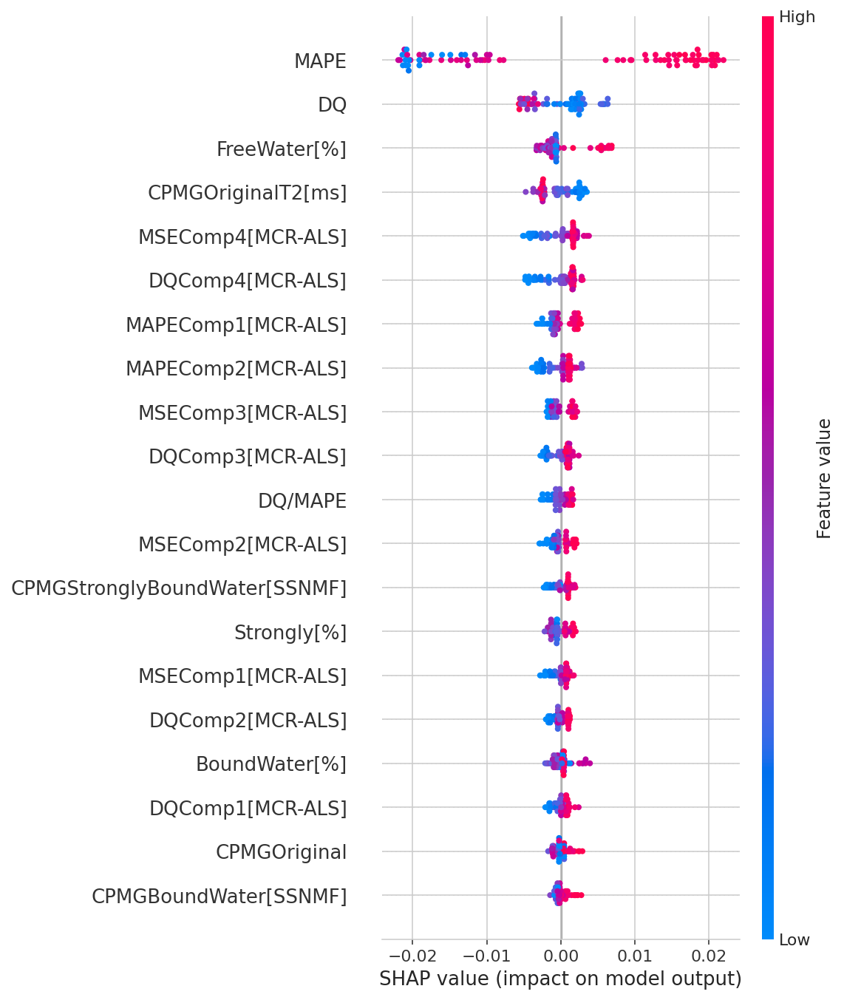

./data/oligomer_RF_20230213pyDQMAPE.csv
oligomer_RF_20230213pyDQMAPE
Best params: {'max_depth': 50, 'max_features': 'sqrt', 'n_estimators': 3}
Best Score: 0.987719011374464
0.9945194261679295
0.9781060765135369
RMSE 学習: 0.00, テスト: 0.00
R^2 学習: 0.99, テスト: 0.98


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


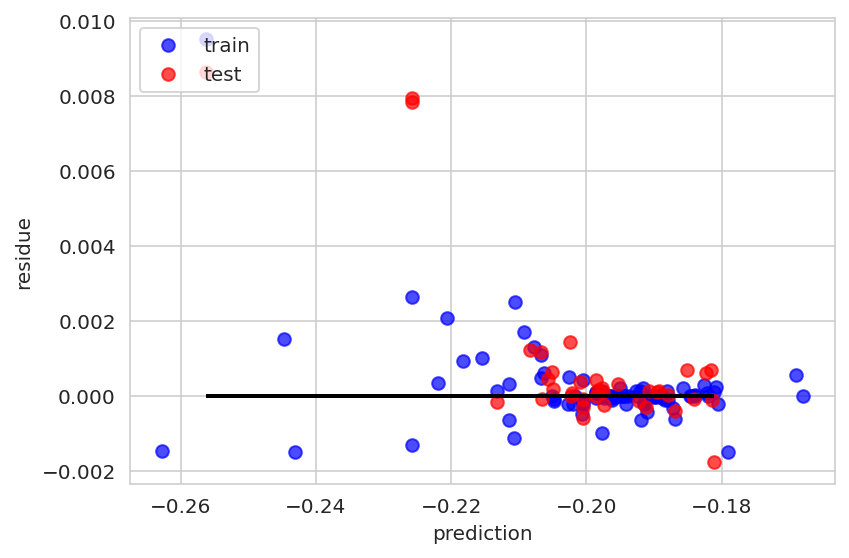

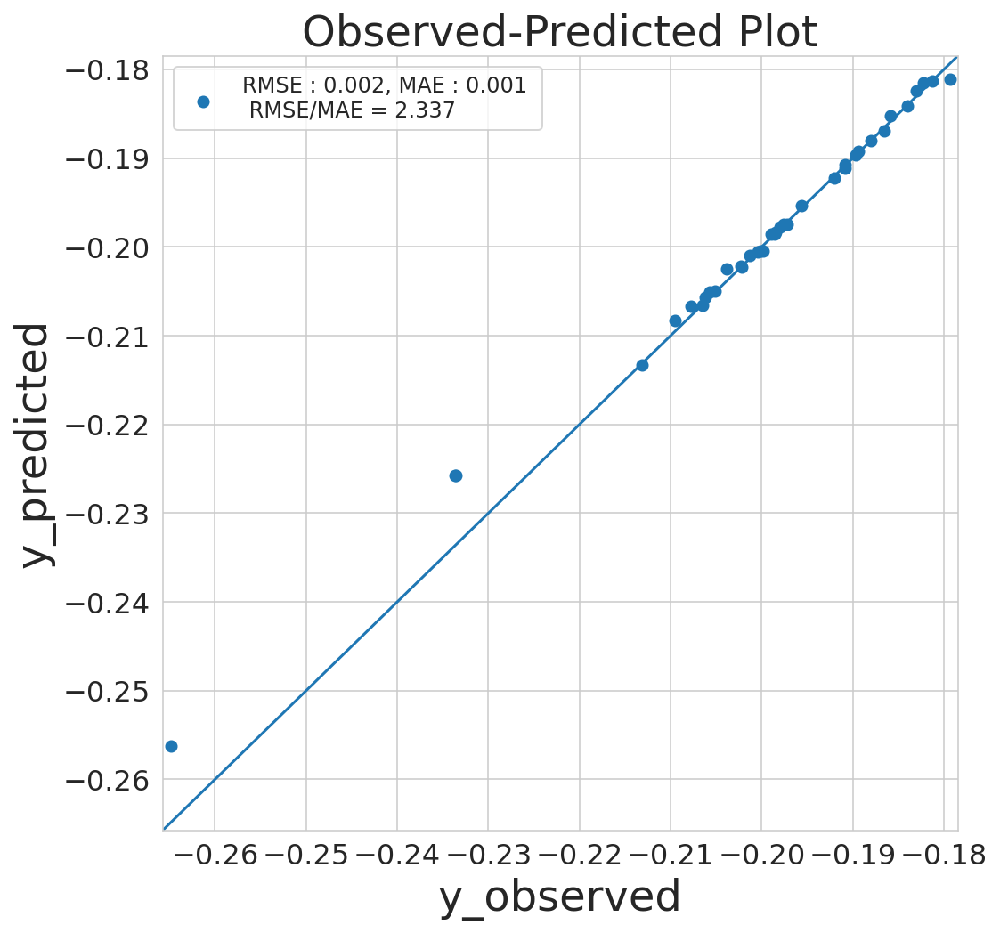

before
                                  x             y
0                      CPMGOriginal  1.331608e-06
1                CPMGOriginalT2[ms]  1.265058e-03
2              CPMGFreeWater[SSNMF]  7.563265e-03
3             CPMGBoundWater[SSNMF]  1.246582e-04
4     CPMGStronglyBoundWater[SSNMF]  3.656018e-04
5                      FreeWater[%]  5.346248e-07
6                     BoundWater[%]  9.214913e-05
7             StronglyBoundWater[%]  2.565741e-04
8                       Strongly[%]  2.238609e-07
9           EndGroup/MainChain[NMR]  5.052599e-07
10                          Mw[GPC]  3.911877e-03
11                          Mn[GPC]  1.909381e-05
12                       Mw/Mn[GPC]  5.865931e-04
13                 SuA[Composition]  1.047064e-04
14                 AdA[Composition]  0.000000e+00
15                 PIA[Composition]  5.830140e-06
16                GluA[Composition]  3.130064e-05
17                 SbA[Composition]  1.514491e-03
18              Tereph[Composition]  4.2647

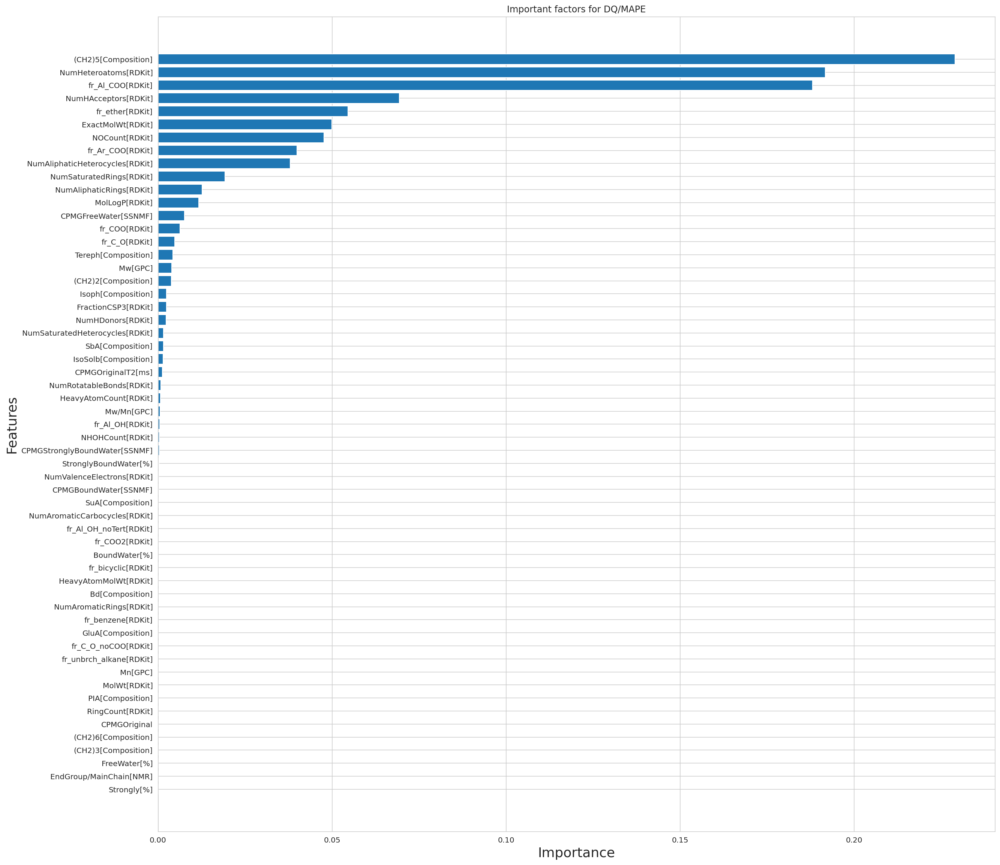

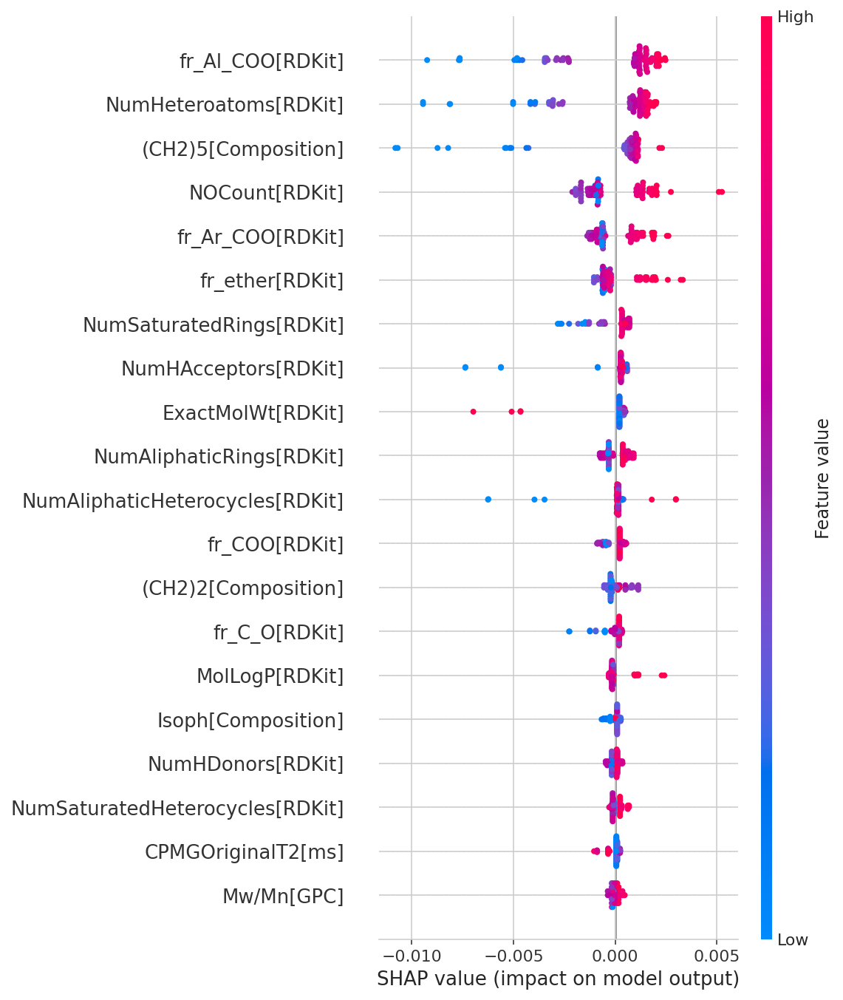

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import os
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn import metrics
import scipy.stats

sns.set_style('whitegrid',{'linestyle.grid':'--'})
%matplotlib inline

import glob
files = glob.glob("./data/*")
for file in files:
    print(file)
    print(os.path.basename(file).split('.', 1)[0])
    from scipy import stats
    df = pd.read_csv(file, index_col=0)
    df = df.apply(stats.zscore, axis=1)

    # 説明変数と目的変数
    X=df.iloc[:,1:]#data.data
    y=df.iloc[:,0]#data.target

    # 訓練データ(train)と検証データ(test)にわける 
    X_train,X_test,y_train,y_test=train_test_split(X.values,y.values,test_size=0.3,random_state=1)

    from sklearn.ensemble        import RandomForestClassifier
    from sklearn.model_selection import GridSearchCV
    from sklearn.model_selection import train_test_split

    # 学習データ＆テストデータ分割
    #X_train, X_test,  Y_train, Y_test = train_test_split(dataset[features_reg],dataset[target_reg],test_size=0.3, random_state=3)

    # グリッドサーチによるハイパーパラメータ探索候補設定
    # 今回はRandomForestClassifierのパラメータが対象(値は任意に設定)
    parameters = {  
        'n_estimators': [3,5,10, 20, 30, 50, 100],     # 用意する決定木モデルの数
        'max_features': ('sqrt', 'log2','auto', None),  # ランダムに指定する特徴量の数
        'max_depth':    (3,5,10,15,25,30,40,50,100, None),     # 決定木のノード深さの制限値
    }

    # モデルインスタンス
    model = RandomForestRegressor()#RandomForestClassifier()

    # ハイパーパラメータチューニング(グリッドサーチのコンストラクタにモデルと辞書パラメータを指定)
    gridsearch = GridSearchCV(estimator = model,        # モデル
                              param_grid = parameters,  # チューニングするハイパーパラメータ
                              scoring = "r2"      # スコアリング
                            )


    # 演算実行
    gridsearch.fit(X_train, y_train)

    # グリッドサーチの結果から得られた最適なパラメータ候補を確認
    print('Best params: {}'.format(gridsearch.best_params_)) 
    print('Best Score: {}'.format(gridsearch.best_score_))

    clf = RandomForestRegressor(n_estimators = gridsearch.best_params_['n_estimators'], # 用意する決定木モデルの数
                                  max_features = gridsearch.best_params_['max_features'], # ランダムに指定する特徴量の数
                                  max_depth    = gridsearch.best_params_['max_depth'],    # 決定木のノード深さの制限値
                                  criterion='mse',                                       # 不純度評価指標の種類(ジニ係数）
                                  min_samples_leaf = 1,                                   # 1ノードの深さの最小値
                                  random_state = 0,                                       # 乱数シード
                                  )


    # モデルの作成
    #clf = DecisionTreeClassifier(max_depth=3) 
    #from sklearn.tree import DecisionTreeRegressor
    #clf = DecisionTreeRegressor(random_state=0) 
    # モデルの学習
    clf.fit(X_train, y_train)
    

    # 評価
    print(clf.score(X_train,y_train))
    print(clf.score(X_test,y_test))
    
    from sklearn.metrics import r2_score            # 決定係数
    from sklearn.metrics import mean_squared_error  # RMSE

    # 予測値(Train）
    y_train_pred = clf.predict(X_train)

    # 予測値（Test)
    y_test_pred = clf.predict(X_test)

    # 平均平方二乗誤差(RMSE)
    print('RMSE 学習: %.2f, テスト: %.2f' % (
            mean_squared_error(y_train, y_train_pred, squared=False), # 学習
            mean_squared_error(y_test, y_test_pred, squared=False)    # テスト
          ))

    # 決定係数(R^2)
    print('R^2 学習: %.2f, テスト: %.2f' % (
            r2_score(y_train, y_train_pred), # 学習
            r2_score(y_test, y_test_pred)    # テスト
          ))
    
    # 予測値と残差をプロット（学習データ）
    plt.scatter(y_train_pred,             # グラフのx値(予測値)  
                y_train_pred - y_train,   # グラフのy値(予測値と学習値の差)
                c='blue',                 # プロットの色
                marker='o',               # マーカーの種類
                s=40,                     # マーカーサイズ
                alpha=0.7,                # 透明度
                label='train')         # ラベルの文字


    # 予測値と残差をプロット（テストデータ）
    plt.scatter(y_test_pred,            
                y_test_pred - y_test, 
                c='red',
                marker='o', 
                s=40,
                alpha=0.7,
                label='test')

    # グラフの書式設定
    plt.xlabel('prediction')
    plt.ylabel('residue')
    plt.legend(loc='upper left')
    plt.hlines(y=0, xmin=np.amin(y_test_pred), xmax=np.amax(y_test_pred), lw=2, color='black')
    #plt.hlines(y=0, xmin=-20, xmax=60, lw=2, color='black')
    #plt.xlim([-20, 60])
    #plt.ylim([-50, 40])
    plt.tight_layout()
    plt.savefig("residue_"+os.path.basename(file).split('.', 1)[0]+".png")
    plt.show()

    # yyplot の実行例
    np.random.seed(0)
    y_obs = y_test#np.random.normal(size=(1000, 1))
    y_pred = y_test_pred#y_obs + np.random.normal(scale=0.3, size=(1000, 1))
    fig = yyplot(y_obs, y_pred)

    x = df.columns[1:] #特徴量名 ->['sepal length (cm)','sepal width (cm)','petal length (cm)','petal width (cm)']
    y = clf.feature_importances_ #特徴量の重要度
    df0 = pd.DataFrame({'x':x,'y':y})
    print('before')
    print(df0)

    df0 = remove_any_zero_row(df0)

    print('after')
    print(df0)
    df0.to_csv("Importance_"+os.path.basename(file).split('.', 1)[0]+".csv")
    # 可視化
    plot_sorted_bar(
        figsize=(20, 20),
        x=df0["x"].values, 
        y=df0["y"].values,
        title='Important factors for '+df.columns[0]
    )

    plt.show()
    import shap
    explainer = shap.TreeExplainer(clf, data=X_train)
    X_train_shap_values = explainer.shap_values(X_train)
    shap.summary_plot(shap_values=X_train_shap_values,
                  features=X_train,
                  show=False,
                  feature_names=df.columns[1:])
    plt.savefig("shap_"+os.path.basename(file).split('.', 1)[0]+".png") # 画像を保存
    plt.show()
    """
    import graphviz
    from sklearn.tree import export_graphviz
    from sklearn import tree
    dot = tree.export_graphviz(clf.estimators_[0], filled=True, rounded=True, 
                          #class_names=['setosa', 'versicolor', 'virginica'],
                          feature_names=df.columns[1:],
                          out_file=None) 

    graph = graphviz.Source(dot) #DOT記法をレンダリング
    #graph #グラフを出力
    # 画像を保存
    # 拡張子はいらない
    graph.render("Tree_"+os.path.basename(file).split('.', 1)[0])

    # 画像を表示
    graph.view()
    #features_reg = ["Pclass", "Fare", "Sex_label", "Cabin_label", "Embarked_label", "Survived"]
    #target_reg = "Age"

    #tree_regressor = DecisionTreeRegressor(max_depth=3, random_state=random_state, criterion="absolute_error")
    #tree_regressor.fit(dataset[features_reg].values, dataset[target_reg].values)
    import dtreeviz
    viz_rmodel = dtreeviz.model(model=clf.estimators_[0], 
                                X_train=df.iloc[:,1:], 
                                y_train=df.iloc[:,0], 
                                feature_names=df.columns[1:], 
                                target_name=df.columns[0])
    viz_rmodel.view(orientation="LR")
    """



./data/oligomer_RF_20230211pyCPMGFreeWater_s.csv
oligomer_RF_20230211pyCPMGFreeWater_s
Best params: {'max_depth': 15, 'max_features': 'auto', 'n_estimators': 10}
Best Score: 0.010521278663463774
0.8233661534356302
0.4095737049502364
RMSE 学習: 0.00, テスト: 0.01
R^2 学習: 0.82, テスト: 0.41


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


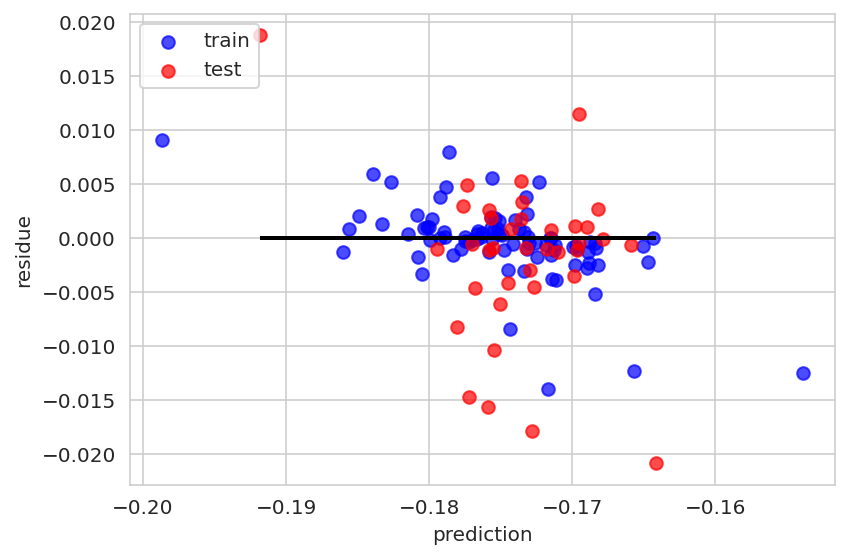

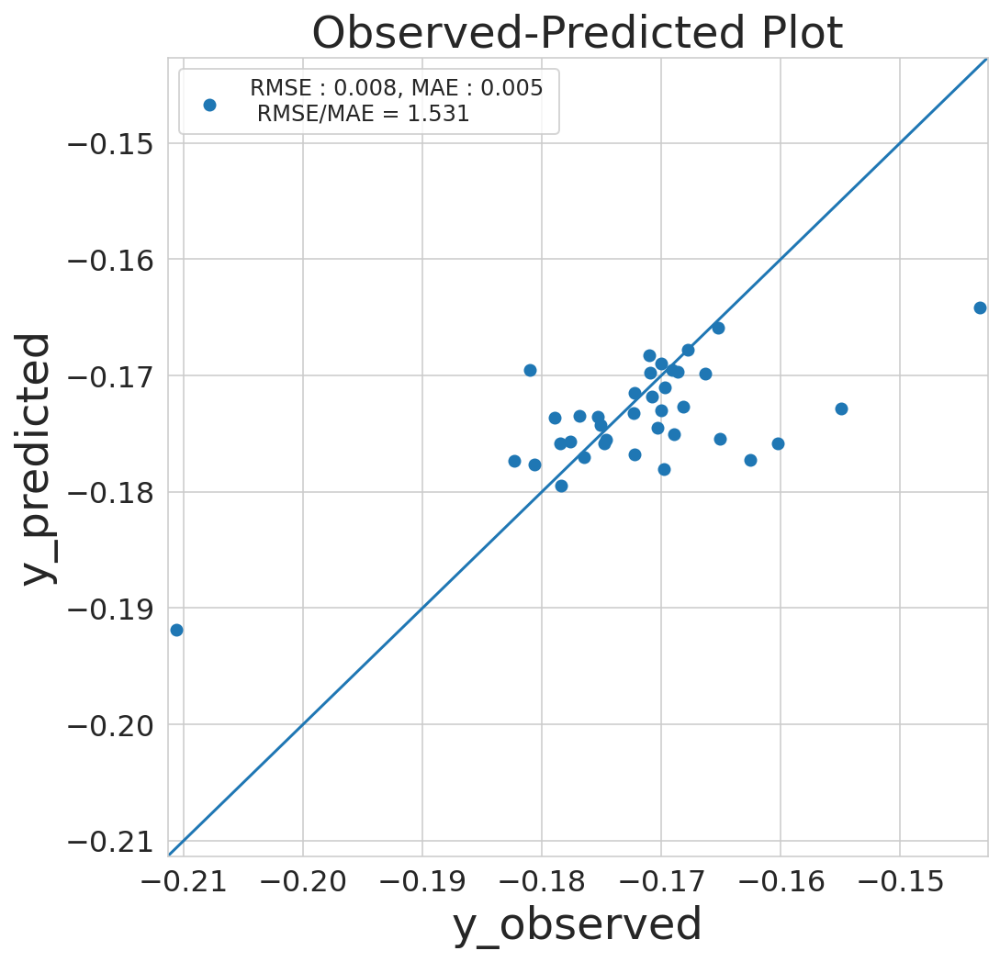

before
                                  x             y
0                 MSEComp1[MCR-ALS]  7.129441e-04
1                 MSEComp2[MCR-ALS]  2.960926e-03
2                 MSEComp3[MCR-ALS]  4.098157e-04
3                 MSEComp4[MCR-ALS]  5.192112e-04
4                  DQComp1[MCR-ALS]  1.919492e-02
5                  DQComp2[MCR-ALS]  3.022369e-04
6                  DQComp3[MCR-ALS]  6.438736e-05
7                  DQComp4[MCR-ALS]  7.490442e-04
8                MAPEComp1[MCR-ALS]  3.291583e-02
9                MAPEComp2[MCR-ALS]  4.334385e-04
10          EndGroup/MainChain[NMR]  1.254719e-03
11                          Mw[GPC]  2.132036e-02
12                          Mn[GPC]  3.485602e-02
13                       Mw/Mn[GPC]  6.102730e-03
14                 SuA[Composition]  6.190716e-02
15                 AdA[Composition]  4.433200e-02
16                 PIA[Composition]  1.241129e-04
17                GluA[Composition]  1.309172e-01
18                 SbA[Composition]  1.2801

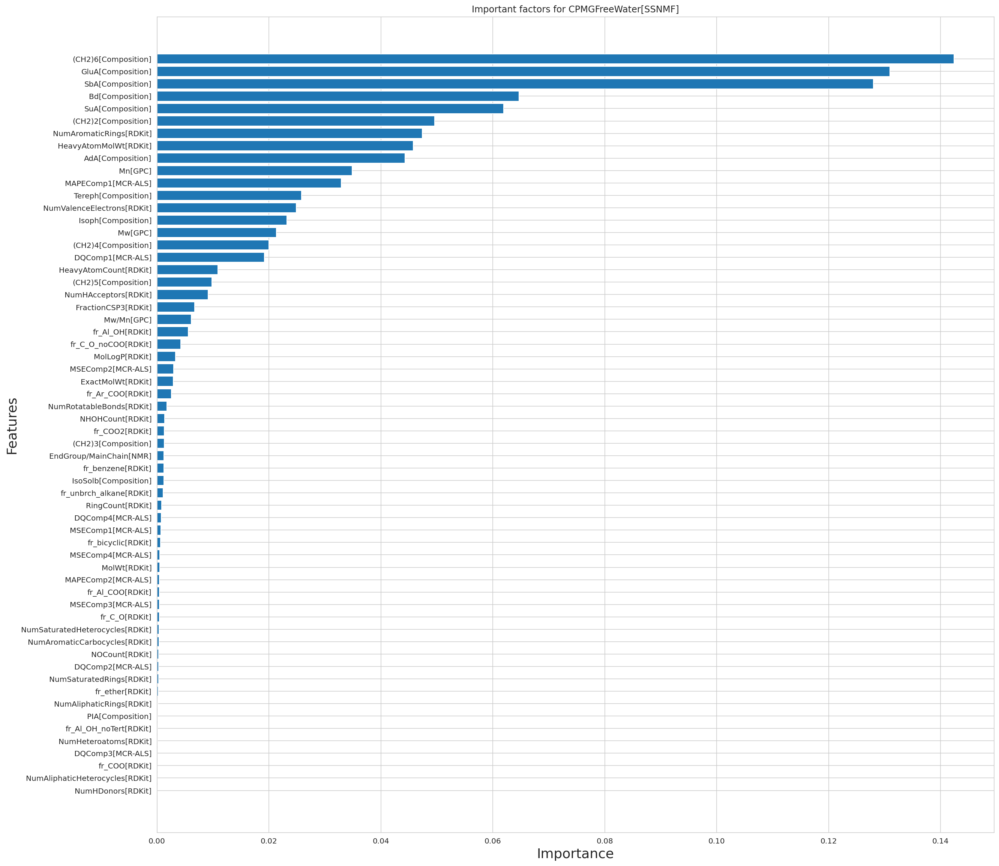

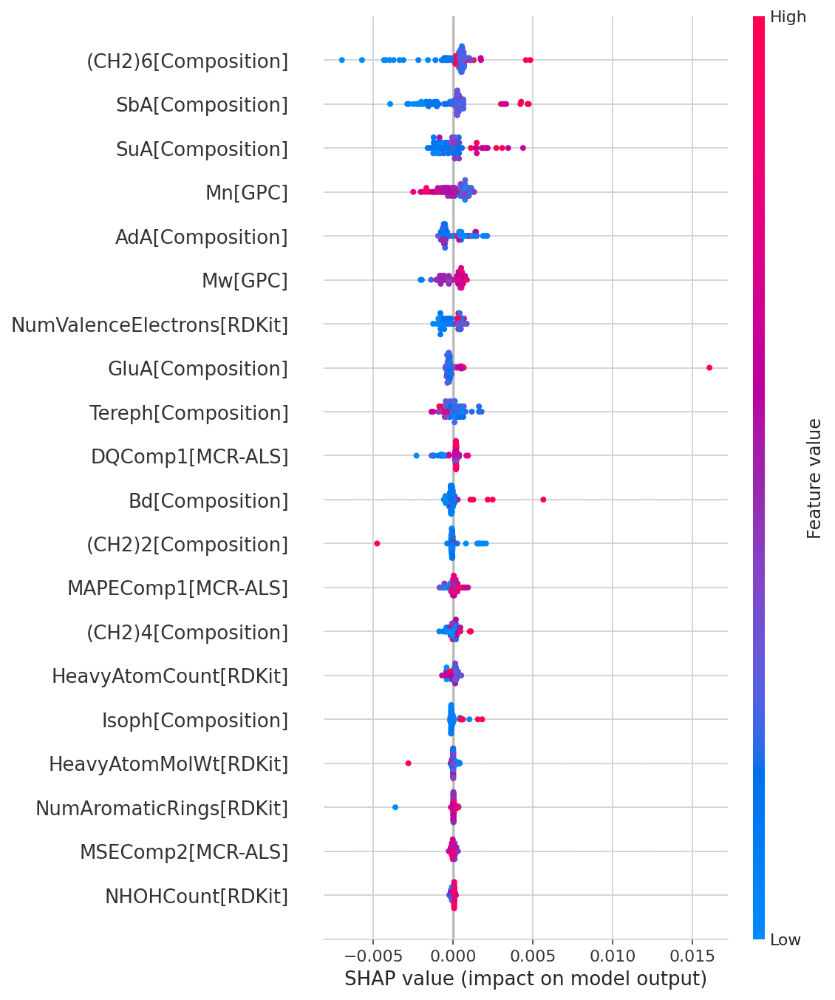

./data/oligomer_RF_20230211pyCPMGOriginal.csv
oligomer_RF_20230211pyCPMGOriginal
Best params: {'max_depth': 40, 'max_features': None, 'n_estimators': 30}
Best Score: 0.8591108062053447
0.977146348461224
0.899768714824309
RMSE 学習: 0.00, テスト: 0.00
R^2 学習: 0.98, テスト: 0.90


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


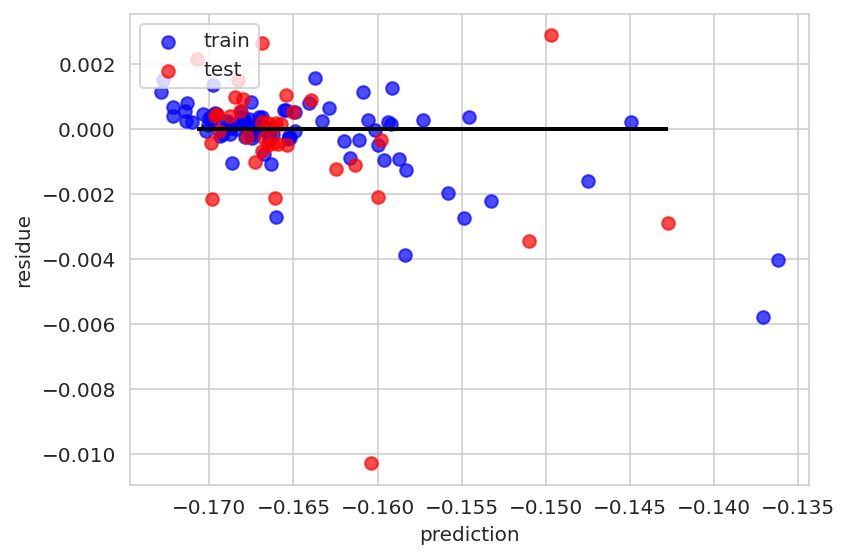

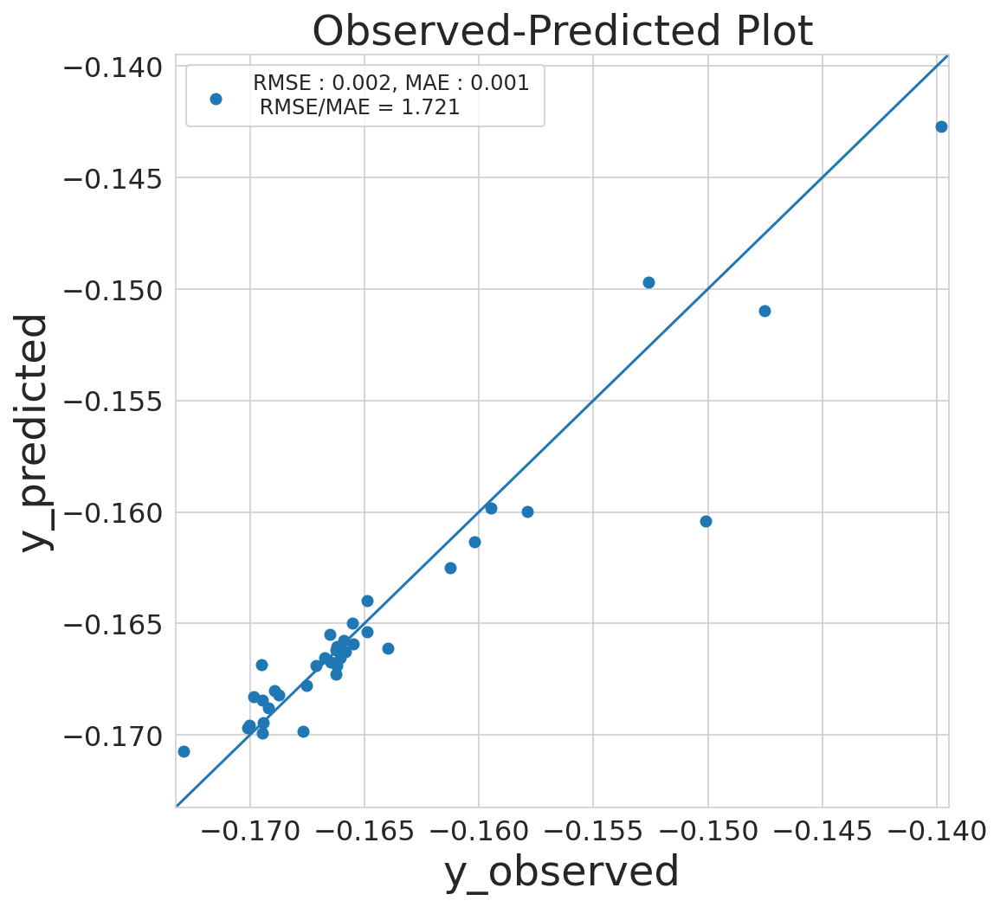

before
                                x         y
0              CPMGOriginalT2[ms]  0.356289
1            CPMGFreeWater[SSNMF]  0.003549
2           CPMGBoundWater[SSNMF]  0.035756
3   CPMGStronglyBoundWater[SSNMF]  0.057607
4               MSEComp1[MCR-ALS]  0.003789
..                            ...       ...
59            fr_C_O_noCOO[RDKit]  0.000193
60              fr_benzene[RDKit]  0.000589
61             fr_bicyclic[RDKit]  0.001183
62                fr_ether[RDKit]  0.017634
63        fr_unbrch_alkane[RDKit]  0.000908

[64 rows x 2 columns]
after
                                x         y
0              CPMGOriginalT2[ms]  0.356289
1            CPMGFreeWater[SSNMF]  0.003549
2           CPMGBoundWater[SSNMF]  0.035756
3   CPMGStronglyBoundWater[SSNMF]  0.057607
4               MSEComp1[MCR-ALS]  0.003789
..                            ...       ...
59            fr_C_O_noCOO[RDKit]  0.000193
60              fr_benzene[RDKit]  0.000589
61             fr_bicyclic[RDKit]  0.001

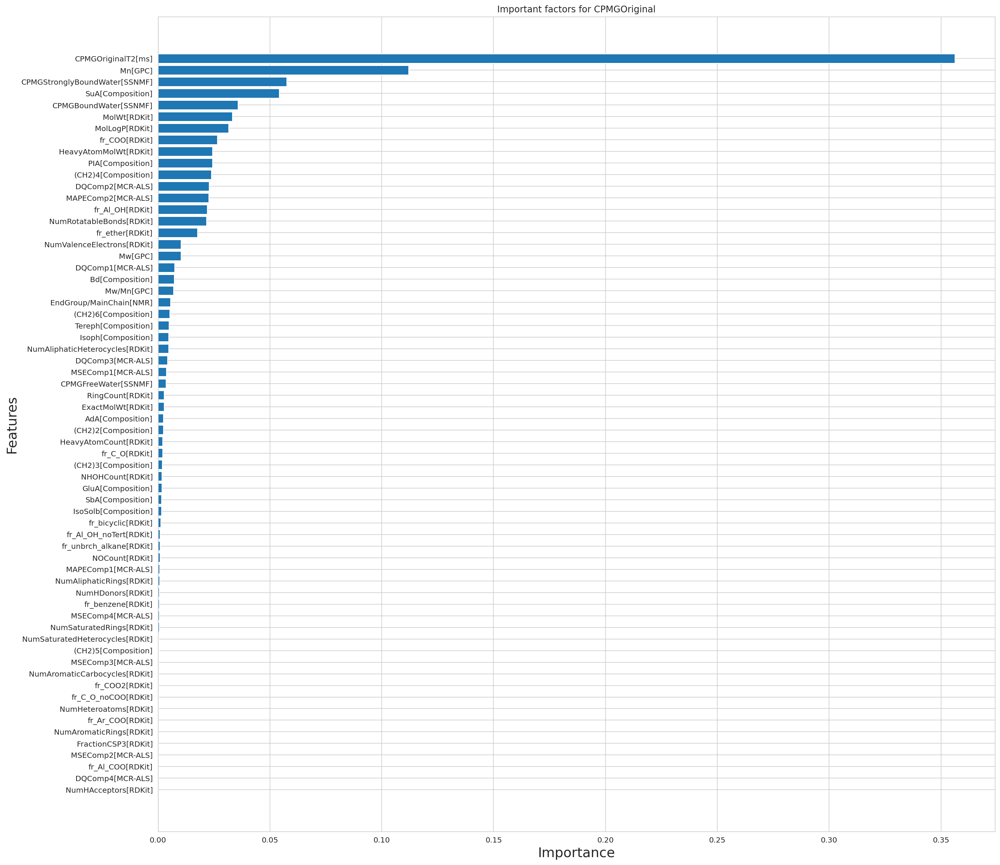

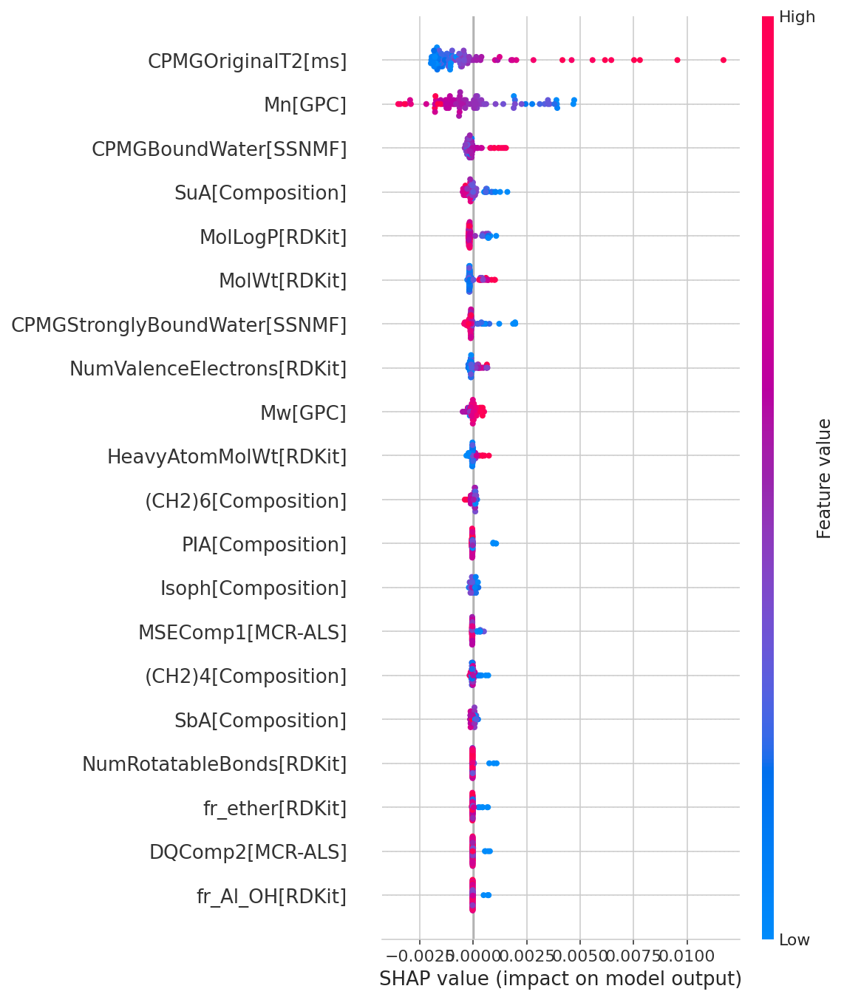

./data/oligomer_RF_20230211pyCPMGStronglyBoundWater.csv
oligomer_RF_20230211pyCPMGStronglyBoundWater
Best params: {'max_depth': None, 'max_features': 'auto', 'n_estimators': 20}
Best Score: 0.9260800761043486
0.9910714865840774
0.9816708918770244
RMSE 学習: 0.00, テスト: 0.00
R^2 学習: 0.99, テスト: 0.98


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


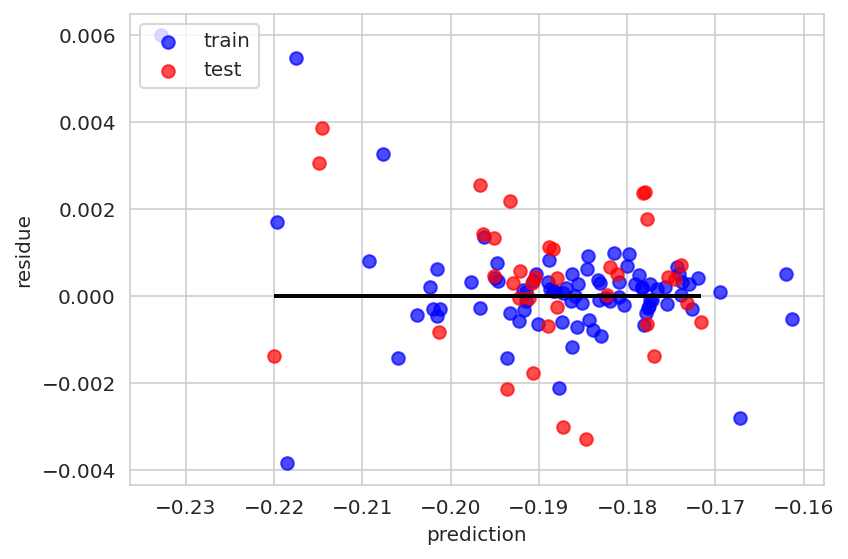

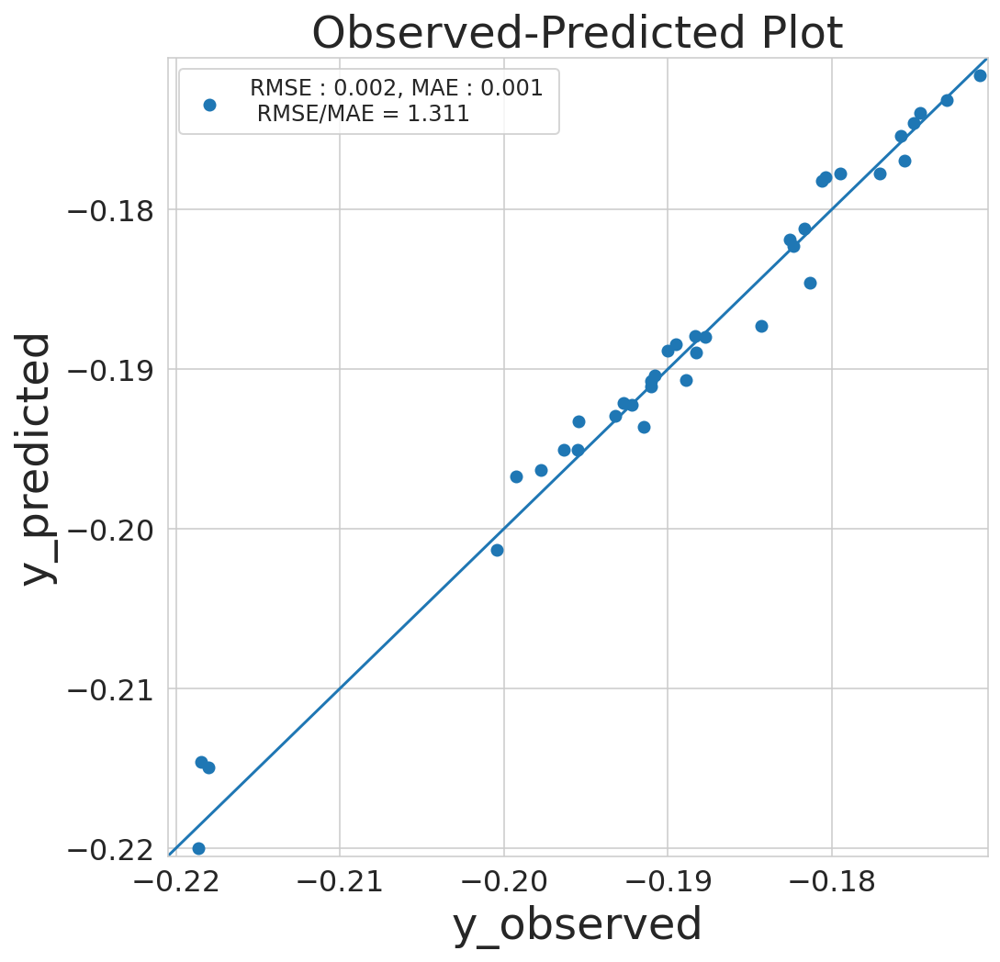

before
                          x         y
0              CPMGOriginal  0.014716
1        CPMGOriginalT2[ms]  0.162314
2      CPMGFreeWater[SSNMF]  0.000116
3     CPMGBoundWater[SSNMF]  0.003421
4         MSEComp1[MCR-ALS]  0.018101
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.001665
60        fr_benzene[RDKit]  0.001959
61       fr_bicyclic[RDKit]  0.039322
62          fr_ether[RDKit]  0.008459
63  fr_unbrch_alkane[RDKit]  0.004384

[64 rows x 2 columns]
after
                          x         y
0              CPMGOriginal  0.014716
1        CPMGOriginalT2[ms]  0.162314
2      CPMGFreeWater[SSNMF]  0.000116
3     CPMGBoundWater[SSNMF]  0.003421
4         MSEComp1[MCR-ALS]  0.018101
..                      ...       ...
59      fr_C_O_noCOO[RDKit]  0.001665
60        fr_benzene[RDKit]  0.001959
61       fr_bicyclic[RDKit]  0.039322
62          fr_ether[RDKit]  0.008459
63  fr_unbrch_alkane[RDKit]  0.004384

[64 rows x 2 columns]


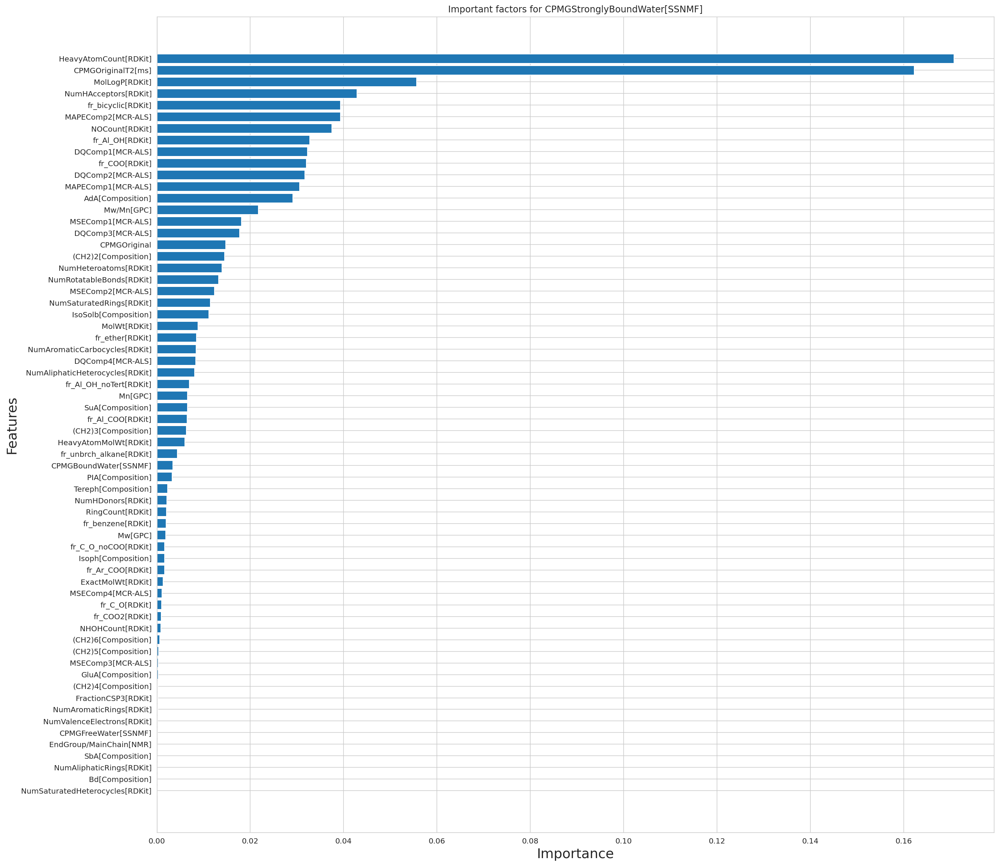

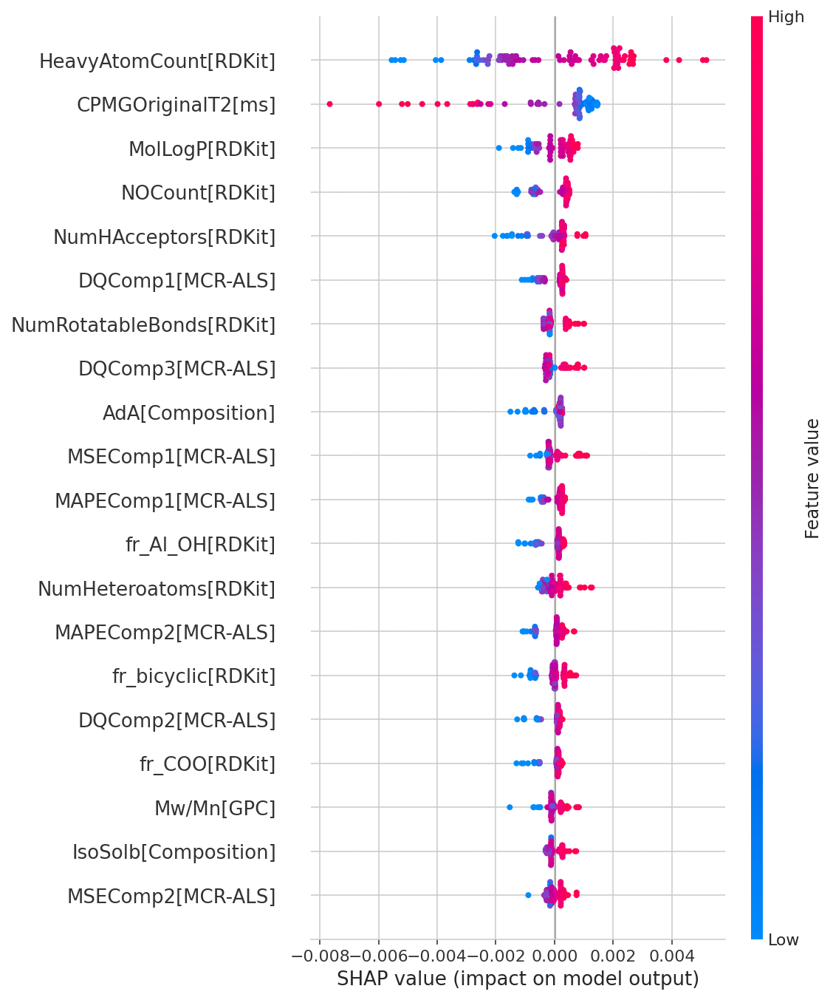

./data/oligomer_RF_20230211pyCPMGOriginal_s.csv
oligomer_RF_20230211pyCPMGOriginal_s
Best params: {'max_depth': None, 'max_features': None, 'n_estimators': 10}
Best Score: 0.6352529966217173
0.9508252094834253
0.7884569013250904
RMSE 学習: 0.00, テスト: 0.01
R^2 学習: 0.95, テスト: 0.79


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


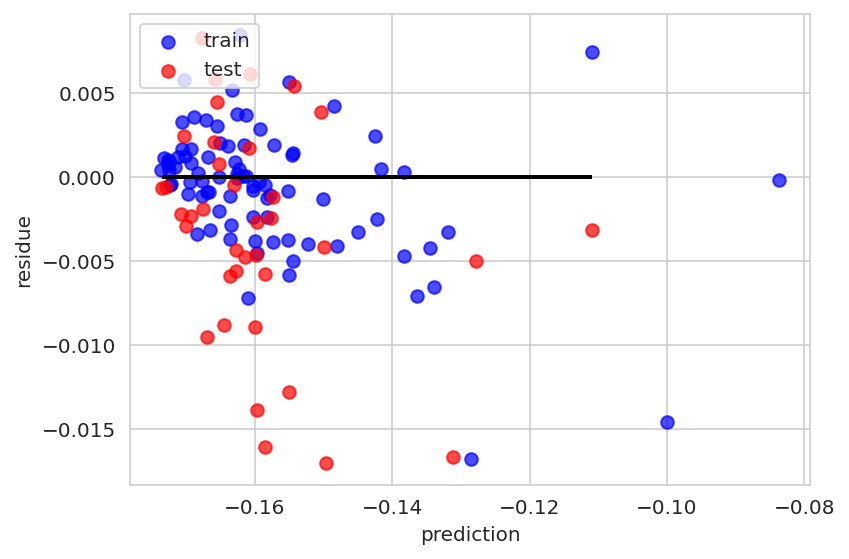

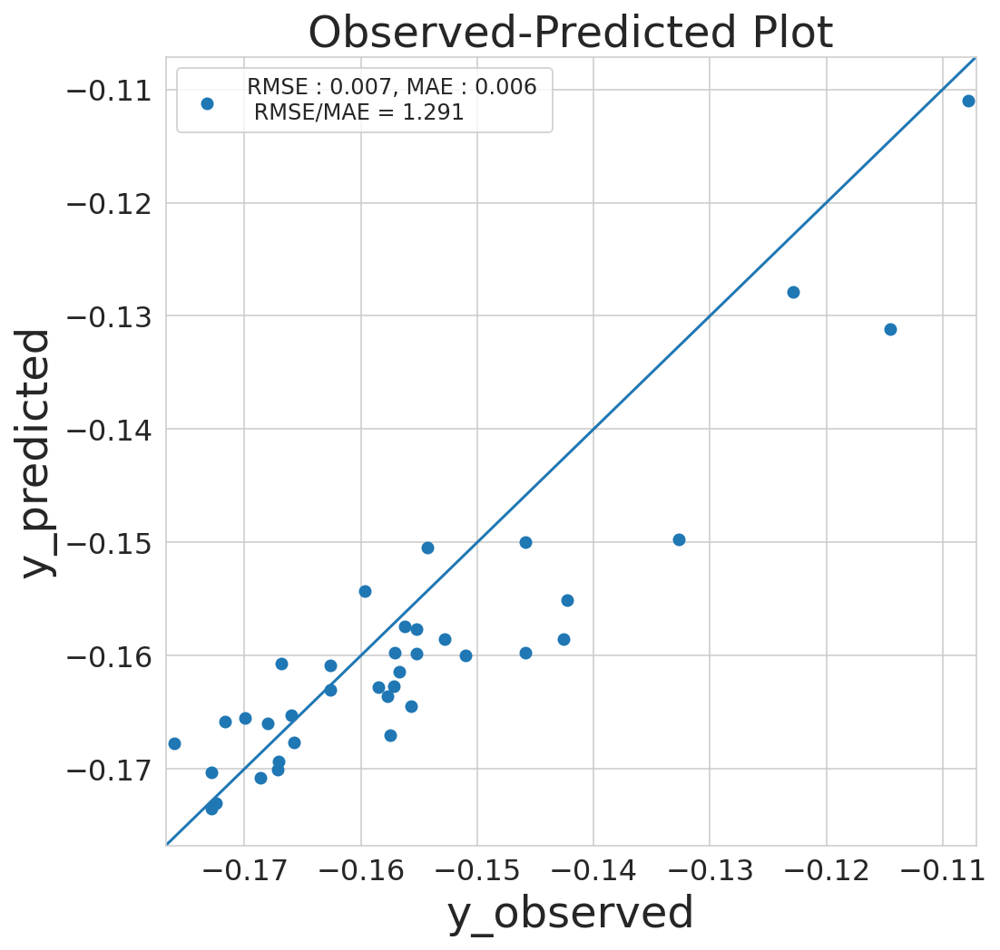

before
                                  x         y
0                 MSEComp1[MCR-ALS]  0.000129
1                 MSEComp2[MCR-ALS]  0.000163
2                 MSEComp3[MCR-ALS]  0.000015
3                 MSEComp4[MCR-ALS]  0.000589
4                  DQComp1[MCR-ALS]  0.000720
5                  DQComp2[MCR-ALS]  0.000008
6                  DQComp3[MCR-ALS]  0.000009
7                  DQComp4[MCR-ALS]  0.000210
8                MAPEComp1[MCR-ALS]  0.000235
9                MAPEComp2[MCR-ALS]  0.000276
10          EndGroup/MainChain[NMR]  0.000006
11                          Mw[GPC]  0.003134
12                          Mn[GPC]  0.004162
13                       Mw/Mn[GPC]  0.014824
14                 SuA[Composition]  0.016807
15                 AdA[Composition]  0.101458
16                 PIA[Composition]  0.000122
17                GluA[Composition]  0.002030
18                 SbA[Composition]  0.004906
19              Tereph[Composition]  0.014363
20               Isoph[Comp

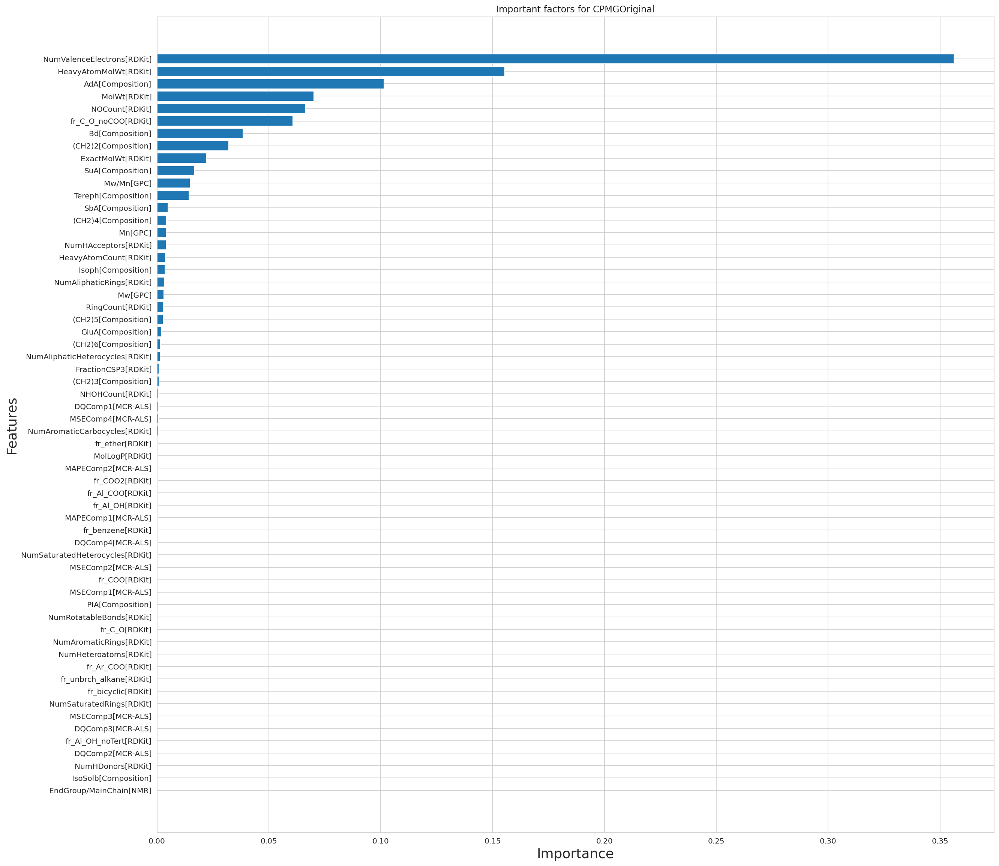

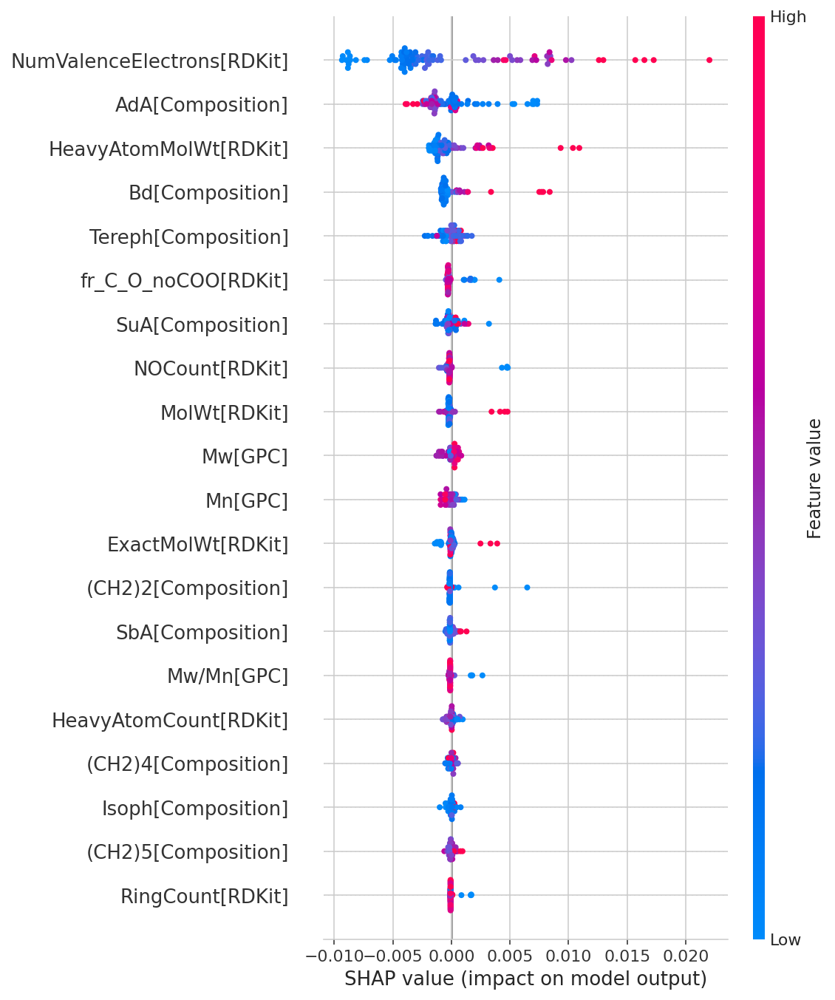

./data/oligomer_RF_20230211pyCPMGOriginalT2.csv
oligomer_RF_20230211pyCPMGOriginalT2
Best params: {'max_depth': 40, 'max_features': 'sqrt', 'n_estimators': 3}
Best Score: 0.8781887582211347
0.9504482135337239
0.913066864061952
RMSE 学習: 0.18, テスト: 0.21
R^2 学習: 0.95, テスト: 0.91


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


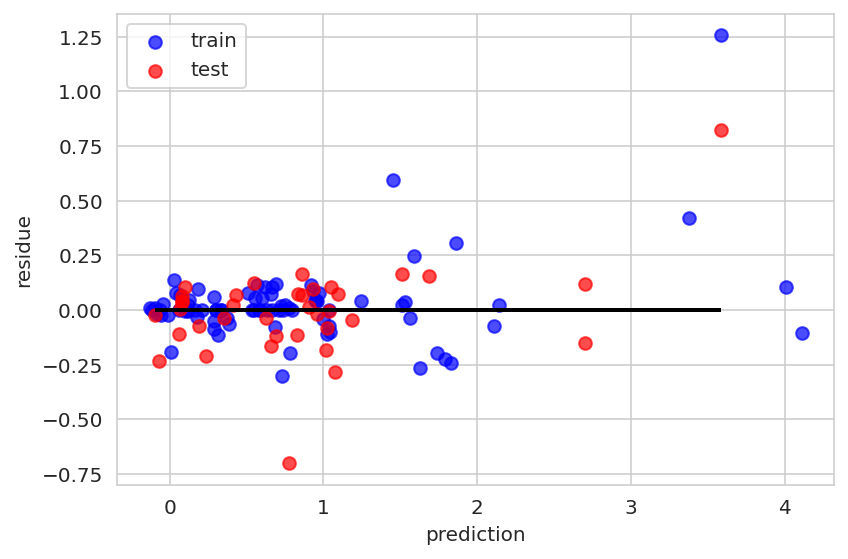

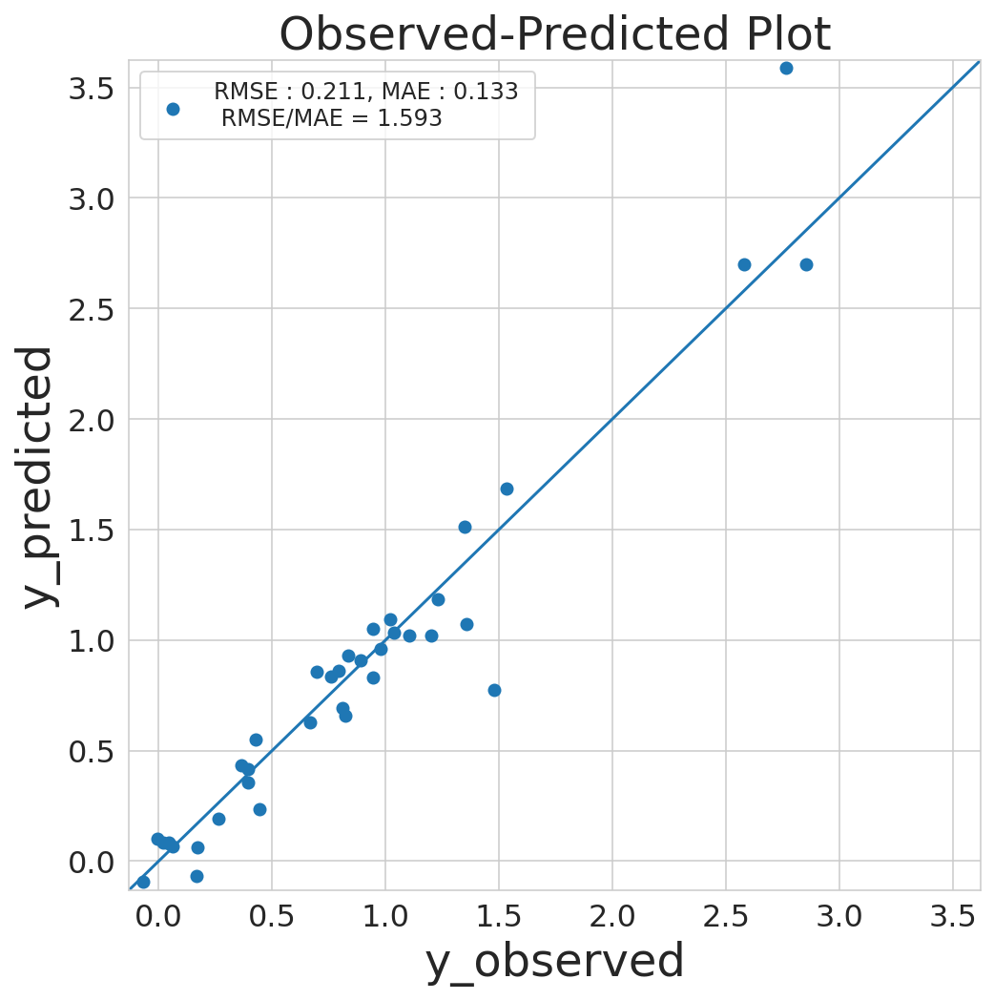

before
                                x         y
0                    CPMGOriginal  0.005978
1            CPMGFreeWater[SSNMF]  0.001349
2           CPMGBoundWater[SSNMF]  0.001353
3   CPMGStronglyBoundWater[SSNMF]  0.000986
4               MSEComp1[MCR-ALS]  0.000000
..                            ...       ...
59            fr_C_O_noCOO[RDKit]  0.214032
60              fr_benzene[RDKit]  0.000069
61             fr_bicyclic[RDKit]  0.021568
62                fr_ether[RDKit]  0.000455
63        fr_unbrch_alkane[RDKit]  0.002939

[64 rows x 2 columns]
after
                                  x             y
0                      CPMGOriginal  5.977582e-03
1              CPMGFreeWater[SSNMF]  1.349292e-03
2             CPMGBoundWater[SSNMF]  1.353036e-03
3     CPMGStronglyBoundWater[SSNMF]  9.862544e-04
5                 MSEComp2[MCR-ALS]  1.943646e-05
6                 MSEComp3[MCR-ALS]  1.498124e-02
7                 MSEComp4[MCR-ALS]  5.318980e-05
8                  DQComp1[MCR-ALS] 

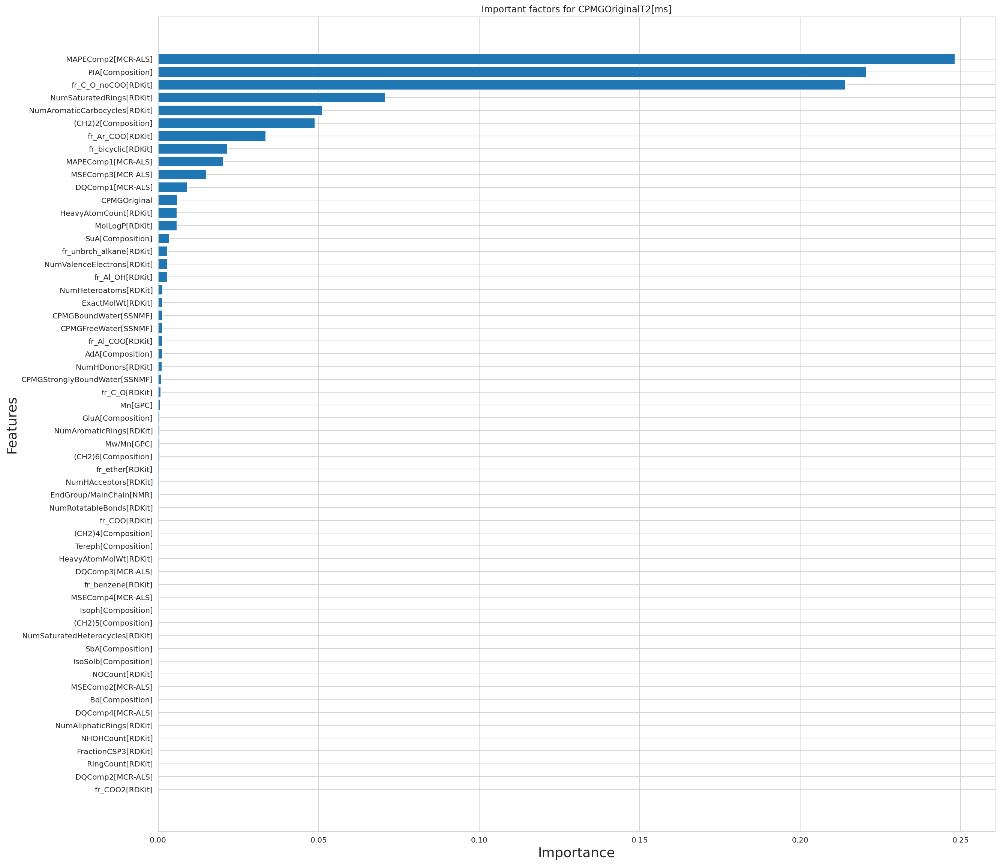

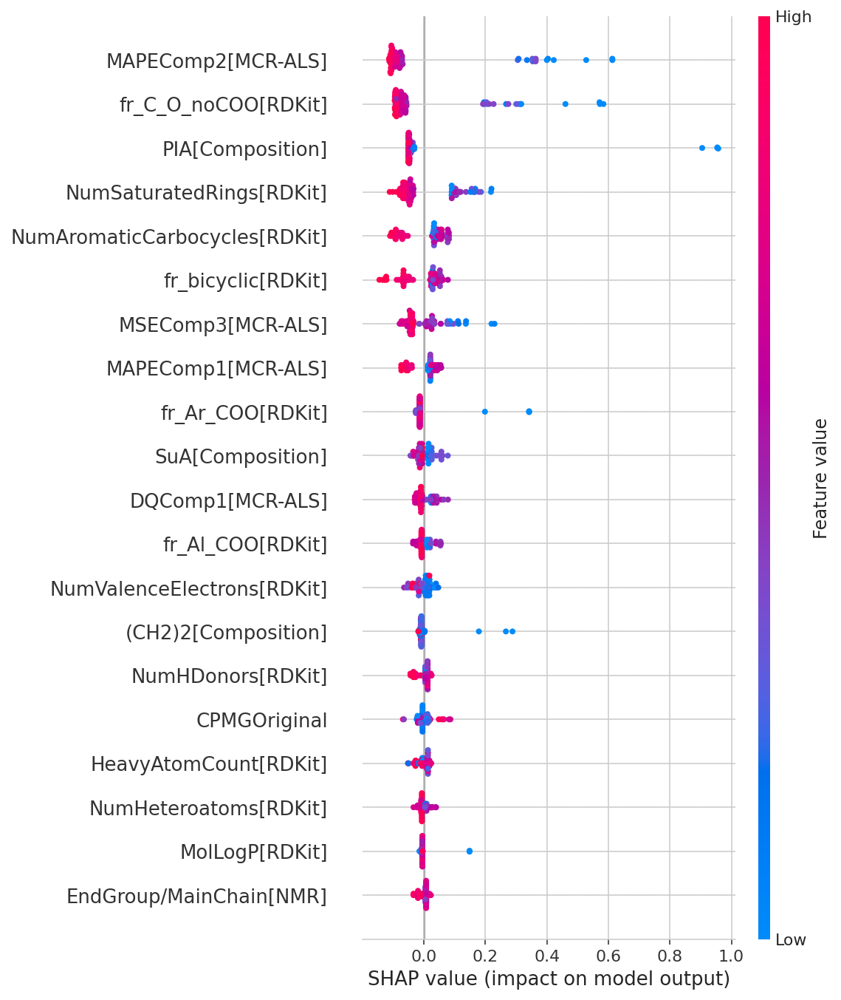

./data/oligomer_RF_20230211pyCPMGStronglyBoundWater_s.csv
oligomer_RF_20230211pyCPMGStronglyBoundWater_s
Best params: {'max_depth': 3, 'max_features': None, 'n_estimators': 100}
Best Score: 0.7138437429712733


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


0.930258310166409
0.7907309078226886
RMSE 学習: 0.00, テスト: 0.00
R^2 学習: 0.93, テスト: 0.79


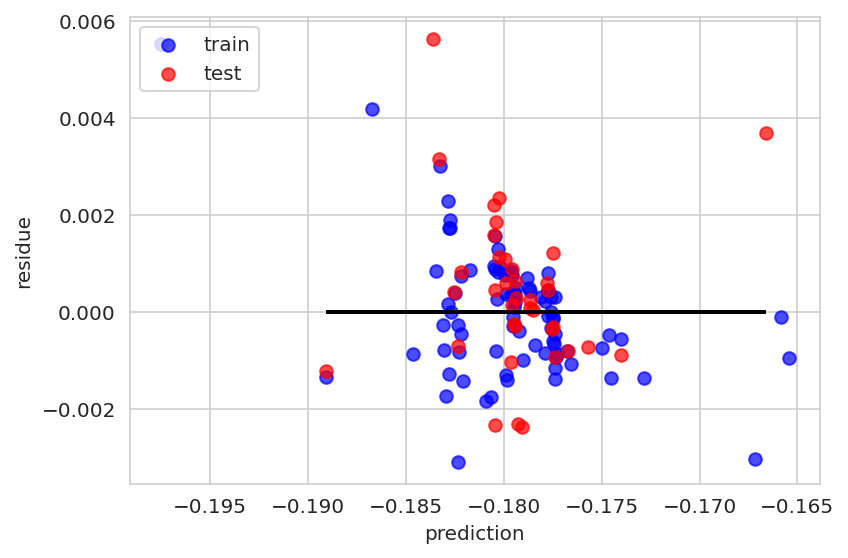

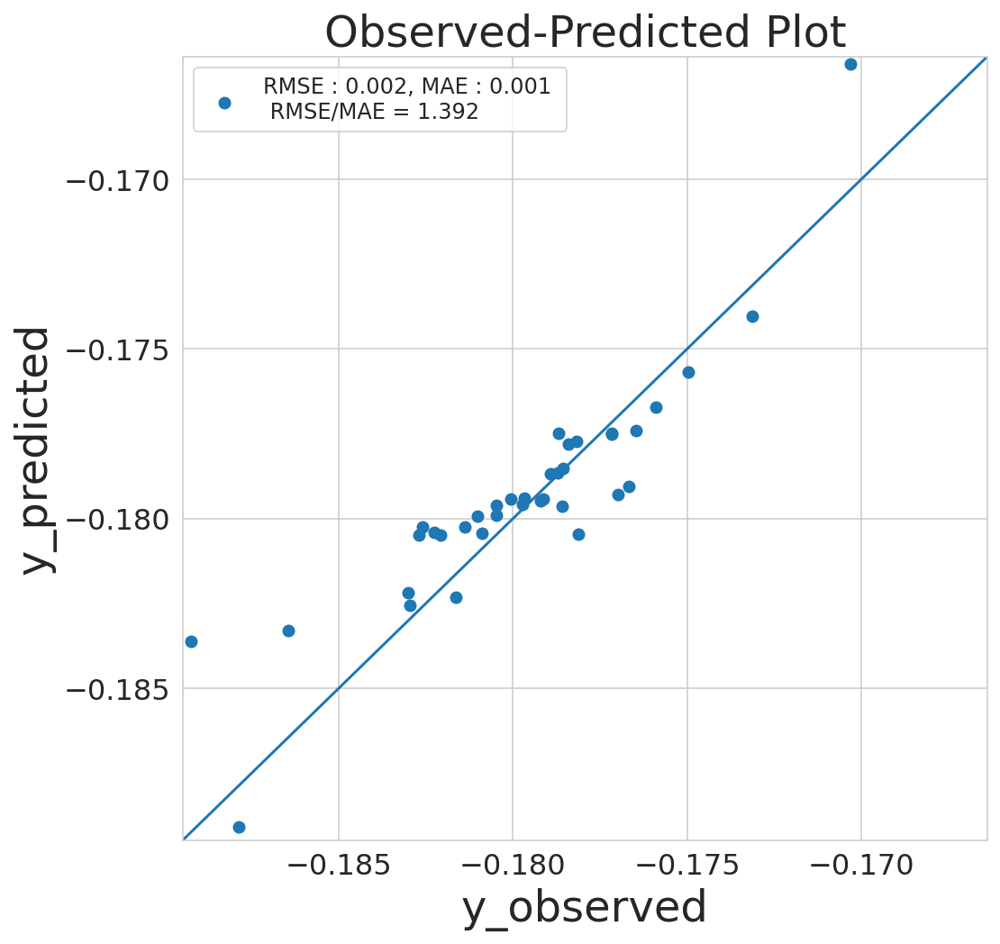

before
                                  x             y
0                 MSEComp1[MCR-ALS]  3.020546e-04
1                 MSEComp2[MCR-ALS]  5.852062e-02
2                 MSEComp3[MCR-ALS]  7.071471e-03
3                 MSEComp4[MCR-ALS]  9.569981e-03
4                  DQComp1[MCR-ALS]  8.016579e-02
5                  DQComp2[MCR-ALS]  8.548139e-03
6                  DQComp3[MCR-ALS]  9.828693e-04
7                  DQComp4[MCR-ALS]  4.163978e-02
8                MAPEComp1[MCR-ALS]  1.881541e-02
9                MAPEComp2[MCR-ALS]  2.303823e-02
10          EndGroup/MainChain[NMR]  2.849446e-05
11                          Mw[GPC]  2.186899e-02
12                          Mn[GPC]  6.188981e-02
13                       Mw/Mn[GPC]  5.126588e-02
14                 SuA[Composition]  4.034218e-02
15                 AdA[Composition]  2.590583e-03
16                 PIA[Composition]  0.000000e+00
17                GluA[Composition]  3.156203e-03
18                 SbA[Composition]  1.2426

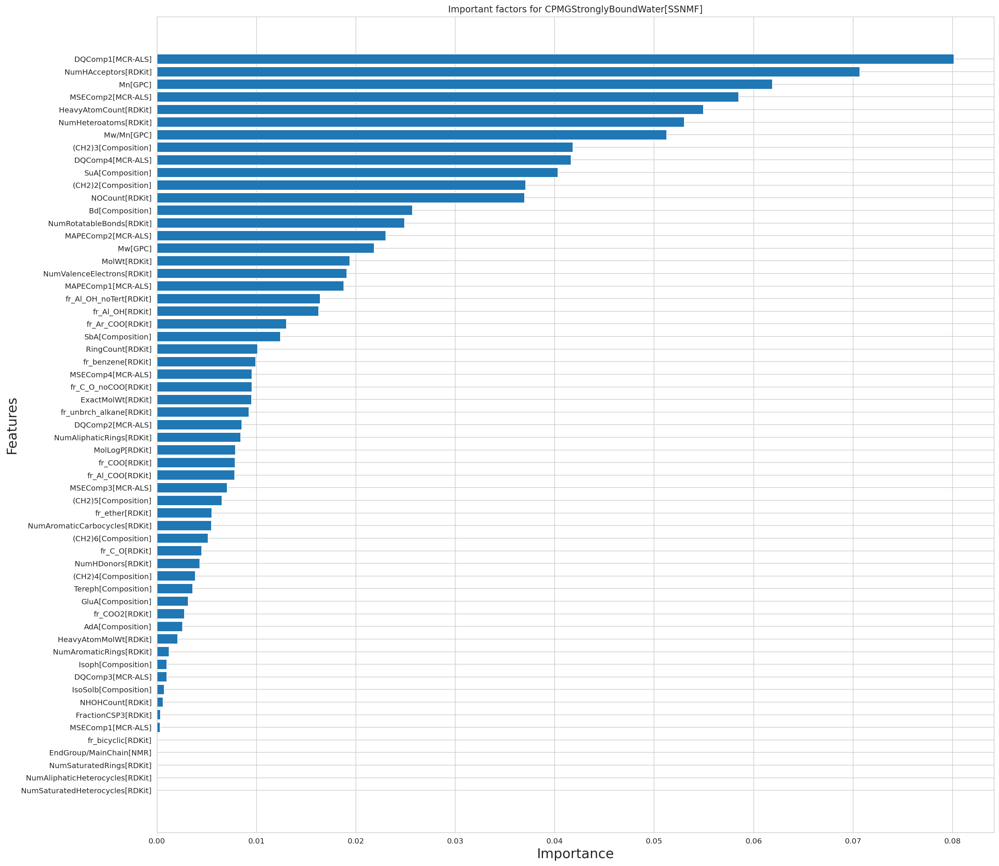

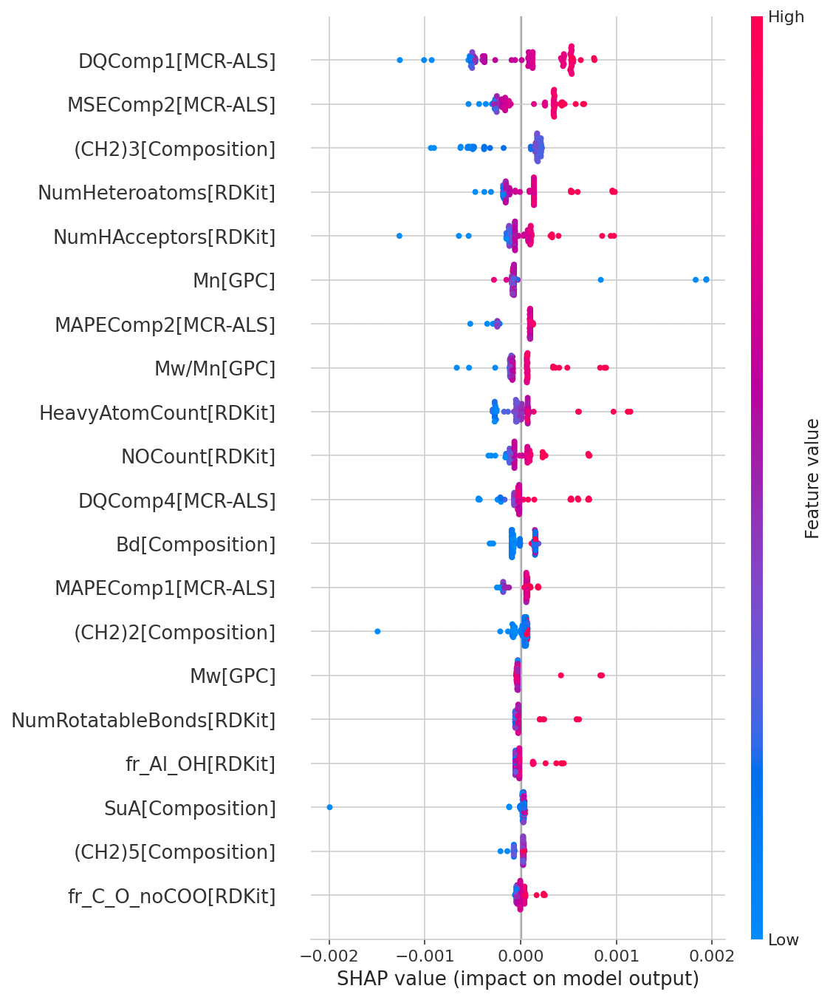

./data/oligomer_RF_20230211pyCPMGFreeWater.csv
oligomer_RF_20230211pyCPMGFreeWater
Best params: {'max_depth': 50, 'max_features': None, 'n_estimators': 20}
Best Score: 0.7956944260547825
0.9590254487473796
0.8534813042969438
RMSE 学習: 0.00, テスト: 0.00
R^2 学習: 0.96, テスト: 0.85


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


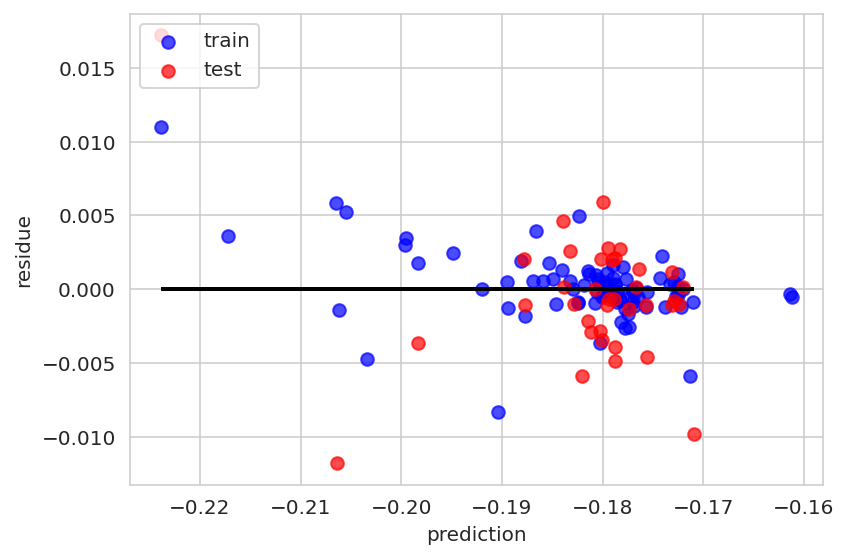

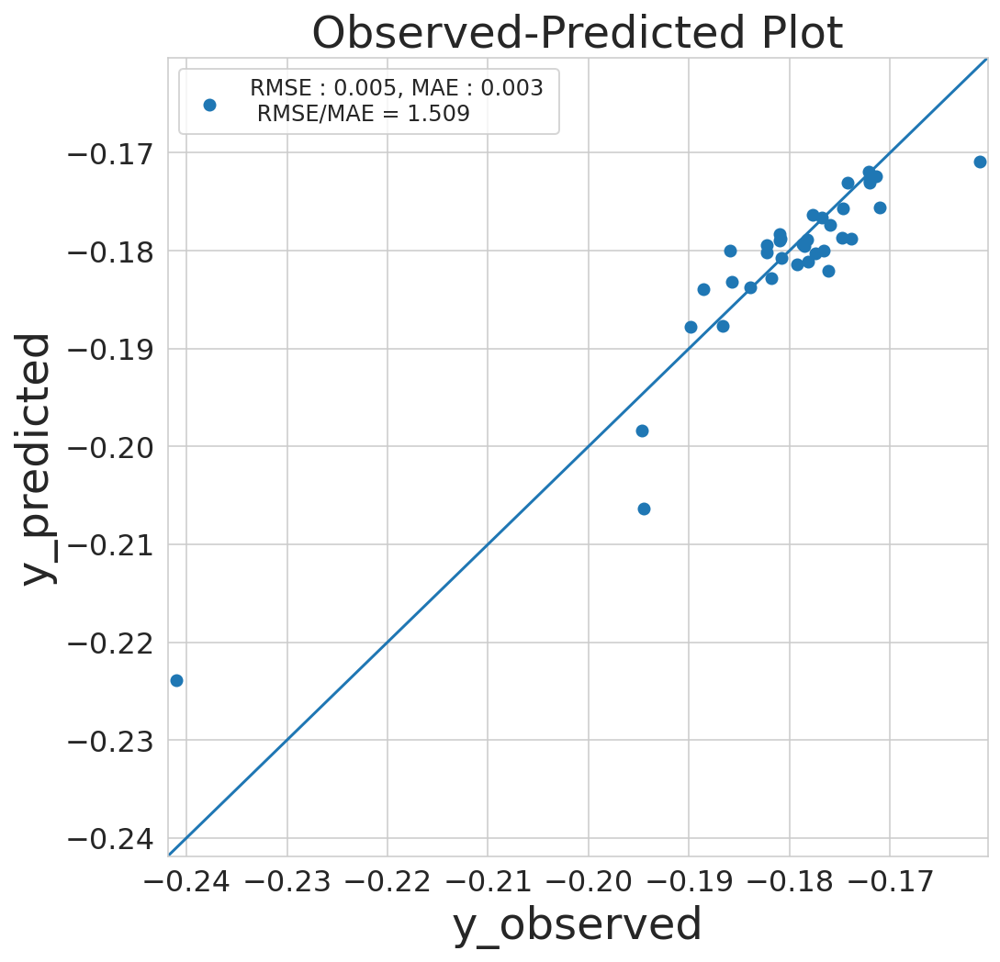

before
                                x         y
0                    CPMGOriginal  0.030441
1              CPMGOriginalT2[ms]  0.032064
2           CPMGBoundWater[SSNMF]  0.021704
3   CPMGStronglyBoundWater[SSNMF]  0.000840
4               MSEComp1[MCR-ALS]  0.000483
..                            ...       ...
59            fr_C_O_noCOO[RDKit]  0.000082
60              fr_benzene[RDKit]  0.000013
61             fr_bicyclic[RDKit]  0.000383
62                fr_ether[RDKit]  0.000245
63        fr_unbrch_alkane[RDKit]  0.000167

[64 rows x 2 columns]
after
                                x         y
0                    CPMGOriginal  0.030441
1              CPMGOriginalT2[ms]  0.032064
2           CPMGBoundWater[SSNMF]  0.021704
3   CPMGStronglyBoundWater[SSNMF]  0.000840
4               MSEComp1[MCR-ALS]  0.000483
..                            ...       ...
59            fr_C_O_noCOO[RDKit]  0.000082
60              fr_benzene[RDKit]  0.000013
61             fr_bicyclic[RDKit]  0.000

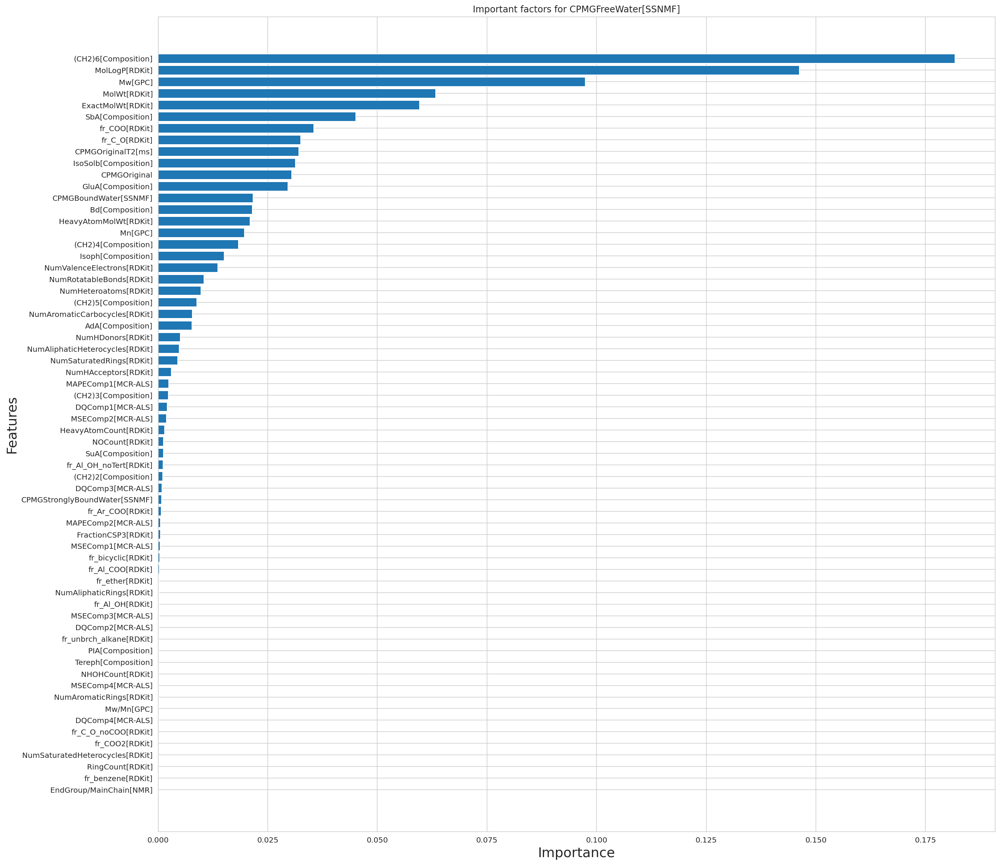

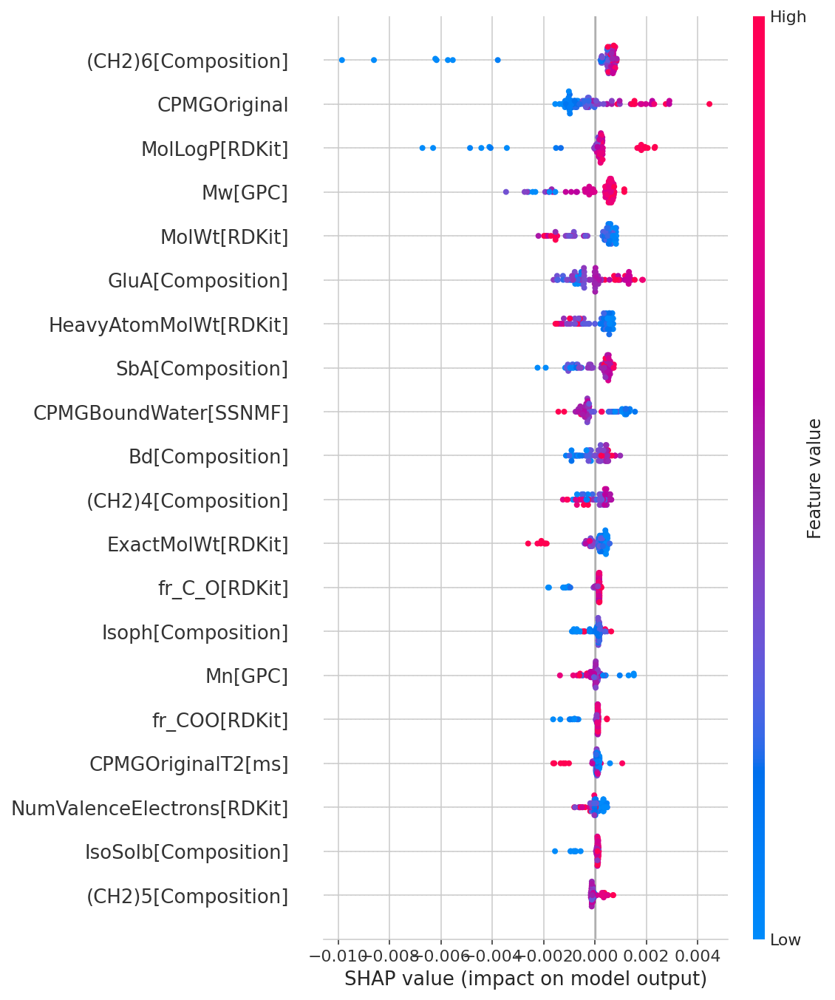

./data/oligomer_RF_20230211pyCPMGOriginalT2_s.csv
oligomer_RF_20230211pyCPMGOriginalT2_s
Best params: {'max_depth': 25, 'max_features': 'auto', 'n_estimators': 5}
Best Score: 0.886812315677543
0.9685952164015591
0.8929036355493257
RMSE 学習: 0.14, テスト: 0.23
R^2 学習: 0.97, テスト: 0.89


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


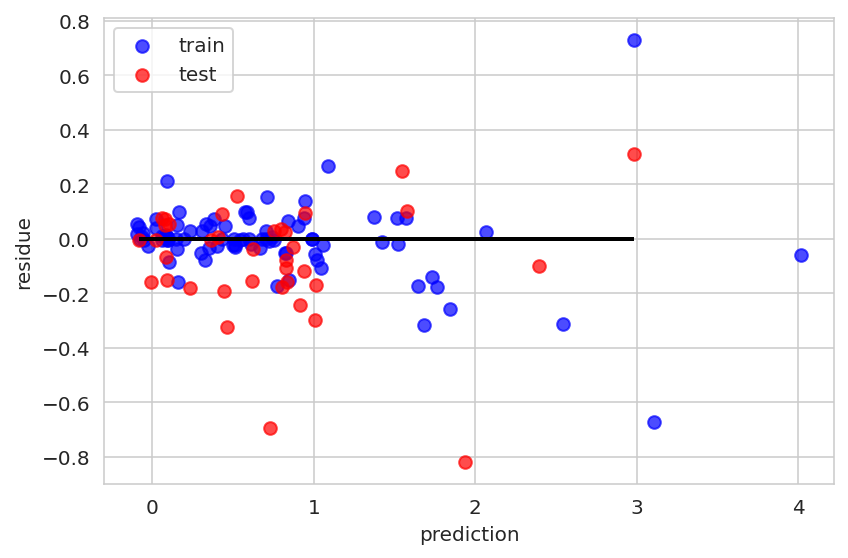

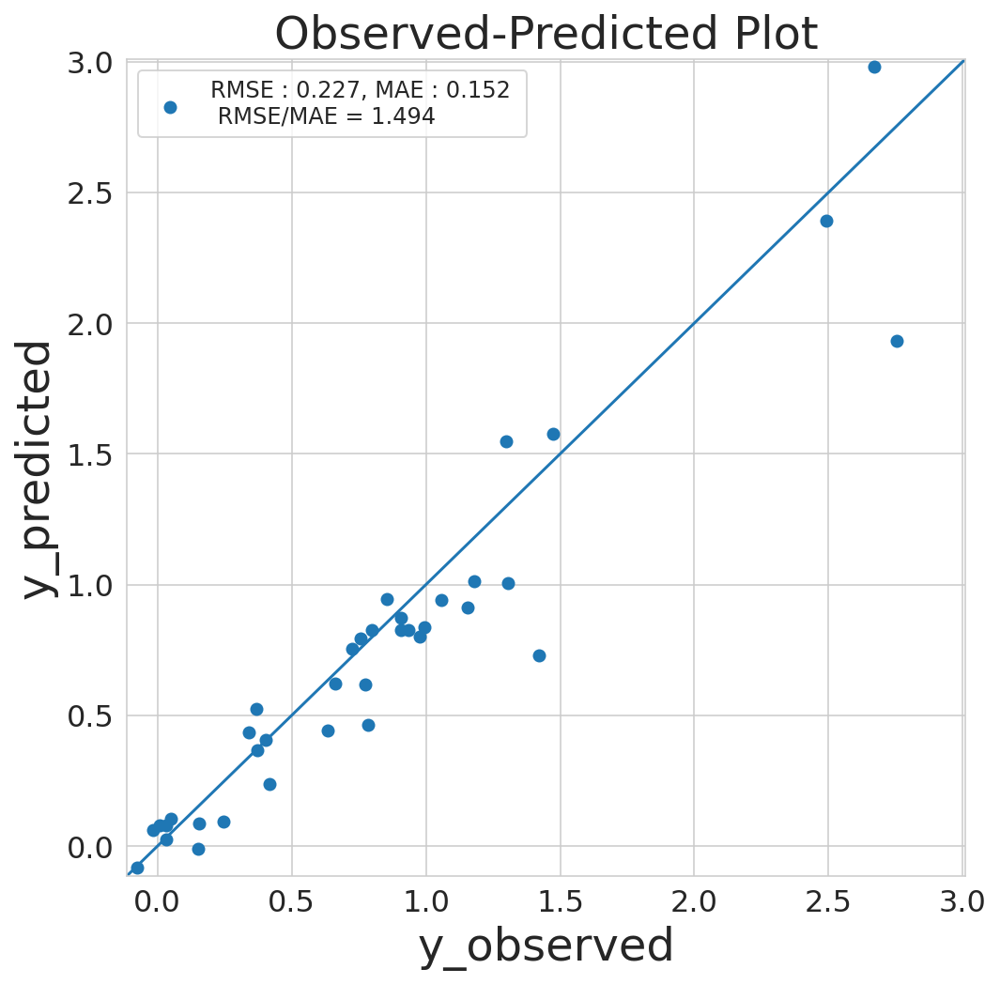

before
                                  x             y
0                 MSEComp1[MCR-ALS]  4.089729e-05
1                 MSEComp2[MCR-ALS]  2.208956e-07
2                 MSEComp3[MCR-ALS]  2.320148e-04
3                 MSEComp4[MCR-ALS]  4.330441e-03
4                  DQComp1[MCR-ALS]  3.485644e-06
5                  DQComp2[MCR-ALS]  0.000000e+00
6                  DQComp3[MCR-ALS]  1.168236e-02
7                  DQComp4[MCR-ALS]  1.915759e-04
8                MAPEComp1[MCR-ALS]  1.689414e-01
9                MAPEComp2[MCR-ALS]  1.992483e-05
10          EndGroup/MainChain[NMR]  7.622596e-07
11                          Mw[GPC]  8.767518e-04
12                          Mn[GPC]  4.174215e-03
13                       Mw/Mn[GPC]  2.246007e-02
14                 SuA[Composition]  2.997415e-02
15                 AdA[Composition]  3.375725e-03
16                 PIA[Composition]  8.945649e-07
17                GluA[Composition]  6.004471e-04
18                 SbA[Composition]  2.3819

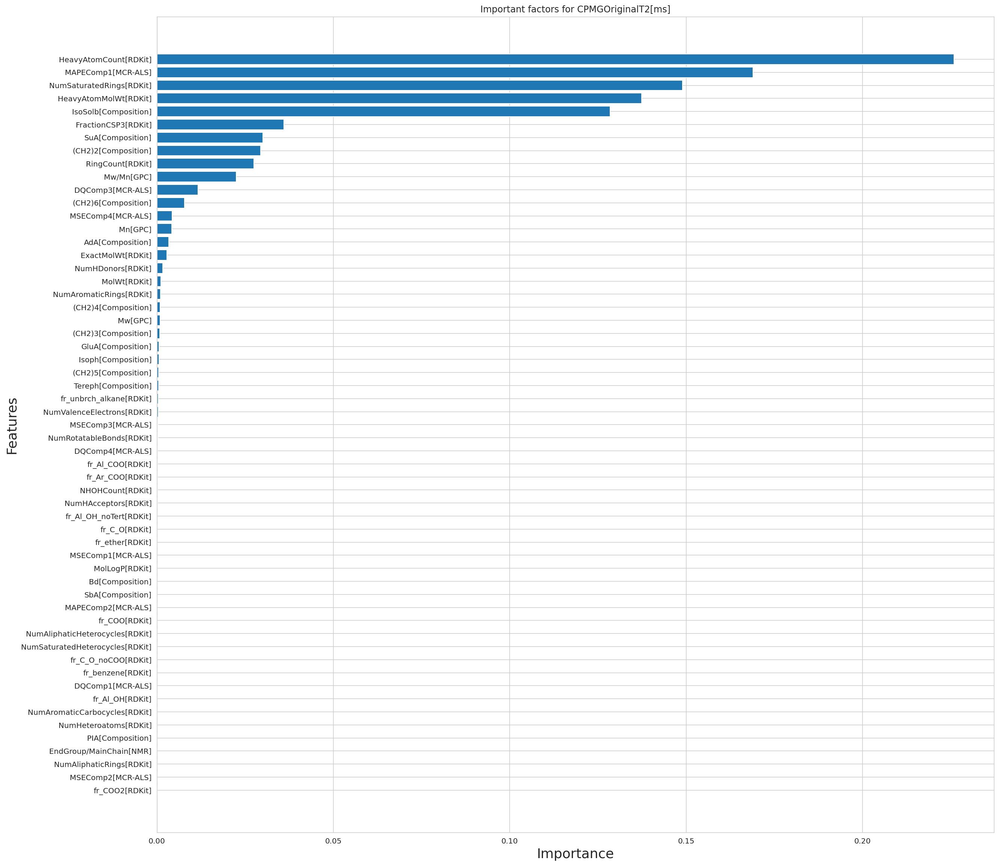

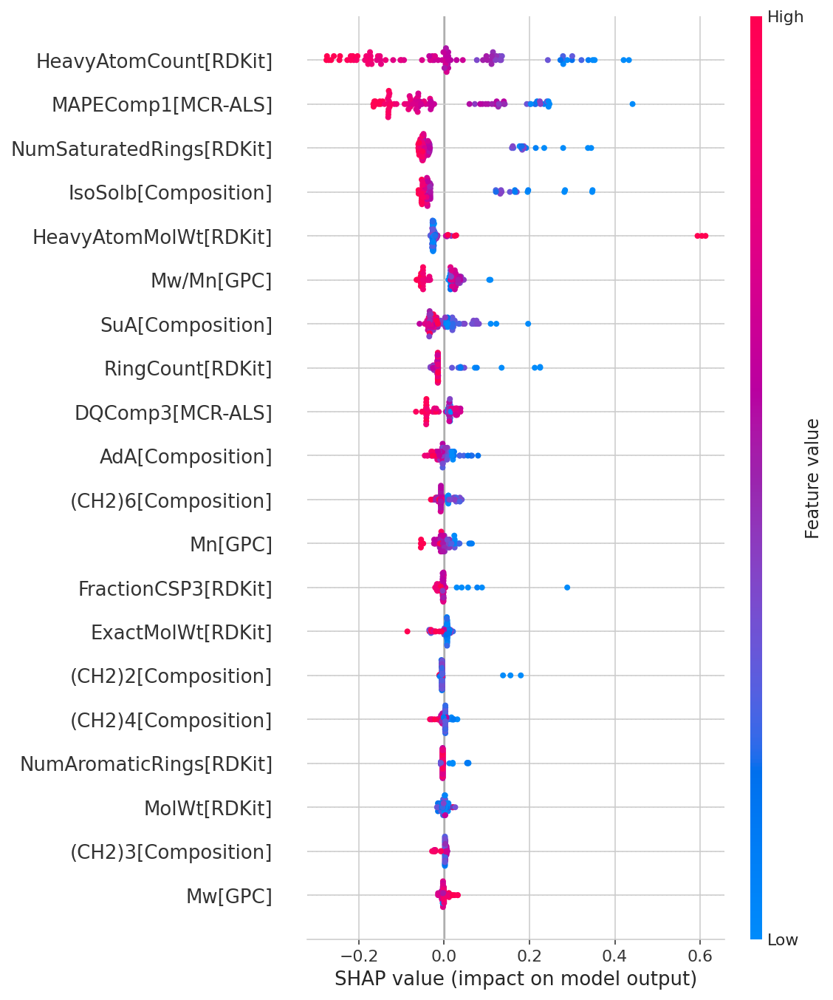

./data/oligomer_RF_20230211pyCPMGBoundWater.csv
oligomer_RF_20230211pyCPMGBoundWater
Best params: {'max_depth': 15, 'max_features': 'auto', 'n_estimators': 50}
Best Score: 0.6731999852263731
0.9371829771156441
0.7080154558334795
RMSE 学習: 0.00, テスト: 0.00
R^2 学習: 0.94, テスト: 0.71


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


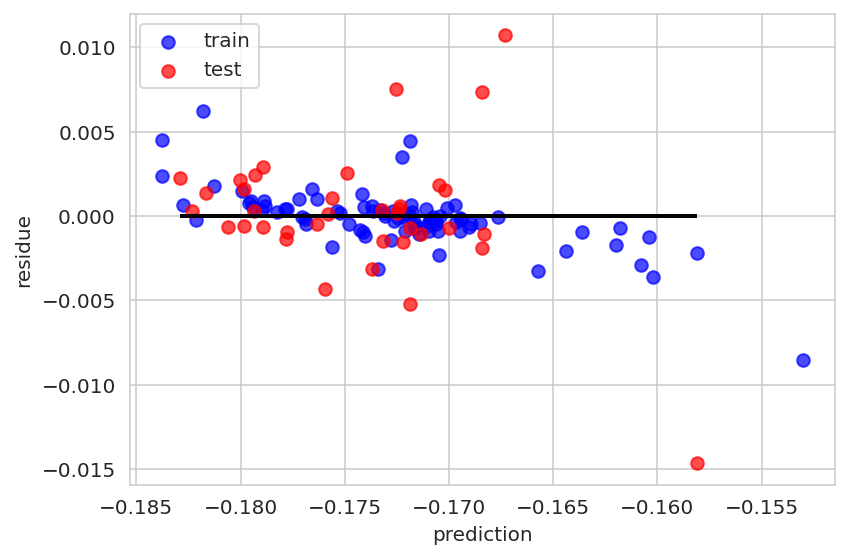

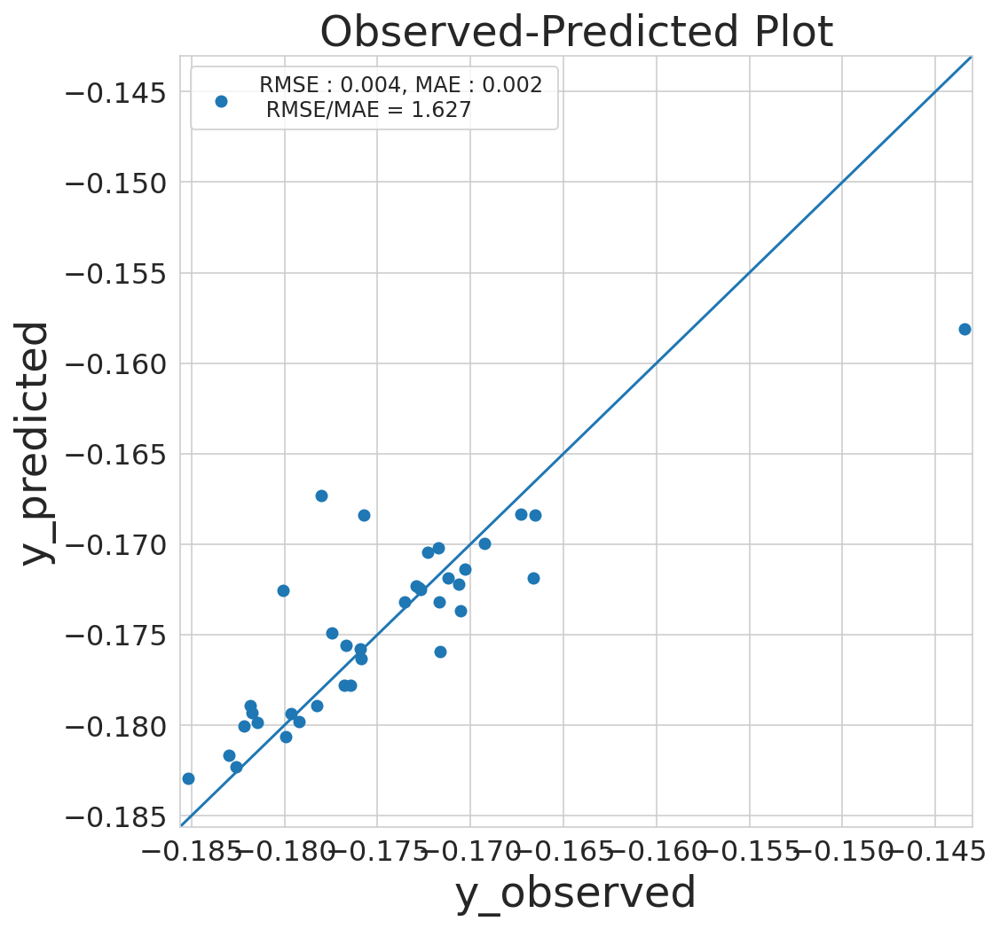

before
                                x         y
0                    CPMGOriginal  0.047153
1              CPMGOriginalT2[ms]  0.010807
2            CPMGFreeWater[SSNMF]  0.127569
3   CPMGStronglyBoundWater[SSNMF]  0.043845
4               MSEComp1[MCR-ALS]  0.000223
..                            ...       ...
59            fr_C_O_noCOO[RDKit]  0.000158
60              fr_benzene[RDKit]  0.000282
61             fr_bicyclic[RDKit]  0.001805
62                fr_ether[RDKit]  0.000388
63        fr_unbrch_alkane[RDKit]  0.000515

[64 rows x 2 columns]
after
                                x         y
0                    CPMGOriginal  0.047153
1              CPMGOriginalT2[ms]  0.010807
2            CPMGFreeWater[SSNMF]  0.127569
3   CPMGStronglyBoundWater[SSNMF]  0.043845
4               MSEComp1[MCR-ALS]  0.000223
..                            ...       ...
59            fr_C_O_noCOO[RDKit]  0.000158
60              fr_benzene[RDKit]  0.000282
61             fr_bicyclic[RDKit]  0.001

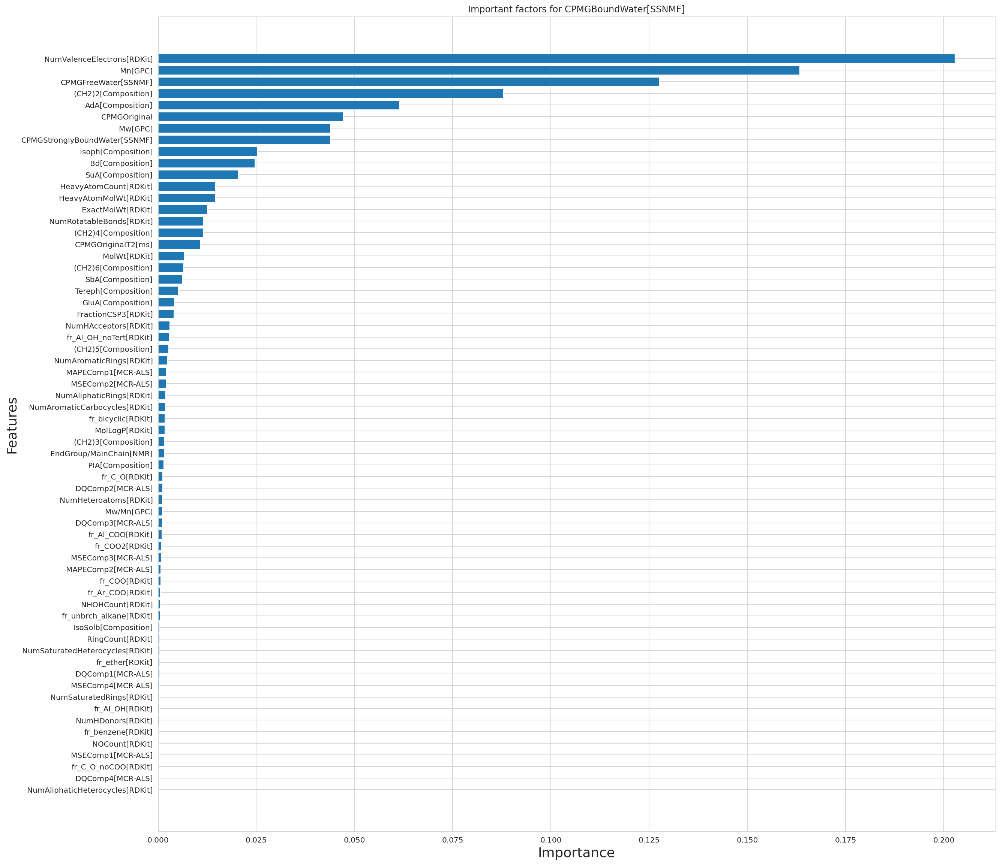

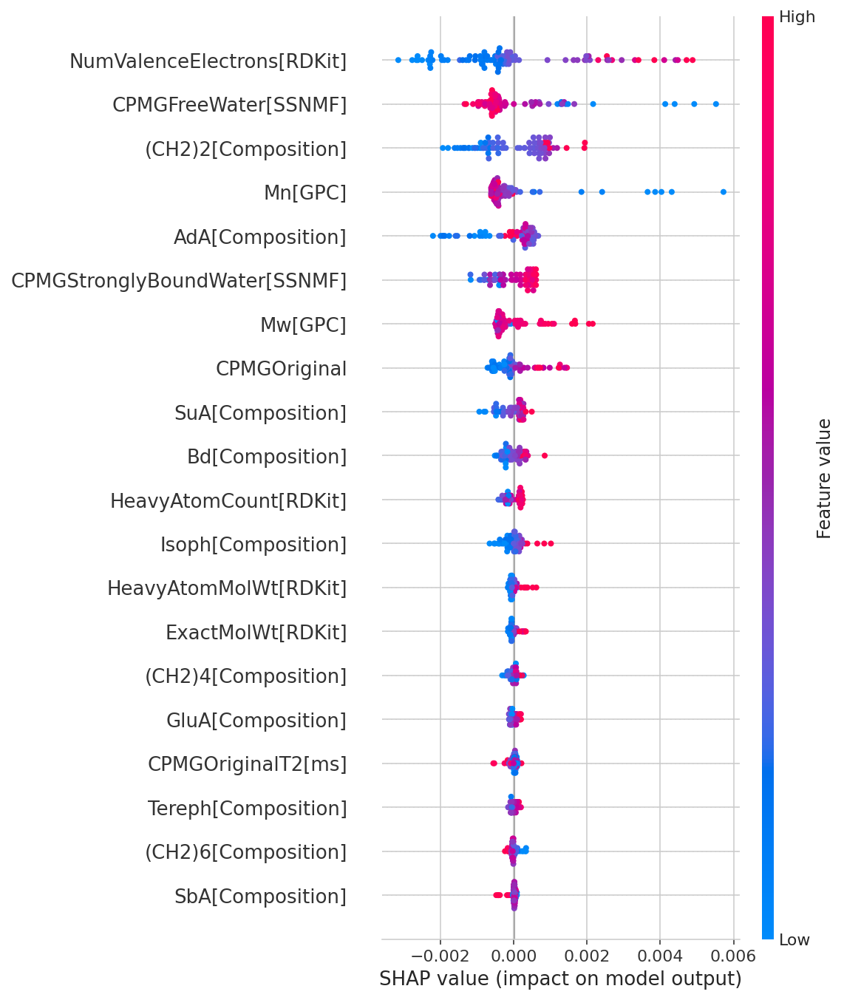

./data/oligomer_RF_20230211pyCPMGBoundWater_s.csv
oligomer_RF_20230211pyCPMGBoundWater_s
Best params: {'max_depth': 100, 'max_features': 'auto', 'n_estimators': 10}
Best Score: 0.7609500978632475
0.9351542664660668
0.7703960483289958
RMSE 学習: 0.00, テスト: 0.01
R^2 学習: 0.94, テスト: 0.77


Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


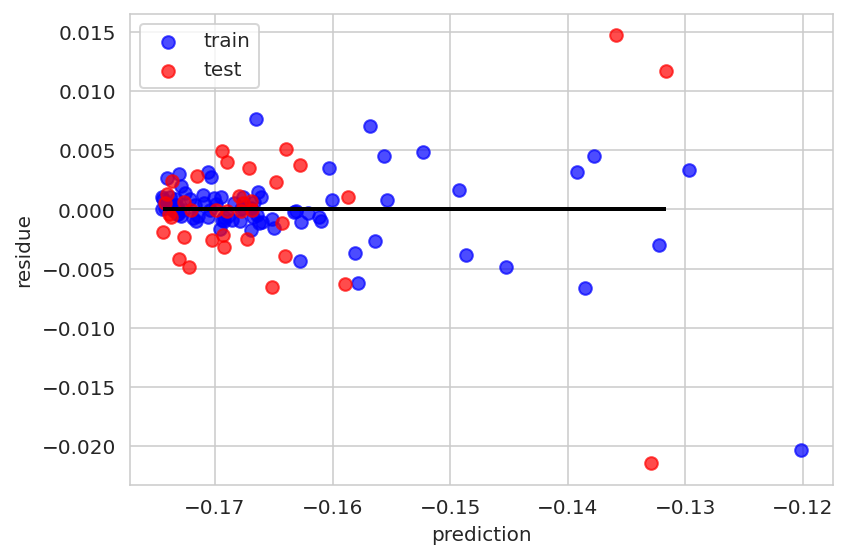

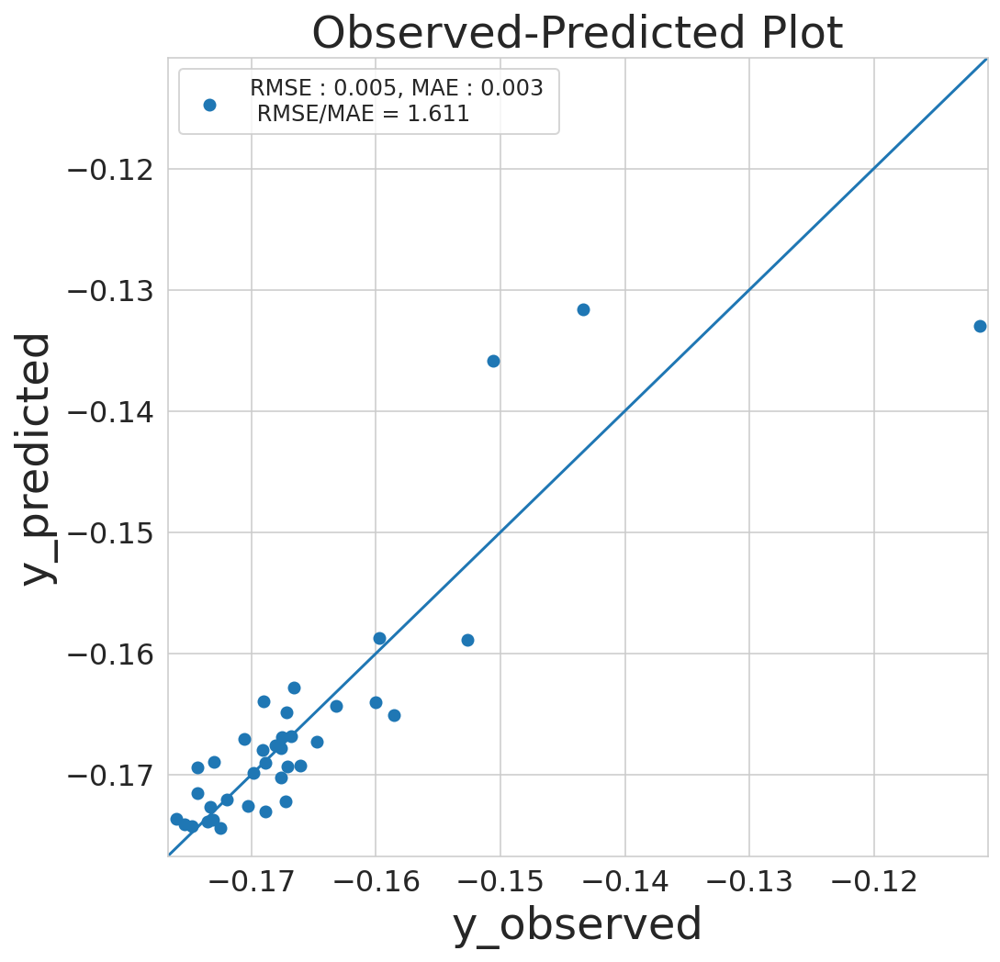

before
                                  x             y
0                 MSEComp1[MCR-ALS]  1.093612e-04
1                 MSEComp2[MCR-ALS]  0.000000e+00
2                 MSEComp3[MCR-ALS]  1.732201e-07
3                 MSEComp4[MCR-ALS]  4.625431e-04
4                  DQComp1[MCR-ALS]  4.236756e-05
5                  DQComp2[MCR-ALS]  3.655592e-06
6                  DQComp3[MCR-ALS]  9.824174e-05
7                  DQComp4[MCR-ALS]  3.381401e-05
8                MAPEComp1[MCR-ALS]  2.563028e-04
9                MAPEComp2[MCR-ALS]  5.420533e-04
10          EndGroup/MainChain[NMR]  9.780544e-05
11                          Mw[GPC]  1.060037e-03
12                          Mn[GPC]  2.264639e-02
13                       Mw/Mn[GPC]  2.523394e-04
14                 SuA[Composition]  9.158685e-03
15                 AdA[Composition]  9.086875e-02
16                 PIA[Composition]  6.533959e-05
17                GluA[Composition]  2.691831e-03
18                 SbA[Composition]  1.7551

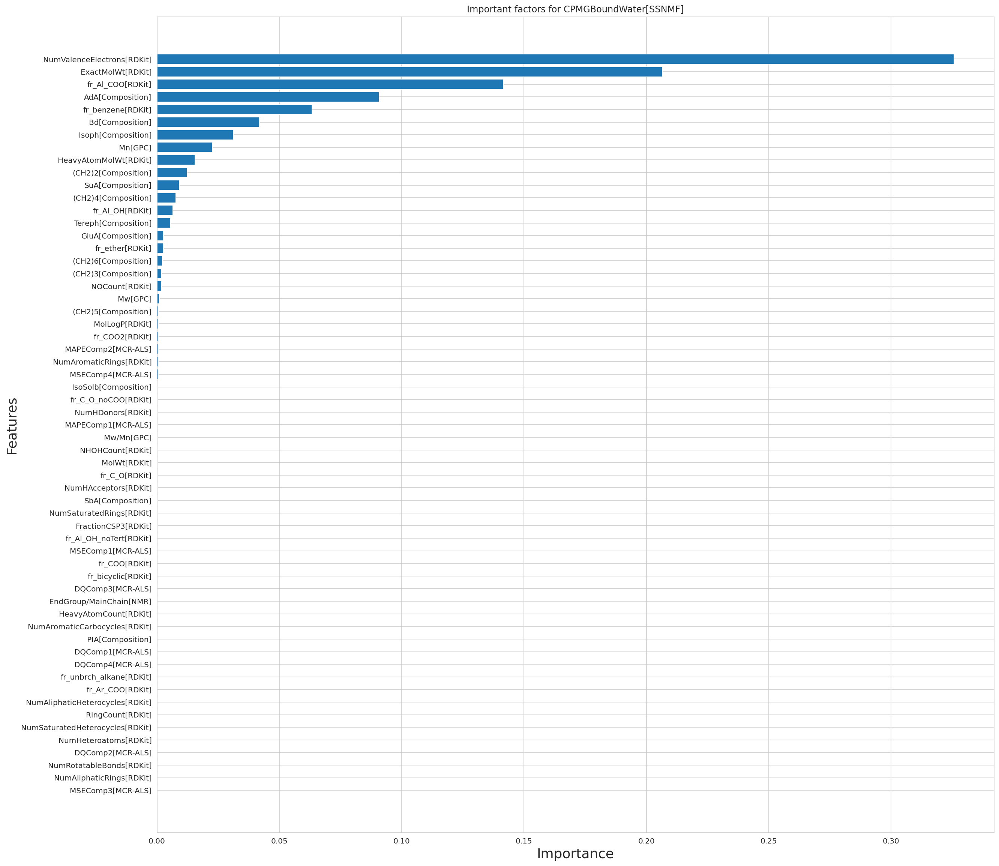

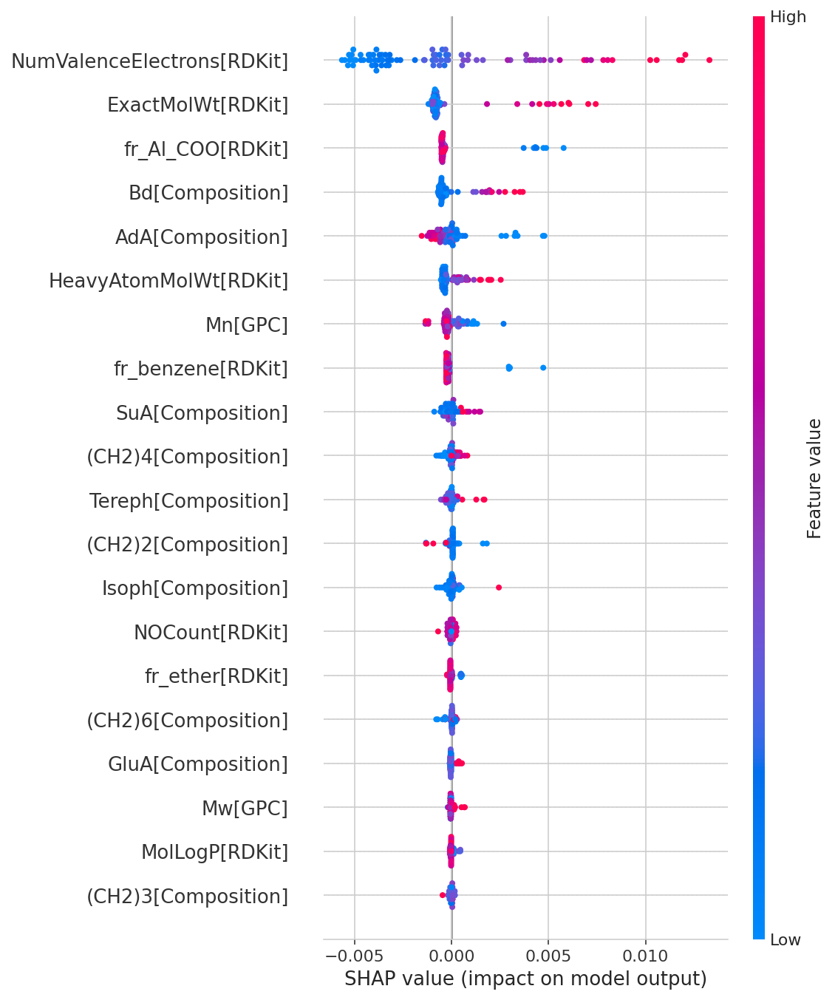

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import os
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn import metrics
import scipy.stats

sns.set_style('whitegrid',{'linestyle.grid':'--'})
%matplotlib inline

import glob
files = glob.glob("./data/*")
for file in files:
    print(file)
    print(os.path.basename(file).split('.', 1)[0])
    from scipy import stats
    df = pd.read_csv(file, index_col=0)
    df = df.apply(stats.zscore, axis=1)

    # 説明変数と目的変数
    X=df.iloc[:,1:]#data.data
    y=df.iloc[:,0]#data.target

    # 訓練データ(train)と検証データ(test)にわける 
    X_train,X_test,y_train,y_test=train_test_split(X.values,y.values,test_size=0.3,random_state=1)

    from sklearn.ensemble        import RandomForestClassifier
    from sklearn.model_selection import GridSearchCV
    from sklearn.model_selection import train_test_split

    # 学習データ＆テストデータ分割
    #X_train, X_test,  Y_train, Y_test = train_test_split(dataset[features_reg],dataset[target_reg],test_size=0.3, random_state=3)

    # グリッドサーチによるハイパーパラメータ探索候補設定
    # 今回はRandomForestClassifierのパラメータが対象(値は任意に設定)
    parameters = {  
        'n_estimators': [3,5,10, 20, 30, 50, 100],     # 用意する決定木モデルの数
        'max_features': ('sqrt', 'log2','auto', None),  # ランダムに指定する特徴量の数
        'max_depth':    (3,5,10,15,25,30,40,50,100, None),     # 決定木のノード深さの制限値
    }

    # モデルインスタンス
    model = RandomForestRegressor()#RandomForestClassifier()

    # ハイパーパラメータチューニング(グリッドサーチのコンストラクタにモデルと辞書パラメータを指定)
    gridsearch = GridSearchCV(estimator = model,        # モデル
                              param_grid = parameters,  # チューニングするハイパーパラメータ
                              scoring = "r2"      # スコアリング
                            )


    # 演算実行
    gridsearch.fit(X_train, y_train)

    # グリッドサーチの結果から得られた最適なパラメータ候補を確認
    print('Best params: {}'.format(gridsearch.best_params_)) 
    print('Best Score: {}'.format(gridsearch.best_score_))

    clf = RandomForestRegressor(n_estimators = gridsearch.best_params_['n_estimators'], # 用意する決定木モデルの数
                                  max_features = gridsearch.best_params_['max_features'], # ランダムに指定する特徴量の数
                                  max_depth    = gridsearch.best_params_['max_depth'],    # 決定木のノード深さの制限値
                                  criterion='mse',                                       # 不純度評価指標の種類(ジニ係数）
                                  min_samples_leaf = 1,                                   # 1ノードの深さの最小値
                                  random_state = 0,                                       # 乱数シード
                                  )


    # モデルの作成
    #clf = DecisionTreeClassifier(max_depth=3) 
    #from sklearn.tree import DecisionTreeRegressor
    #clf = DecisionTreeRegressor(random_state=0) 
    # モデルの学習
    clf.fit(X_train, y_train)
    

    # 評価
    print(clf.score(X_train,y_train))
    print(clf.score(X_test,y_test))
    
    from sklearn.metrics import r2_score            # 決定係数
    from sklearn.metrics import mean_squared_error  # RMSE

    # 予測値(Train）
    y_train_pred = clf.predict(X_train)

    # 予測値（Test)
    y_test_pred = clf.predict(X_test)

    # 平均平方二乗誤差(RMSE)
    print('RMSE 学習: %.2f, テスト: %.2f' % (
            mean_squared_error(y_train, y_train_pred, squared=False), # 学習
            mean_squared_error(y_test, y_test_pred, squared=False)    # テスト
          ))

    # 決定係数(R^2)
    print('R^2 学習: %.2f, テスト: %.2f' % (
            r2_score(y_train, y_train_pred), # 学習
            r2_score(y_test, y_test_pred)    # テスト
          ))
    
    # 予測値と残差をプロット（学習データ）
    plt.scatter(y_train_pred,             # グラフのx値(予測値)  
                y_train_pred - y_train,   # グラフのy値(予測値と学習値の差)
                c='blue',                 # プロットの色
                marker='o',               # マーカーの種類
                s=40,                     # マーカーサイズ
                alpha=0.7,                # 透明度
                label='train')         # ラベルの文字


    # 予測値と残差をプロット（テストデータ）
    plt.scatter(y_test_pred,            
                y_test_pred - y_test, 
                c='red',
                marker='o', 
                s=40,
                alpha=0.7,
                label='test')

    # グラフの書式設定
    plt.xlabel('prediction')
    plt.ylabel('residue')
    plt.legend(loc='upper left')
    plt.hlines(y=0, xmin=np.amin(y_test_pred), xmax=np.amax(y_test_pred), lw=2, color='black')
    #plt.hlines(y=0, xmin=-20, xmax=60, lw=2, color='black')
    #plt.xlim([-20, 60])
    #plt.ylim([-50, 40])
    plt.tight_layout()
    plt.savefig("residue_"+os.path.basename(file).split('.', 1)[0]+".png")
    plt.show()

    # yyplot の実行例
    np.random.seed(0)
    y_obs = y_test#np.random.normal(size=(1000, 1))
    y_pred = y_test_pred#y_obs + np.random.normal(scale=0.3, size=(1000, 1))
    fig = yyplot(y_obs, y_pred)

    x = df.columns[1:] #特徴量名 ->['sepal length (cm)','sepal width (cm)','petal length (cm)','petal width (cm)']
    y = clf.feature_importances_ #特徴量の重要度
    df0 = pd.DataFrame({'x':x,'y':y})
    print('before')
    print(df0)

    df0 = remove_any_zero_row(df0)

    print('after')
    print(df0)

    # 可視化
    plot_sorted_bar(
        figsize=(20, 20),
        x=df0["x"].values, 
        y=df0["y"].values,
        title='Important factors for '+df.columns[0]
    )

    plt.show()
    import shap
    explainer = shap.TreeExplainer(clf, data=X_train)
    X_train_shap_values = explainer.shap_values(X_train)
    shap.summary_plot(shap_values=X_train_shap_values,
                  features=X_train,
                  show=False,
                  feature_names=df.columns[1:])
    plt.savefig("shap.png"+os.path.basename(file).split('.', 1)[0]+".png") # 画像を保存
    plt.show()
    """
    import graphviz
    from sklearn.tree import export_graphviz
    from sklearn import tree
    dot = tree.export_graphviz(clf.estimators_[0], filled=True, rounded=True, 
                          #class_names=['setosa', 'versicolor', 'virginica'],
                          feature_names=df.columns[1:],
                          out_file=None) 

    graph = graphviz.Source(dot) #DOT記法をレンダリング
    #graph #グラフを出力
    # 画像を保存
    # 拡張子はいらない
    graph.render("Tree_"+os.path.basename(file).split('.', 1)[0])

    # 画像を表示
    graph.view()
    #features_reg = ["Pclass", "Fare", "Sex_label", "Cabin_label", "Embarked_label", "Survived"]
    #target_reg = "Age"

    #tree_regressor = DecisionTreeRegressor(max_depth=3, random_state=random_state, criterion="absolute_error")
    #tree_regressor.fit(dataset[features_reg].values, dataset[target_reg].values)
    import dtreeviz
    viz_rmodel = dtreeviz.model(model=clf.estimators_[0], 
                                X_train=df.iloc[:,1:], 
                                y_train=df.iloc[:,0], 
                                feature_names=df.columns[1:], 
                                target_name=df.columns[0])
    viz_rmodel.view(orientation="LR")
    """



In [ ]:
import shap
explainer = shap.TreeExplainer(clf, data=X_train)
X_train_shap_values = explainer.shap_values(X_train)

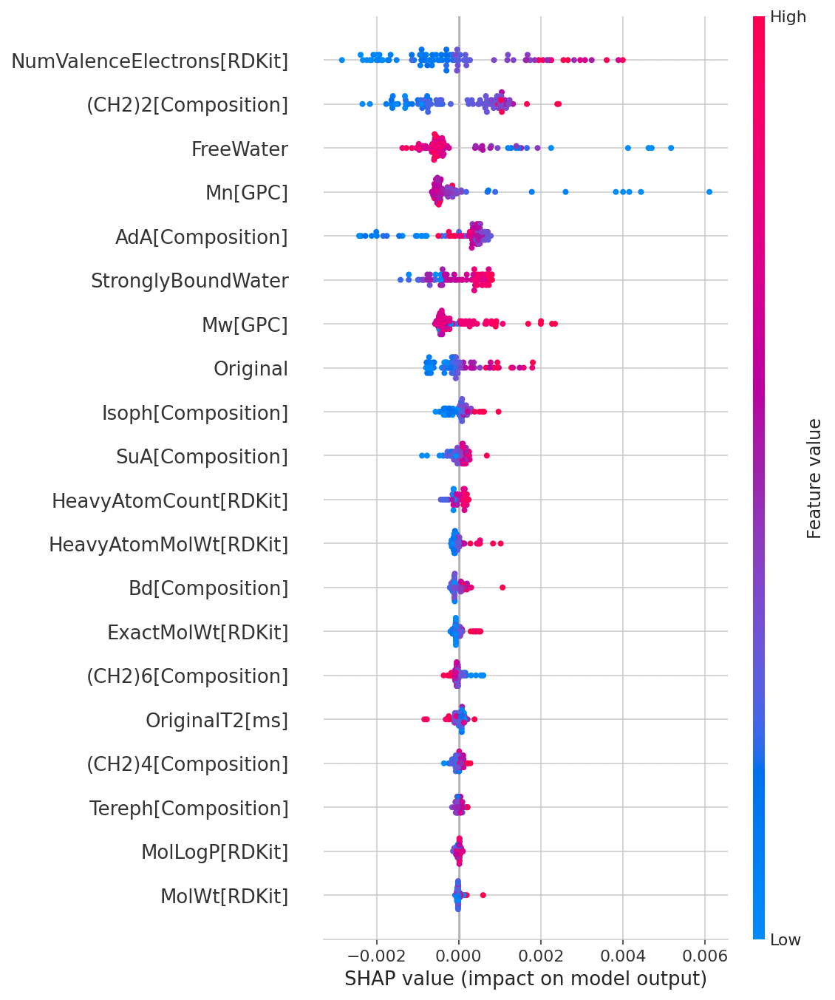

In [ ]:
shap.summary_plot(shap_values=X_train_shap_values,
                  features=X_train,
                  feature_names=df.columns[1:])

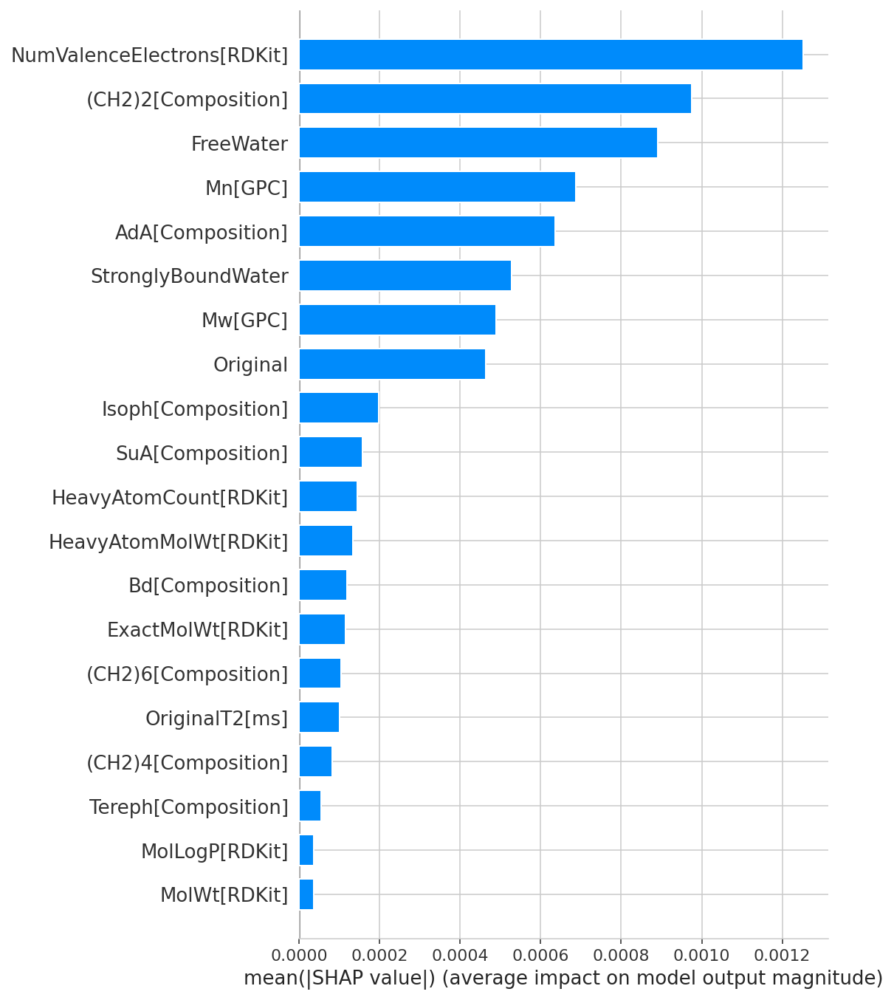

In [ ]:
shap.summary_plot(shap_values=X_train_shap_values,
                  features=X_train,
                  feature_names=df.columns[1:],
                  plot_type='bar')

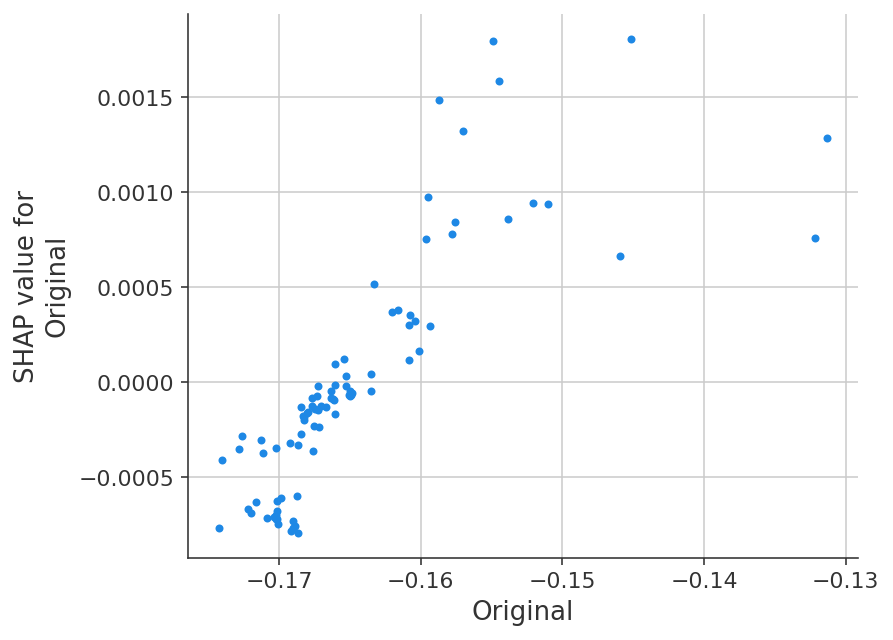

In [ ]:
shap.dependence_plot(ind='Original',
                     interaction_index=None,
                     shap_values=X_train_shap_values,
                     features=X_train,
                     feature_names=df.columns[1:])

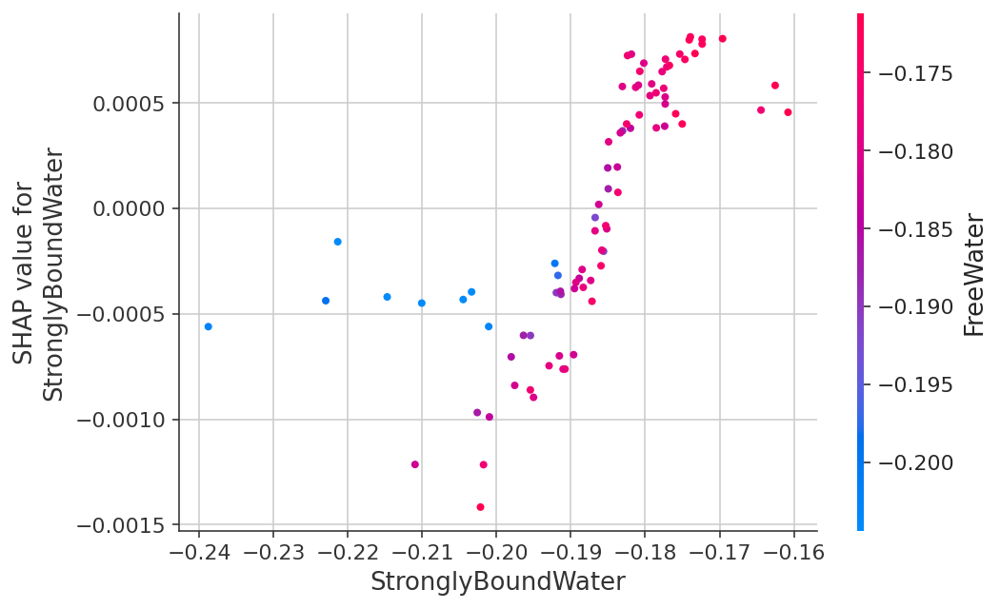

In [ ]:
shap.dependence_plot(ind='StronglyBoundWater',
                     interaction_index='FreeWater',
                     shap_values=X_train_shap_values,
                     features=X_train,
                     feature_names=df.columns[1:])

In [ ]:
explainer.expected_value

-0.17250729685091934

In [ ]:
shap.initjs()
#index : 何番目のサンプルの情報をplotするか指定
index = 0
shap.force_plot(base_value=explainer.expected_value,
                shap_values=X_train_shap_values[index],
                features=X_train[index,:]
                )

In [ ]:
shap.initjs()
shap.force_plot(base_value=explainer.expected_value,
                shap_values=X_train_shap_values,
                features=X_train)

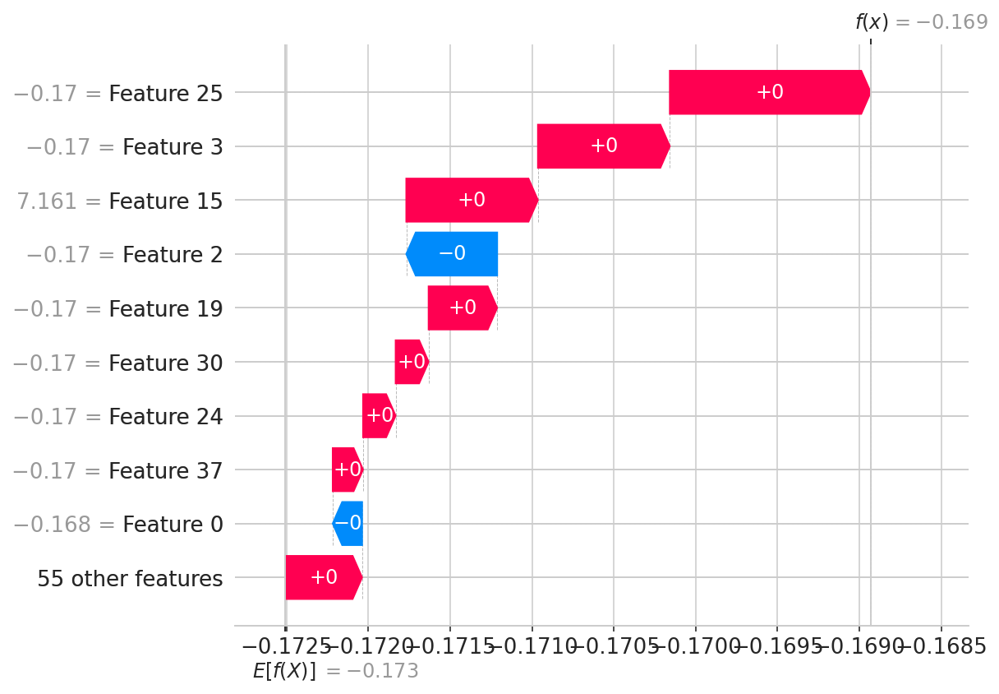

In [ ]:
X_train_shap_values_ex = explainer(X_train)
index = 10 #表示するサンプルのインデックスを指定
shap.waterfall_plot(X_train_shap_values_ex[10])

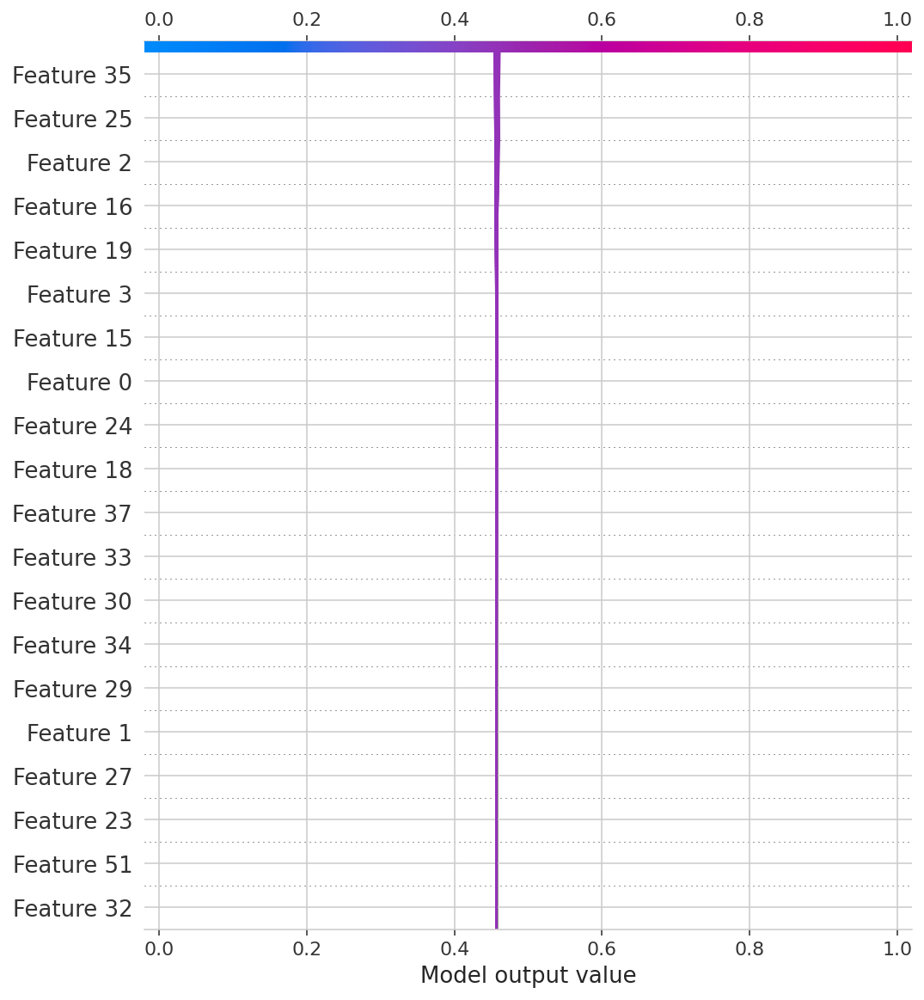

In [ ]:
expected_value = explainer.expected_value
shap.decision_plot(expected_value, shap_values=X_train_shap_values, link='logit')

In [ ]:
from lime.lime_tabular import LimeTabularExplainer
# 学習データやタスクの内容といった情報を渡してインスタンスを作成
explainer = LimeTabularExplainer(training_data=np.array(X_train),
                                 feature_names=df.columns[1:],
                                 training_labels=np.array(y_train),
                                 discretize_continuous=True,
                                 mode='regression',
                                 verbose=True,
                                )

# 予測値を返す関数の作成
predict_proba = lambda x: np.array(list(zip(1-clf.predict(x), clf.predict(x))))

# 線形モデルを使って近似させたときの切片と予測値、本来のモデルの予測値が出力
exp = explainer.explain_instance(
    X_train[0], 
    predict_proba, 
    num_features=X_train.shape[1]
)

exp.show_in_notebook(show_all=False)

Intercept 1.1709802136795586
Prediction_local [1.17719077]
Right: 1.176752402688265


In [ ]:
exp.show_in_notebook(show_all=True)

In [ ]:
from sklearn.linear_model import Ridge
import lightgbm as lgb
from sklearn.metrics import mean_squared_error as mse

In [ ]:
for file in files:
    print(file)
    print(os.path.basename(file).split('.', 1)[0])
    from scipy import stats
    df = pd.read_csv(file, index_col=0)
    df = df.apply(stats.zscore, axis=0)
    df

./data/oligomer_RF_20230125pyCPMGComp2.csv
oligomer_RF_20230125pyCPMGComp2
./data/oligomer_RF_20230125pyCPMGBoundWater.csv
oligomer_RF_20230125pyCPMGBoundWater
./data/oligomer_RF_20230125pyCPMGComp1.csv
oligomer_RF_20230125pyCPMGComp1
./data/oligomer_RF_20230125pyCPMGComp3.csv
oligomer_RF_20230125pyCPMGComp3
./data/oligomer_RF_20230125pyCPMGComp4.csv
oligomer_RF_20230125pyCPMGComp4
./data/oligomer_RF_20230125pyCPMGFreeWater.csv
oligomer_RF_20230125pyCPMGFreeWater


In [ ]:
df.iloc[:,0]

O001   -1.111083
O002   -0.617569
O003    0.095447
O004   -0.842255
O005   -0.940896
          ...   
O119   -1.111067
O120   -1.111037
O121   -0.817434
PBS     0.876721
PBSA   -0.718502
Name: CPMGFreeWater[SSNMF], Length: 123, dtype: float64

In [ ]:
np.mean(df.iloc[:,0].values)

-1.200485059147527e-16

In [ ]:
for file in files:
    print(file)
    print(os.path.basename(file).split('.', 1)[0])
    df = pd.read_csv(file, index_col=0)
    df = df.apply(stats.zscore, axis=0)
    print(df.dropna(axis=1))

./data/oligomer_RF_20230125pyCPMGComp2.csv
oligomer_RF_20230125pyCPMGComp2
      CPMGComp2[SSNMF]  EndGroup/MainChain[NMR]   Mw[GPC]   Mn[GPC]  \
O001         -1.227288                 1.342977 -0.703254 -0.938113   
O002         -0.611068                -0.762783  1.149185  1.444990   
O003          0.169501                 2.952331 -0.778779 -0.924872   
O004         -0.675142                -0.806315 -0.067181 -0.096475   
O005         -0.652803                 1.901709 -0.851370 -1.016510   
...                ...                      ...       ...       ...   
O119         -1.197945                 0.051836 -0.325829 -0.306231   
O120         -1.576738                -0.137665 -0.244952 -0.201701   
O121         -0.716317                 1.248101 -0.622417 -0.788635   
PBS           0.816515                -0.800170  4.662655  3.201350   
PBSA         -0.619380                -0.796945  4.802089  3.116593   

      Mw/Mn[GPC]  SuA[Composition]  AdA[Composition]  PIA[Composition]  

./data/oligomer_RF_20230125pyCPMGBoundWater.csv
oligomer_RF_20230125pyCPMGBoundWater
Linear Model(Ridge) val score: 0.0403 test_score: 0.0485 r2_score: 0.9975
LGB Model val score: 0.1800 test score: 0.3093 r2_score: 0.9505


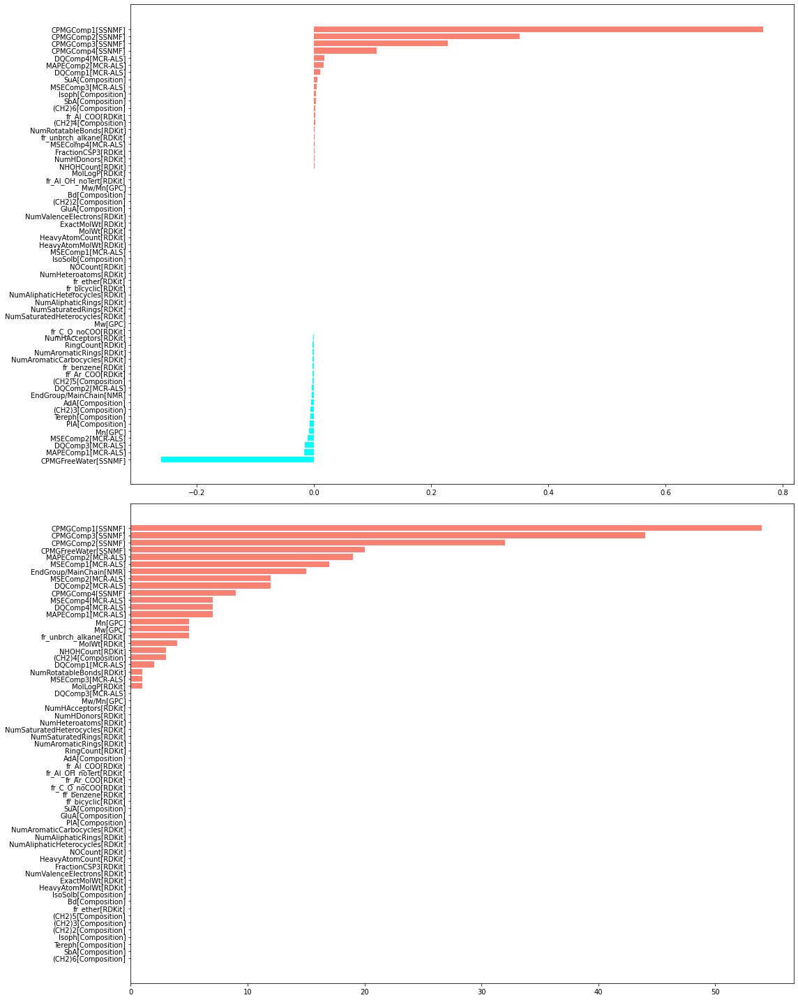

./data/oligomer_RF_20230125pyCPMGFreeWater.csv
oligomer_RF_20230125pyCPMGFreeWater
Linear Model(Ridge) val score: 0.0393 test_score: 0.0494 r2_score: 0.9975
LGB Model val score: 0.2046 test score: 0.2988 r2_score: 0.9320


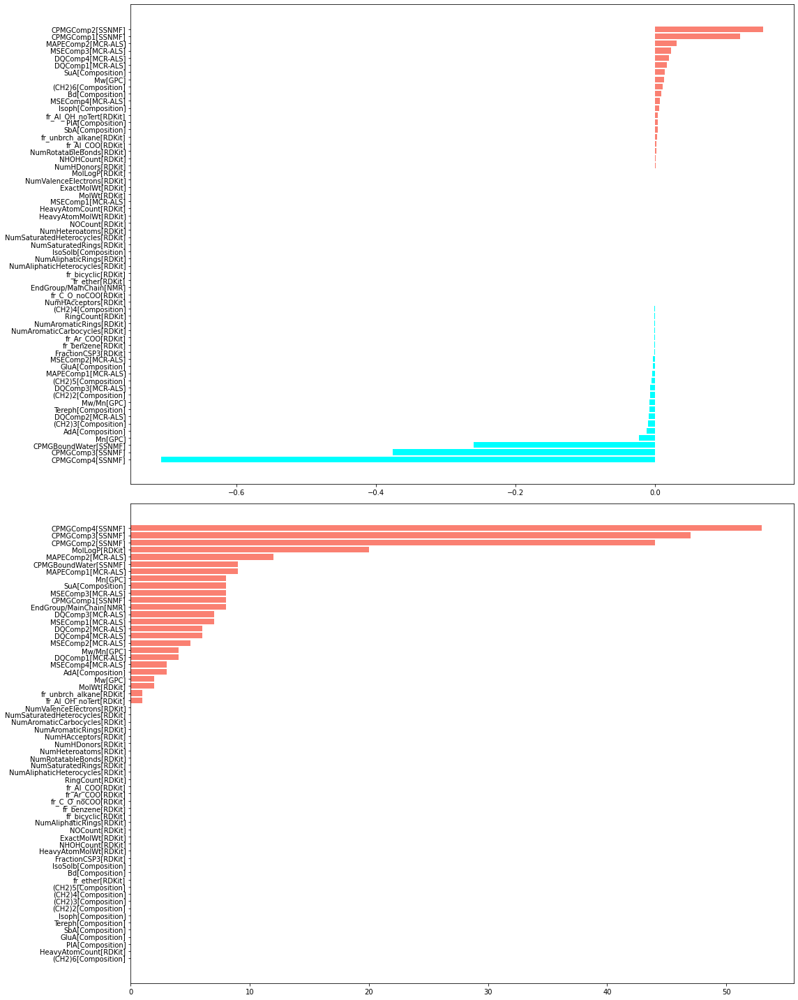

In [ ]:
from sklearn.preprocessing import StandardScaler
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import os
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn import metrics
import scipy.stats
import glob
files = glob.glob("./data/*")
for file in files:
    print(file)
    print(os.path.basename(file).split('.', 1)[0])
    from scipy import stats
    df = pd.read_csv(file, index_col=0)
    df = df.apply(stats.zscore, axis=0)
    df = df.dropna(axis=1)
    # 説明変数と目的変数
    X=df.iloc[:,1:]#data.data
    y=df.iloc[:,0]#data.target
    # データ全体を用いて学習する
    # 訓練用データとテストデータに分ける
    train_X, test_X, train_y, test_y = train_test_split(X, y, test_size=0.1, random_state=6174)

    # 訓練商データを更に訓練用と検証用に分ける
    train_X, val_X, train_y, val_y = train_test_split(train_X, train_y, test_size=0.1, random_state=6174)

    # 線形回帰ではスケーリングが必要
    # GBDTでは大小関係のみ必要なため特に影響はない
    sc = StandardScaler()
    train_X = sc.fit_transform(train_X)
    val_X, test_X = sc.transform(val_X), sc.transform(test_X)

    linear = Ridge()
    lgbmodel = lgb.LGBMRegressor(n_jobs=12, random_state=6174)

    linear.fit(train_X, train_y)
    lgbmodel.fit(train_X, train_y, eval_set=(val_X, val_y), verbose=-1)
    from sklearn.metrics import r2_score
    linear_val_pred = linear.predict(val_X)
    linear_test_pred = linear.predict(test_X)
    linear_val_rmse = mse(val_y, linear_val_pred, squared=False)
    linear_test_rmse = mse(test_y, linear_test_pred, squared=False)
    r2_linear=r2_score(val_y, linear_val_pred)

    lgb_val_pred = lgbmodel.predict(val_X)
    lgb_test_pred = lgbmodel.predict(test_X)
    lgb_val_rmse = mse(val_y, lgb_val_pred, squared=False)
    lgb_test_rmse = mse(test_y, lgb_test_pred, squared=False)
    r2_lgb=r2_score(val_y, lgb_val_pred)
    print(f"Linear Model(Ridge) val score: {linear_val_rmse:.4f} test_score: {linear_test_rmse:.4f} r2_score: {r2_linear:.4f}")
    print(f"LGB Model val score: {lgb_val_rmse:.4f} test score: {lgb_test_rmse:.4f} r2_score: {r2_lgb:.4f}")

    # プロット用に特徴量名格納
    feature = np.array(df.columns[1:])

    # 線形回帰モデルの重み
    linear_coef = linear.coef_

    # lightgbmの特徴量重要度
    lgb_importances = lgbmodel.feature_importances_

    # それぞれをプロットする
    # 重み/特徴量重要度をソート
    linear_idx = np.argsort(linear_coef)
    lgb_idx = np.argsort(lgb_importances)

    f, ax = plt.subplots(nrows=2, ncols=1, figsize=(16, 20))
    ax = ax.flatten()
    color = [('salmon' if i > 0 else 'aqua') for i in linear_coef[linear_idx]]
    ax[0].barh(feature[linear_idx], linear_coef[linear_idx], color=color)
    color = [('salmon' if i > 0 else 'aqua') for i in lgb_importances[lgb_idx]]
    ax[1].barh(feature[lgb_idx], lgb_importances[lgb_idx], color=color)

    plt.tight_layout()
    plt.show()

./data/oligomer_RF_20230126pyTereph.csv
oligomer_RF_20230126pyTereph

Lasso Model............................................

The train score for ls model is 0.6037291600782199
The test score for ls model is -0.19141586427277812
[-5.10830175e-02  0.00000000e+00  0.00000000e+00 -0.00000000e+00
  0.00000000e+00  0.00000000e+00 -1.48537346e-02  0.00000000e+00
 -0.00000000e+00  0.00000000e+00  0.00000000e+00 -0.00000000e+00
 -1.03852550e-01  2.78609716e-01  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -0.00000000e+00 -0.00000000e+00  1.47240119e-01
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -0.00000000e+00  3.49577460e-02  0.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -0.00000000e+00  3.38910112e-01  1.16391526e-15
 -0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
 -0.00000000e+00 -0.00000000e+00  0.00000000e+00  0.00000000e+00
 -0.00000000e+00 -9.69713433e-02  6.90367875e-04 -0.00000000e+00
  1.51815034e-16 -0.00000000e+00 -0.00000000e+00  0.000

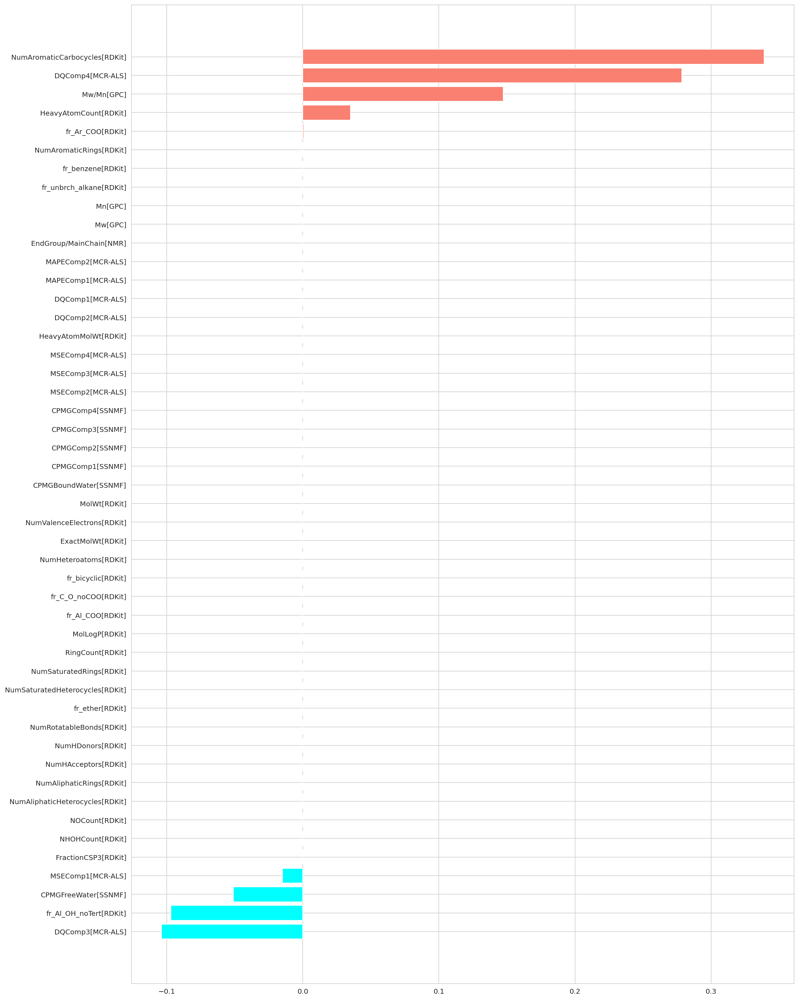

0.0
-0.006743606648653033
./data/oligomer_RF_20230126pyAdA.csv
oligomer_RF_20230126pyAdA

Lasso Model............................................

The train score for ls model is 0.6101470864076874
The test score for ls model is 0.7060108633010842
[-0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -0.00000000e+00
 -0.00000000e+00  8.71290061e-02  3.48425000e-01  0.00000000e+00
 -0.00000000e+00 -0.00000000e+00 -1.40111055e-02 -0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  2.94539522e-01  0.00000000e+00 -3.40376092e-01 -0.00000000e+00
 -0.00000000e+00 -0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -1.99688648e-15 -0.00000000e+00  1.30266654e-01
 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -0.00000000e+00  0.00000000e+00  6.47312225e-02
  0.00000000e+00 -0.00000000e+00 -0.0

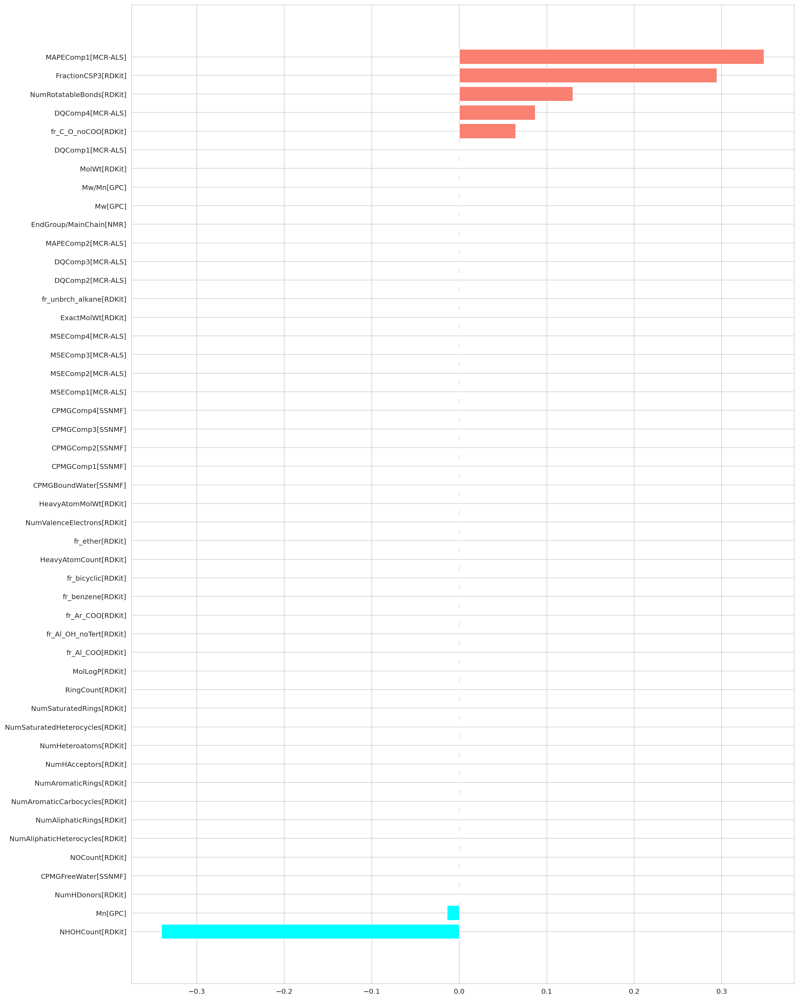

0.0
-0.006743606648653033


In [ ]:
files = glob.glob("./data/*")
for file in files:
    print(file)
    print(os.path.basename(file).split('.', 1)[0])
    from scipy import stats
    df = pd.read_csv(file, index_col=0)
    df = df.apply(stats.zscore, axis=0)
    df = df.dropna(axis=1)
    # 説明変数と目的変数
    X=df.iloc[:,1:]#data.data
    y=df.iloc[:,0]#data.target
    # データ全体を用いて学習する
    # 訓練用データとテストデータに分ける
    train_X, test_X, train_y, test_y = train_test_split(X, y, test_size=0.1, random_state=6174)
    from sklearn.linear_model import Ridge, RidgeCV, Lasso
    #Lasso regression model
    print("\nLasso Model............................................\n")
    lasso = Lasso(alpha = 0.1)
    lasso.fit(train_X,train_y)
    train_score_ls =lasso.score(train_X,train_y)
    test_score_ls =lasso.score(test_X,test_y)

    print("The train score for ls model is {}".format(train_score_ls))
    print("The test score for ls model is {}".format(test_score_ls))
    print(lasso.coef_)
    y_pred = lasso.predict(test_X)
    mse = mean_squared_error(test_y, y_pred)
    print(mse)
    lasso_idx = np.argsort(lasso.coef_)
    #pd.Series(lasso.coef_, feature[lasso_idx]).sort_values(ascending = True).plot(kind = "bar")

    f, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 20))
    color = [('salmon' if i > 0 else 'aqua') for i in lasso.coef_[lasso_idx]]
    ax.barh(feature[lasso_idx], lasso.coef_[lasso_idx], color=color)

    plt.tight_layout()
    plt.show()

    #Using the linear CV model
    from sklearn.linear_model import LassoCV

    #Lasso Cross validation
    lasso_cv = LassoCV(alphas = [0.0001, 0.001,0.01, 0.1, 1, 10], random_state=0).fit(X_train, y_train)

    #score
    print(lasso_cv.score(X_train, y_train))
    print(lasso_cv.score(X_test, y_test))

In [ ]:
#viz_rmodel.view(show_just_path=True)
viz_rmodel.view(orientation="LR")

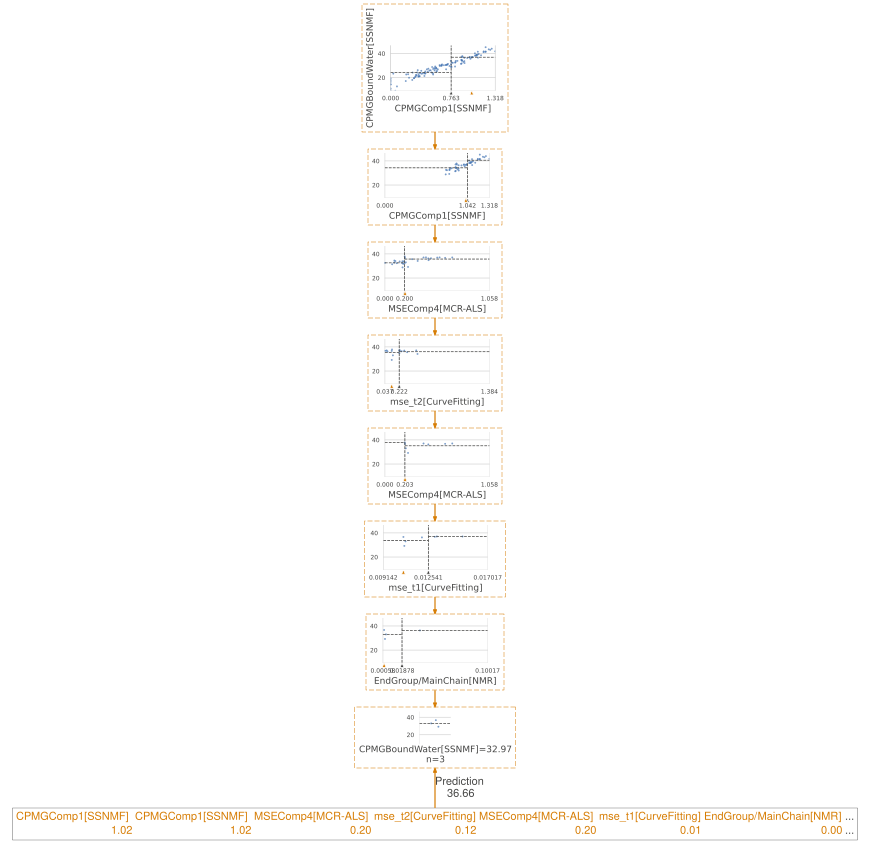

In [ ]:
x = df.iloc[1,1:]#dataset[features_reg].iloc[10]
print(x)
viz_rmodel.view(show_just_path=True, x = x)
y = df.iloc[1,0]#dataset[features_reg].iloc[10]
print(y)

In [ ]:
print(viz_rmodel.explain_prediction_path(x))

0.0 <= CPMGFreeWater[SSNMF] 
0.46 <= CPMGComp1[SSNMF]  < 0.6
0.32 <= CPMGComp3[SSNMF] 
mape_T1[CurveFitting] < 0.6



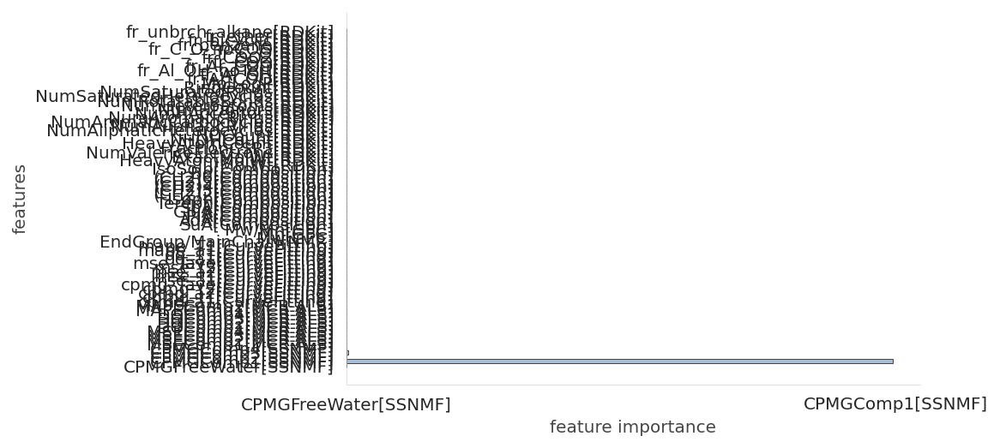

In [ ]:
viz_rmodel.instance_feature_importance(x)#, figsize=(3.5,2))

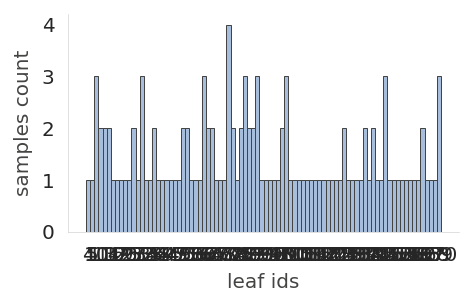

In [ ]:
viz_rmodel.leaf_sizes(figsize=(3.5,2))

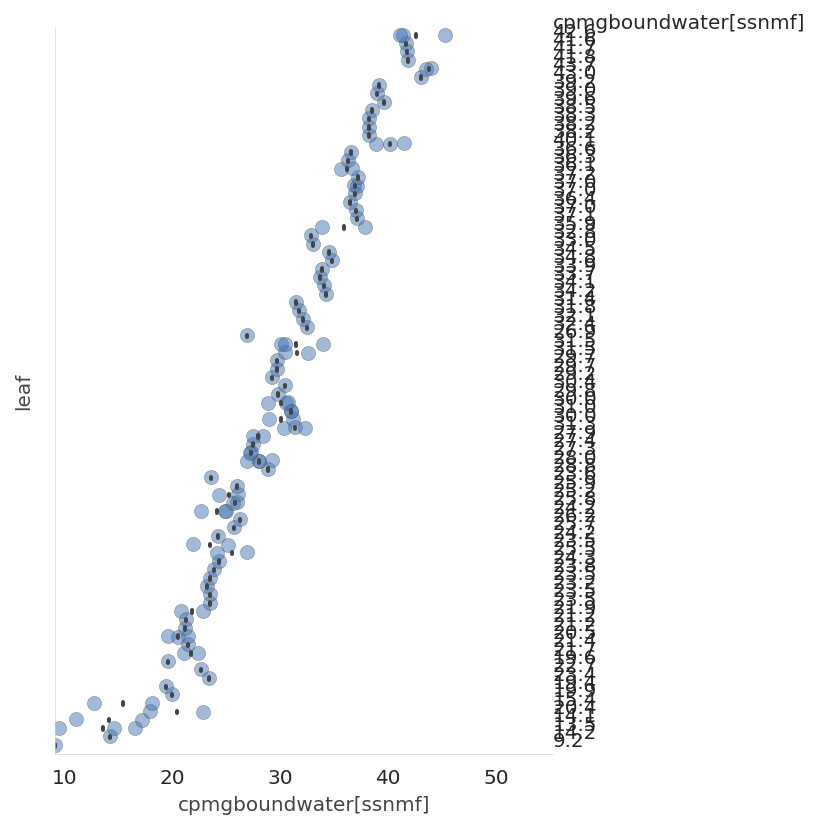

In [ ]:
viz_rmodel.rtree_leaf_distributions()

In [ ]:
viz_rmodel.node_stats(node_id=4)

,CPMGFreeWater[SSNMF],CPMGComp1[SSNMF],CPMGComp2[SSNMF],CPMGComp3[SSNMF],CPMGComp4[SSNMF],MSEComp1[MCR-ALS],MSEComp2[MCR-ALS],MSEComp3[MCR-ALS],MSEComp4[MCR-ALS],DQComp1[MCR-ALS],...,fr_Al_OH_noTert[RDKit],fr_Ar_COO[RDKit],fr_COO[RDKit],fr_COO2[RDKit],fr_C_O[RDKit],fr_C_O_noCOO[RDKit],fr_benzene[RDKit],fr_bicyclic[RDKit],fr_ether[RDKit],fr_unbrch_alkane[RDKit]
count,1.000000,1.000000,1.00000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
mean,0.954401,0.059745,0.43248,0.008763,0.00585,0.637148,0.214224,1.024982,0.037564,0.054567,...,0.5,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,2.5
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,0.954401,0.059745,0.43248,0.008763,0.00585,0.637148,0.214224,1.024982,0.037564,0.054567,...,0.5,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,2.5
25%,0.954401,0.059745,0.43248,0.008763,0.00585,0.637148,0.214224,1.024982,0.037564,0.054567,...,0.5,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,2.5
50%,0.954401,0.059745,0.43248,0.008763,0.00585,0.637148,0.214224,1.024982,0.037564,0.054567,...,0.5,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,2.5
75%,0.954401,0.059745,0.43248,0.008763,0.00585,0.637148,0.214224,1.024982,0.037564,0.054567,...,0.5,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,2.5
max,0.954401,0.059745,0.43248,0.008763,0.00585,0.637148,0.214224,1.024982,0.037564,0.054567,...,0.5,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,2.5


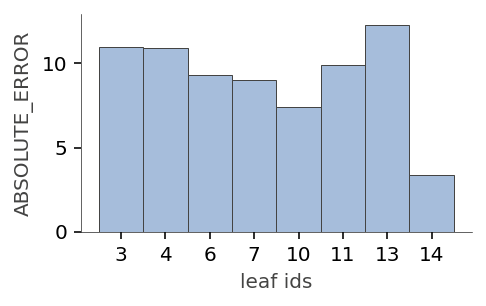

In [ ]:
viz_rmodel.leaf_purity(figsize=(3.5,2))

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import os
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics

sns.set_style('whitegrid',{'linestyle.grid':'--'})
%matplotlib inline

./corr/oligomer_RF_20230107pyDQComp3.csv
oligomer_RF_20230107pyDQComp3
1.0
0.8797108288405262
before
                          x         y
0      CPMGFreeWater[SSNMF]  0.003189
1     CPMGBoundWater[SSNMF]  0.000070
2          CPMGComp1[SSNMF]  0.000000
3          CPMGComp2[SSNMF]  0.000019
4          CPMGComp3[SSNMF]  0.000087
..                      ...       ...
74      fr_C_O_noCOO[RDKit]  0.000000
75        fr_benzene[RDKit]  0.000000
76       fr_bicyclic[RDKit]  0.000000
77          fr_ether[RDKit]  0.000000
78  fr_unbrch_alkane[RDKit]  0.000187

[79 rows x 2 columns]
after
                             x             y
0         CPMGFreeWater[SSNMF]  3.188613e-03
1        CPMGBoundWater[SSNMF]  6.958180e-05
3             CPMGComp2[SSNMF]  1.867649e-05
4             CPMGComp3[SSNMF]  8.712966e-05
5             CPMGComp4[SSNMF]  5.939345e-04
6            MSEComp1[MCR-ALS]  4.454422e-04
8            MSEComp3[MCR-ALS]  1.686681e-04
11            DQComp2[MCR-ALS]  1.327516e-02
12       

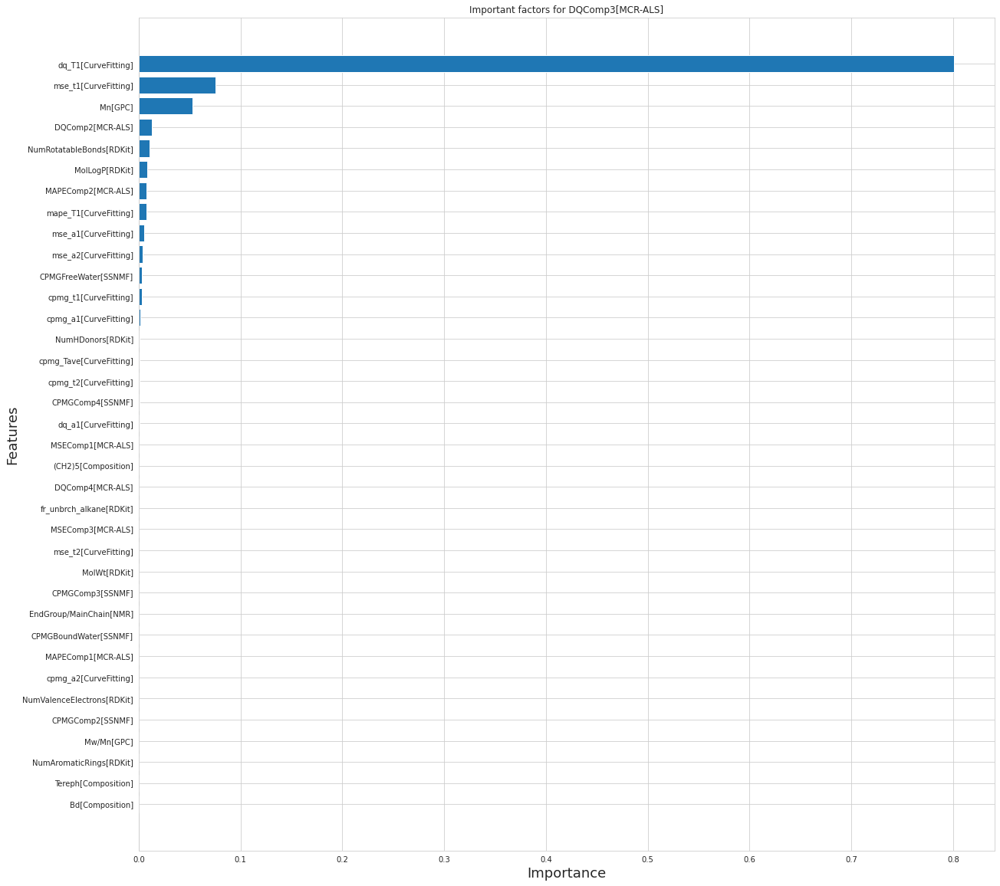

./corr/oligomer_RF_20230107pyMSEComp1.csv
oligomer_RF_20230107pyMSEComp1
1.0
0.615079581647618
before
                          x         y
0      CPMGFreeWater[SSNMF]  0.000094
1     CPMGBoundWater[SSNMF]  0.002340
2          CPMGComp1[SSNMF]  0.007580
3          CPMGComp2[SSNMF]  0.001750
4          CPMGComp3[SSNMF]  0.000057
..                      ...       ...
74      fr_C_O_noCOO[RDKit]  0.000000
75        fr_benzene[RDKit]  0.013891
76       fr_bicyclic[RDKit]  0.000000
77          fr_ether[RDKit]  0.000000
78  fr_unbrch_alkane[RDKit]  0.000000

[79 rows x 2 columns]
after
                           x         y
0       CPMGFreeWater[SSNMF]  0.000094
1      CPMGBoundWater[SSNMF]  0.002340
2           CPMGComp1[SSNMF]  0.007580
3           CPMGComp2[SSNMF]  0.001750
4           CPMGComp3[SSNMF]  0.000057
5           CPMGComp4[SSNMF]  0.000260
6          MSEComp2[MCR-ALS]  0.150963
7          MSEComp3[MCR-ALS]  0.128218
9           DQComp1[MCR-ALS]  0.000916
10          DQComp2[MCR

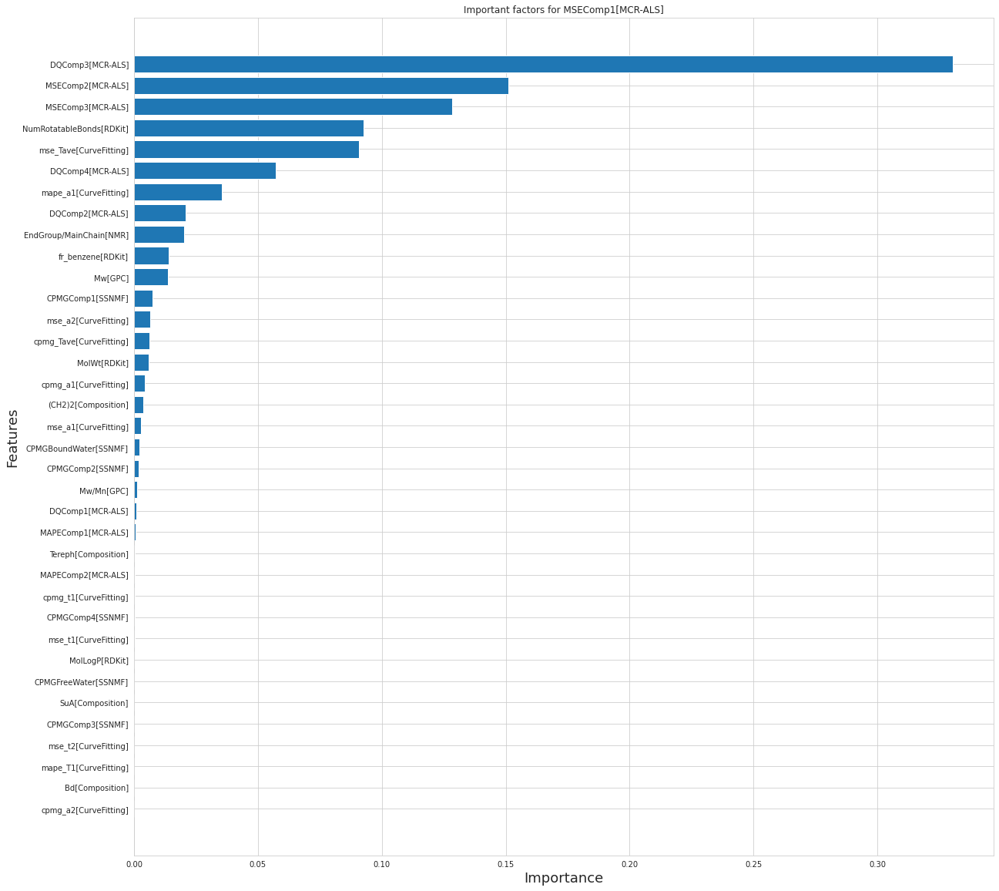

./corr/oligomer_RF_20230107pyMSEComp4.csv
oligomer_RF_20230107pyMSEComp4
1.0
0.41029845434781376
before
                          x         y
0      CPMGFreeWater[SSNMF]  0.000133
1     CPMGBoundWater[SSNMF]  0.000100
2          CPMGComp1[SSNMF]  0.000000
3          CPMGComp2[SSNMF]  0.000102
4          CPMGComp3[SSNMF]  0.024247
..                      ...       ...
74      fr_C_O_noCOO[RDKit]  0.000000
75        fr_benzene[RDKit]  0.000162
76       fr_bicyclic[RDKit]  0.000000
77          fr_ether[RDKit]  0.000000
78  fr_unbrch_alkane[RDKit]  0.000000

[79 rows x 2 columns]
after
                           x             y
0       CPMGFreeWater[SSNMF]  1.331682e-04
1      CPMGBoundWater[SSNMF]  1.001390e-04
3           CPMGComp2[SSNMF]  1.017440e-04
4           CPMGComp3[SSNMF]  2.424678e-02
5           CPMGComp4[SSNMF]  6.217156e-04
6          MSEComp1[MCR-ALS]  1.814603e-02
7          MSEComp2[MCR-ALS]  8.201746e-05
8          MSEComp3[MCR-ALS]  2.676678e-06
9           DQComp1[MCR-

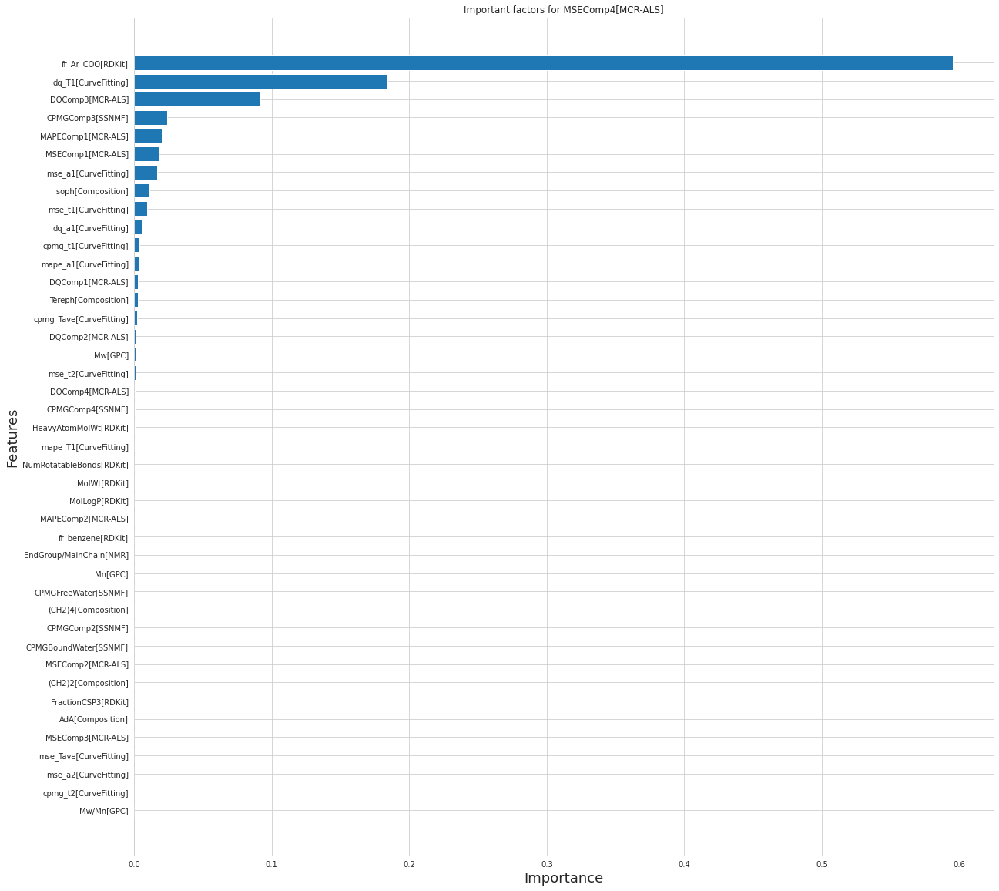

./corr/oligomer_RF_20230107pyMAPEComp1.csv
oligomer_RF_20230107pyMAPEComp1
1.0
0.8979926545124902
before
                          x             y
0      CPMGFreeWater[SSNMF]  6.231618e-05
1     CPMGBoundWater[SSNMF]  8.919700e-04
2          CPMGComp1[SSNMF]  1.441775e-04
3          CPMGComp2[SSNMF]  2.968842e-04
4          CPMGComp3[SSNMF]  1.932902e-03
..                      ...           ...
74      fr_C_O_noCOO[RDKit]  0.000000e+00
75        fr_benzene[RDKit]  2.655019e-09
76       fr_bicyclic[RDKit]  0.000000e+00
77          fr_ether[RDKit]  0.000000e+00
78  fr_unbrch_alkane[RDKit]  6.527939e-04

[79 rows x 2 columns]
after
                           x             y
0       CPMGFreeWater[SSNMF]  6.231618e-05
1      CPMGBoundWater[SSNMF]  8.919700e-04
2           CPMGComp1[SSNMF]  1.441775e-04
3           CPMGComp2[SSNMF]  2.968842e-04
4           CPMGComp3[SSNMF]  1.932902e-03
5           CPMGComp4[SSNMF]  5.594363e-05
6          MSEComp1[MCR-ALS]  3.421237e-03
10          DQComp

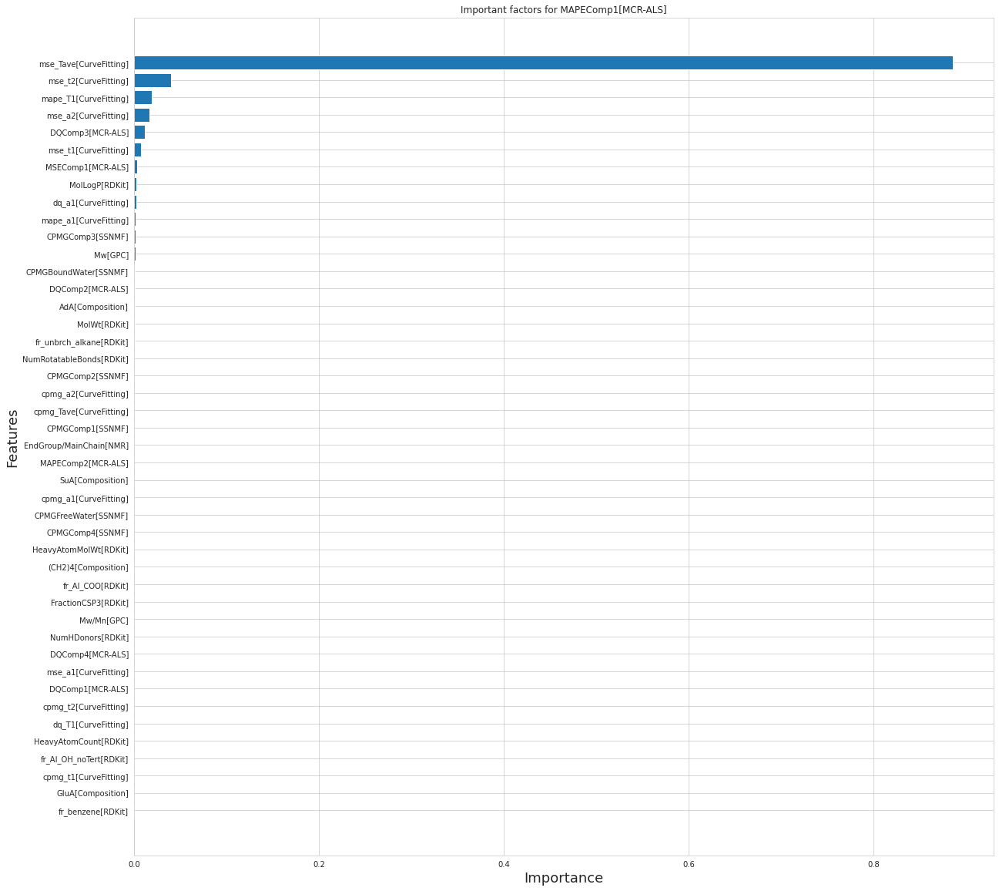

./corr/oligomer_RF_20230107pyDQComp1.csv
oligomer_RF_20230107pyDQComp1
1.0
0.9273157867672647
before
                          x         y
0      CPMGFreeWater[SSNMF]  0.000003
1     CPMGBoundWater[SSNMF]  0.000208
2          CPMGComp1[SSNMF]  0.003955
3          CPMGComp2[SSNMF]  0.000176
4          CPMGComp3[SSNMF]  0.000012
..                      ...       ...
74      fr_C_O_noCOO[RDKit]  0.000000
75        fr_benzene[RDKit]  0.000163
76       fr_bicyclic[RDKit]  0.000000
77          fr_ether[RDKit]  0.000000
78  fr_unbrch_alkane[RDKit]  0.000000

[79 rows x 2 columns]
after
                                x             y
0            CPMGFreeWater[SSNMF]  2.752254e-06
1           CPMGBoundWater[SSNMF]  2.082915e-04
2                CPMGComp1[SSNMF]  3.954750e-03
3                CPMGComp2[SSNMF]  1.760302e-04
4                CPMGComp3[SSNMF]  1.243498e-05
5                CPMGComp4[SSNMF]  1.187870e-03
6               MSEComp1[MCR-ALS]  2.035633e-03
7               MSEComp2[MCR-A

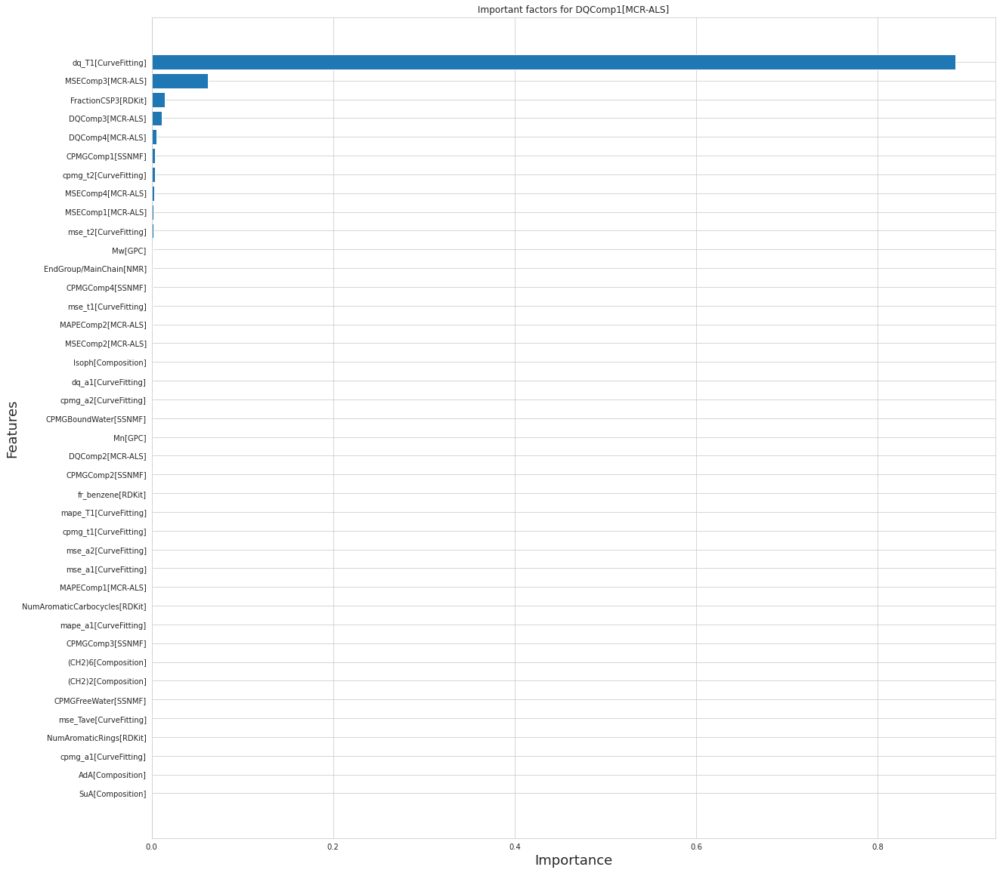

./corr/oligomer_RF_20230107pyMAPEComp2.csv
oligomer_RF_20230107pyMAPEComp2
1.0
0.29859757559369704
before
                          x         y
0      CPMGFreeWater[SSNMF]  0.000000
1     CPMGBoundWater[SSNMF]  0.001691
2          CPMGComp1[SSNMF]  0.002274
3          CPMGComp2[SSNMF]  0.001201
4          CPMGComp3[SSNMF]  0.012136
..                      ...       ...
74      fr_C_O_noCOO[RDKit]  0.000000
75        fr_benzene[RDKit]  0.000000
76       fr_bicyclic[RDKit]  0.000000
77          fr_ether[RDKit]  0.000000
78  fr_unbrch_alkane[RDKit]  0.000000

[79 rows x 2 columns]
after
                          x             y
1     CPMGBoundWater[SSNMF]  1.690990e-03
2          CPMGComp1[SSNMF]  2.274069e-03
3          CPMGComp2[SSNMF]  1.200659e-03
4          CPMGComp3[SSNMF]  1.213564e-02
5          CPMGComp4[SSNMF]  1.387588e-04
6         MSEComp1[MCR-ALS]  2.630231e-04
7         MSEComp2[MCR-ALS]  5.767999e-04
8         MSEComp3[MCR-ALS]  7.260077e-02
10         DQComp1[MCR-ALS]  3.

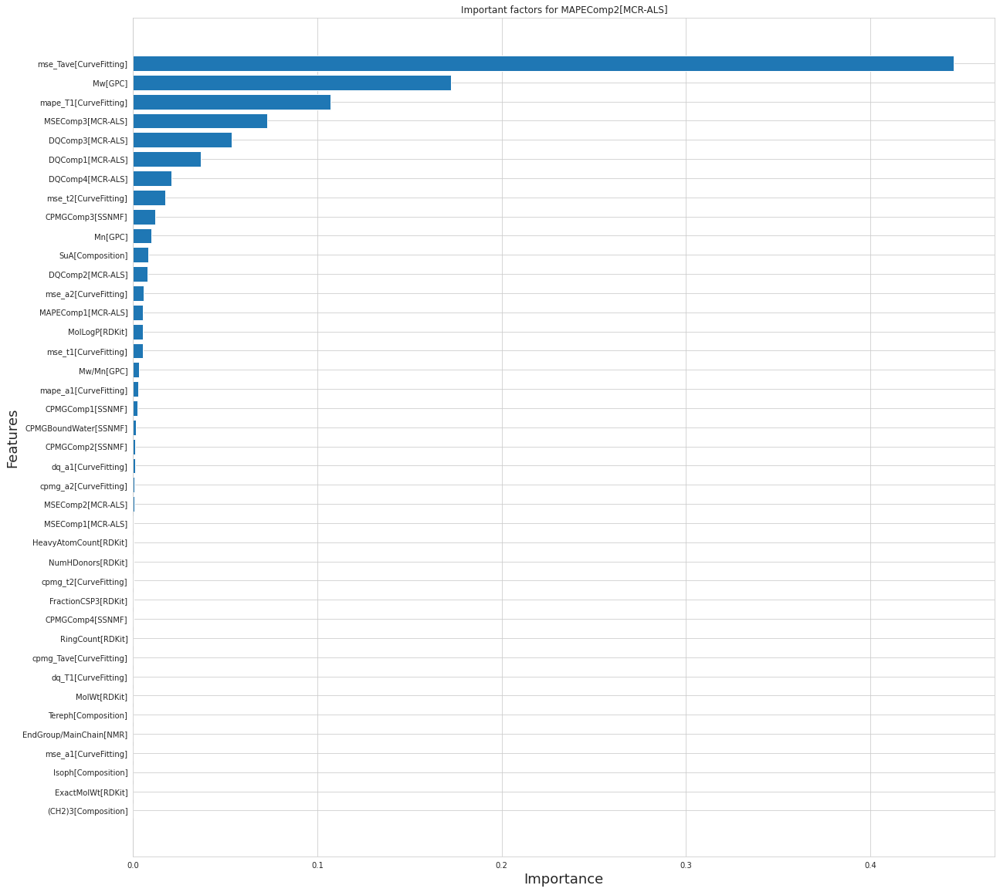

./corr/oligomer_RF_20230107pyMSEComp2.csv
oligomer_RF_20230107pyMSEComp2
1.0
0.8814806206640754
before
                          x         y
0      CPMGFreeWater[SSNMF]  0.000893
1     CPMGBoundWater[SSNMF]  0.001737
2          CPMGComp1[SSNMF]  0.000185
3          CPMGComp2[SSNMF]  0.001318
4          CPMGComp3[SSNMF]  0.005256
..                      ...       ...
74      fr_C_O_noCOO[RDKit]  0.000002
75        fr_benzene[RDKit]  0.000000
76       fr_bicyclic[RDKit]  0.000000
77          fr_ether[RDKit]  0.000000
78  fr_unbrch_alkane[RDKit]  0.000000

[79 rows x 2 columns]
after
                           x             y
0       CPMGFreeWater[SSNMF]  8.929475e-04
1      CPMGBoundWater[SSNMF]  1.737332e-03
2           CPMGComp1[SSNMF]  1.850020e-04
3           CPMGComp2[SSNMF]  1.317850e-03
4           CPMGComp3[SSNMF]  5.255830e-03
6          MSEComp1[MCR-ALS]  2.439154e-02
7          MSEComp3[MCR-ALS]  1.461490e-03
8          MSEComp4[MCR-ALS]  7.056074e-04
9           DQComp1[MCR-A

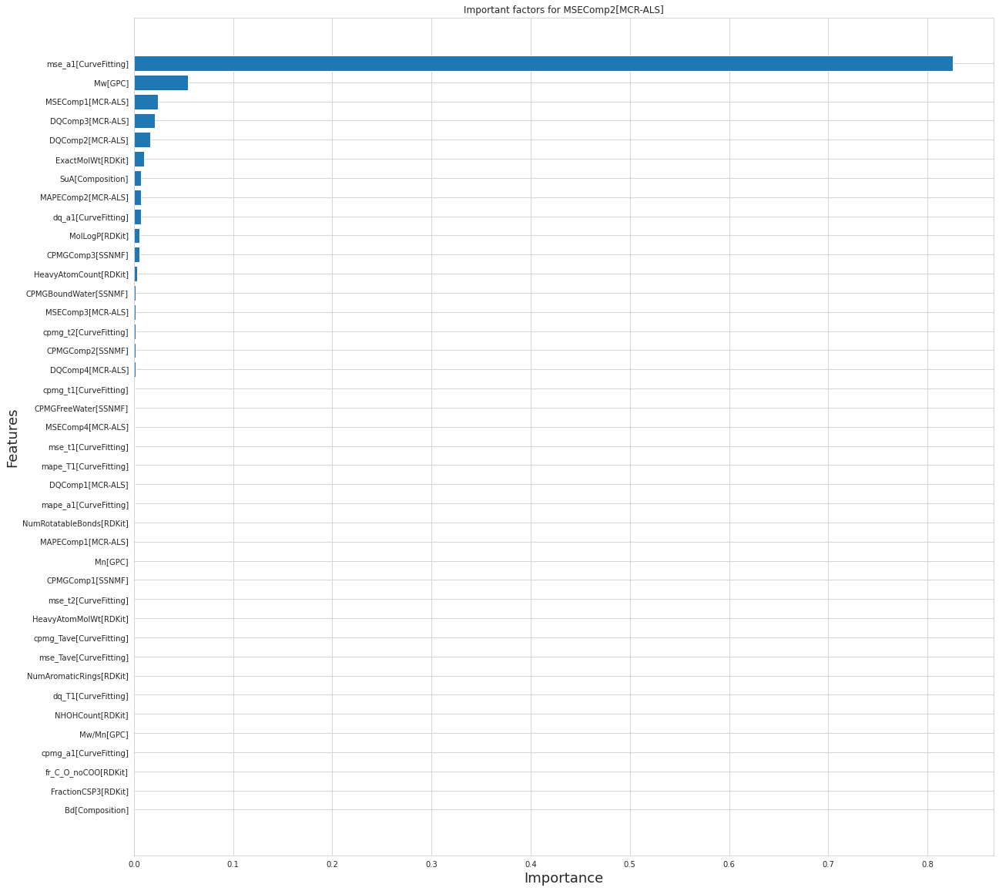

./corr/oligomer_RF_20230107pyMSEComp3.csv
oligomer_RF_20230107pyMSEComp3
1.0
0.7354964077060181
before
                          x             y
0      CPMGFreeWater[SSNMF]  5.865177e-07
1     CPMGBoundWater[SSNMF]  3.360462e-03
2          CPMGComp1[SSNMF]  1.131243e-03
3          CPMGComp2[SSNMF]  1.741795e-05
4          CPMGComp3[SSNMF]  2.454858e-03
..                      ...           ...
74      fr_C_O_noCOO[RDKit]  0.000000e+00
75        fr_benzene[RDKit]  0.000000e+00
76       fr_bicyclic[RDKit]  0.000000e+00
77          fr_ether[RDKit]  0.000000e+00
78  fr_unbrch_alkane[RDKit]  1.241532e-03

[79 rows x 2 columns]
after
                          x             y
0      CPMGFreeWater[SSNMF]  5.865177e-07
1     CPMGBoundWater[SSNMF]  3.360462e-03
2          CPMGComp1[SSNMF]  1.131243e-03
3          CPMGComp2[SSNMF]  1.741795e-05
4          CPMGComp3[SSNMF]  2.454858e-03
5          CPMGComp4[SSNMF]  6.505766e-05
6         MSEComp1[MCR-ALS]  3.853419e-02
7         MSEComp2[MCR-ALS] 

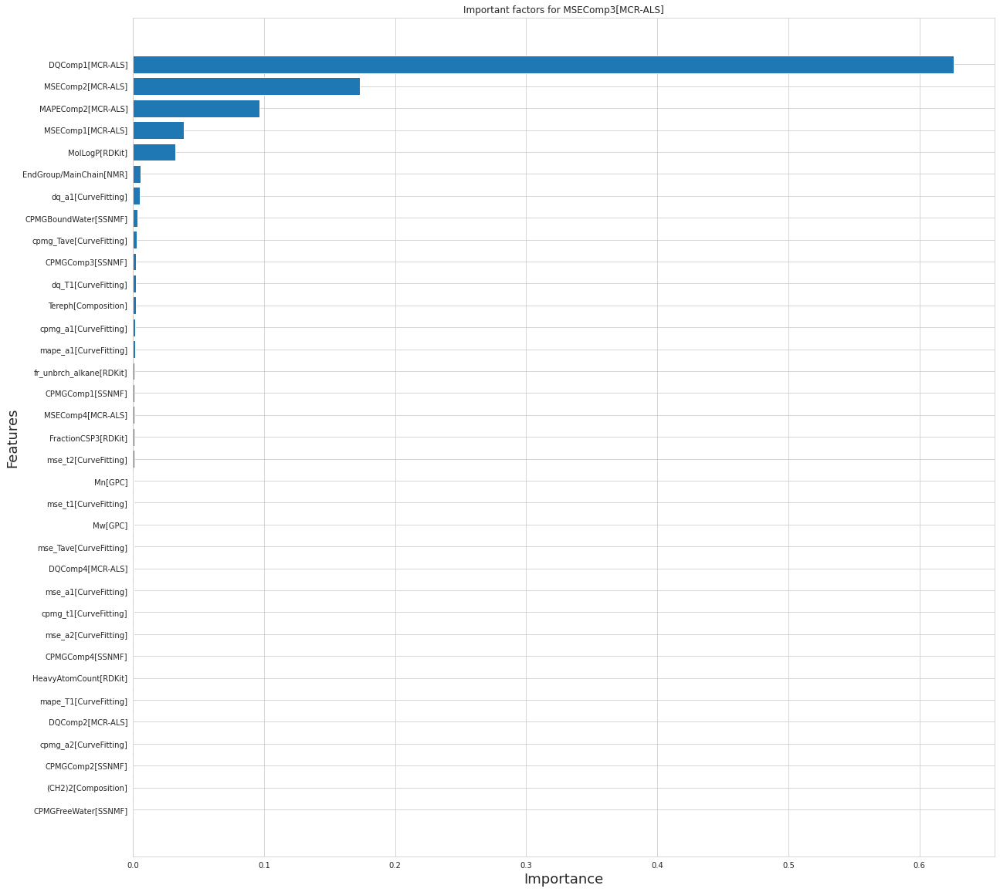

./corr/oligomer_RF_20230107pyDQComp4.csv
oligomer_RF_20230107pyDQComp4
1.0
0.4549623754068616
before
                          x         y
0      CPMGFreeWater[SSNMF]  0.001365
1     CPMGBoundWater[SSNMF]  0.000186
2          CPMGComp1[SSNMF]  0.000653
3          CPMGComp2[SSNMF]  0.000492
4          CPMGComp3[SSNMF]  0.000060
..                      ...       ...
74      fr_C_O_noCOO[RDKit]  0.000000
75        fr_benzene[RDKit]  0.000000
76       fr_bicyclic[RDKit]  0.000000
77          fr_ether[RDKit]  0.000000
78  fr_unbrch_alkane[RDKit]  0.000702

[79 rows x 2 columns]
after
                           x             y
0       CPMGFreeWater[SSNMF]  1.364815e-03
1      CPMGBoundWater[SSNMF]  1.861284e-04
2           CPMGComp1[SSNMF]  6.534832e-04
3           CPMGComp2[SSNMF]  4.918980e-04
4           CPMGComp3[SSNMF]  6.001440e-05
5           CPMGComp4[SSNMF]  2.960547e-03
6          MSEComp1[MCR-ALS]  4.961667e-02
7          MSEComp2[MCR-ALS]  1.447292e-03
8          MSEComp3[MCR-ALS

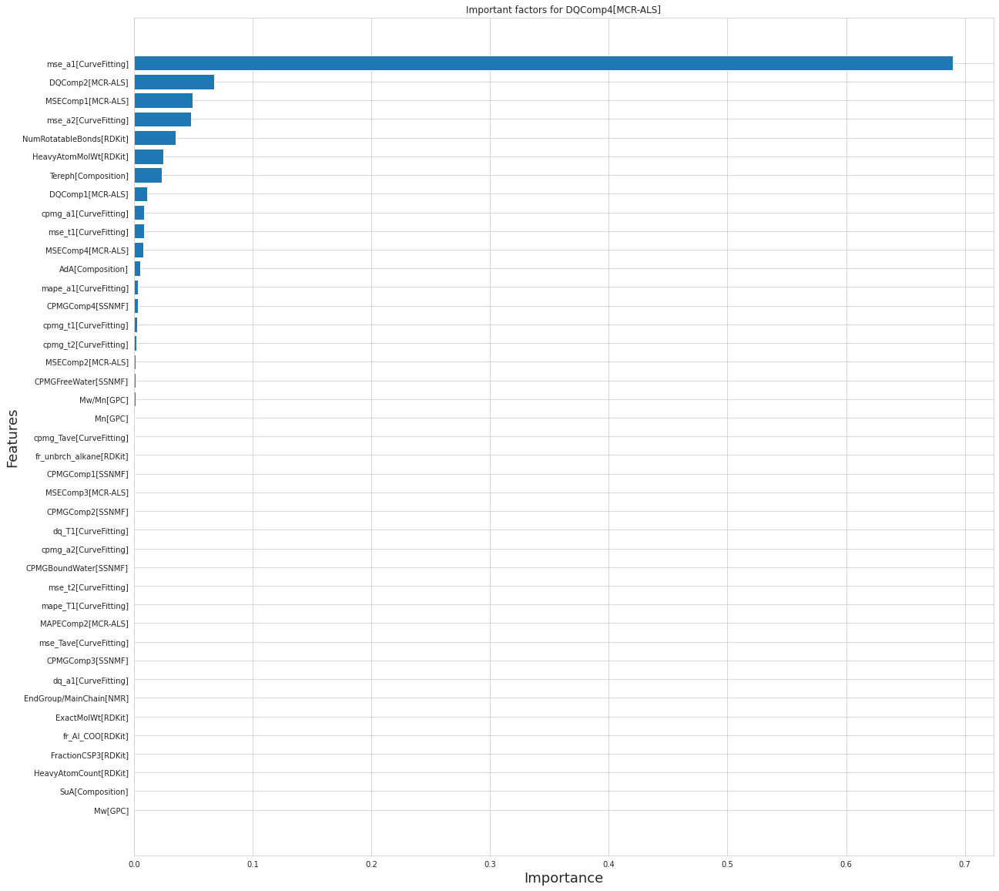

./corr/oligomer_RF_20230107pyDQComp2.csv
oligomer_RF_20230107pyDQComp2
1.0
-2.7663919055852095
before
                          x         y
0      CPMGFreeWater[SSNMF]  0.004510
1     CPMGBoundWater[SSNMF]  0.001317
2          CPMGComp1[SSNMF]  0.020373
3          CPMGComp2[SSNMF]  0.000064
4          CPMGComp3[SSNMF]  0.016244
..                      ...       ...
74      fr_C_O_noCOO[RDKit]  0.000000
75        fr_benzene[RDKit]  0.000000
76       fr_bicyclic[RDKit]  0.000000
77          fr_ether[RDKit]  0.000000
78  fr_unbrch_alkane[RDKit]  0.000000

[79 rows x 2 columns]
after
                             x             y
0         CPMGFreeWater[SSNMF]  4.509507e-03
1        CPMGBoundWater[SSNMF]  1.317063e-03
2             CPMGComp1[SSNMF]  2.037290e-02
3             CPMGComp2[SSNMF]  6.438929e-05
4             CPMGComp3[SSNMF]  1.624382e-02
5             CPMGComp4[SSNMF]  1.439378e-03
6            MSEComp1[MCR-ALS]  1.035486e-02
7            MSEComp2[MCR-ALS]  4.729687e-08
8       

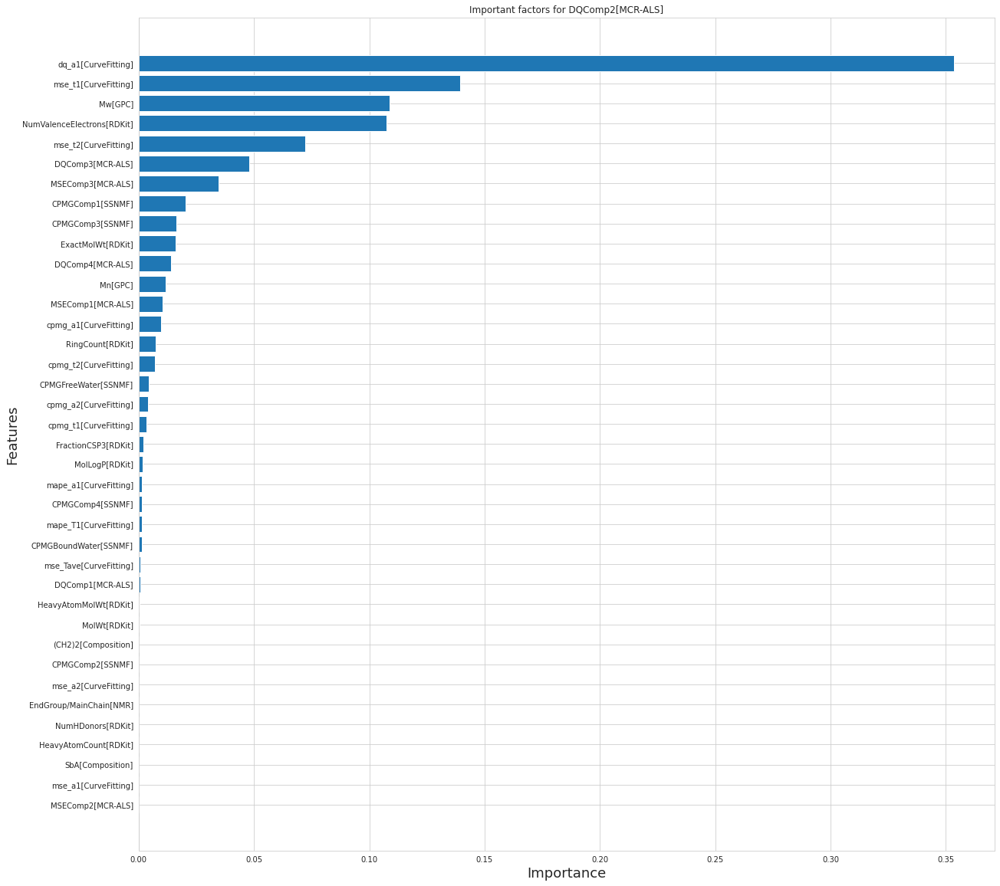

In [ ]:
import glob
files = glob.glob("./data/*")
for file in files:
    print(file)
    print(os.path.basename(file).split('.', 1)[0])
    from scipy import stats
    df = pd.read_csv(file, index_col=0)
    #df = df.apply(stats.zscore, axis=1)
    df
    # 説明変数と目的変数
    X=df.iloc[:,1:]#data.data
    y=df.iloc[:,0]#data.target

    # 訓練データ(train)と検証データ(test)にわける 
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.3,random_state=1)

    # モデルの作成
    #clf = DecisionTreeClassifier(max_depth=3) 
    from sklearn.tree import DecisionTreeRegressor
    clf = DecisionTreeRegressor(random_state=0) 
    # モデルの学習
    clf.fit(X_train, y_train)


    # 評価
    print(clf.score(X_train,y_train))
    print(clf.score(X_test,y_test))

    import numpy as np
    import matplotlib.pyplot as plt

    def plot_sorted_bar(figsize: tuple, x: np.array, y: np.array, title: str = None) -> None:
        """
        入力値を降順ソートして棒グラフを作成するメソッド。

        Parameters
        ----------
        figsize : tuple
            figsizeのtuple。
        x : np.numpy
            横軸(ラベル)。
        y : np.numpy
            縦軸(数値)。
        title : str
            グラフタイトル文字列。

        """
        # yを昇順ソート後、逆順にindexを取得
        sorted_index = np.argsort(y)[:]
        # 棒グラフの可視化
        plt.figure(figsize=figsize)
        plt.barh(
            #ラベルが数値だと自動ソートされるため、x軸は文字列型にしておく
            x[sorted_index].astype('str'),
            np.sort(y)[:]
        )
        plt.ylabel('Features',fontsize=18)
        plt.xlabel('Importance',fontsize=18)
        if title is not None:
            plt.title(title)
        plt.savefig("Importance_"+os.path.basename(file).split('.', 1)[0]+".png")

    x = df.columns[1:] #特徴量名 ->['sepal length (cm)','sepal width (cm)','petal length (cm)','petal width (cm)']
    y = clf.feature_importances_ #特徴量の重要度
    df0 = pd.DataFrame({'x':x,'y':y})
    def remove_any_zero_row(df):
        """一つでも0の行を削除"""
        df = df.copy()
        for row in df.index:
            if (df.loc[row] == 0).any():
                df.drop(row, axis=0, inplace=True)
        return df
    print('before')
    print(df0)

    df0 = remove_any_zero_row(df0)

    print('after')
    print(df0)

    # 可視化
    plot_sorted_bar(
        figsize=(20, 20),
        x=df0["x"].values, 
        y=df0["y"].values,
        title='Important factors for '+df.columns[0]
    )

    plt.show()
    import graphviz
    from sklearn.tree import export_graphviz

    dot = export_graphviz(clf, filled=True, rounded=True, 
                          #class_names=['setosa', 'versicolor', 'virginica'],
                          feature_names=df.columns[1:],
                          out_file=None) 

    graph = graphviz.Source(dot) #DOT記法をレンダリング
    #graph #グラフを出力
    # 画像を保存
    # 拡張子はいらない
    graph.render("Tree_"+os.path.basename(file).split('.', 1)[0])

    # 画像を表示
    graph.view()